# Predicting Game Outcomes in the NFL

Our group has chosen to analyze a set of data centered around National Football League (NFL) games that includes betting and weather data. We are interested in seeing if we can produce a model untilizing this betting information and weather data to determine if we can predict, with some accuracy, the outcomes of said games. Our data comes from a [kaggle site](https://www.kaggle.com/tobycrabtree/nfl-scores-and-betting-data) that centers around utilizing the data in a similar fashion. We are also looking at encorporating a data set from the popular political and sports journalism site, FiveThirtyEight. This data set is structured very similar and contains even more games (dating back to 1920, whereas the kaggle data set goes back to 1966). It provides us an ELO score, which is meant to help produce probabilities a particular team will win a particular game. That data and an explanation of ELO can be found on their [github](https://github.com/fivethirtyeight/nfl-elo-game).

For this milestone, we have chosen to do our multivariate analysis on the kaggle and the FiveThirtyEight datasets.

## Table of Contents

- [Loading and Cleaning the Data](#load)
    - [Selecting Timeframe](#timeframe)
    - [Dealing With Nulls](#nulls)
    - [Cleaning and Joining the Data](#clean)
- [Multivariate Analysis/Visualizations](#vis)
    - [Correlation Matrix](#cormat)
    - [Scatterplots of higher correlated variables](#highcorr)
    - [Scatterplots of moderate/low correlated variables](#lowcorr)
    - [Super Bowl Era Visualizations (1970-present)](#super)
    - [Modern Era NFL Visualizations (2002-present)](#modern)
- [Initial Conclusions](#conclusions)

### Loading & Summarizing the Data <a name="load"></a>

The initial data should be available in the /GroupProducts/ folder and there should be four files:

- spreadspoke_scores.csv
- nfl_stadiums.csv
- nfl_teams.csv
- nfl_games_with_elo.csv

The spreadspoke_scores file will have our betting and weather data, while nfl_stadiums contains information about the location of each stadium in the spreadspoke_scores and the nfl_teams file contains information on each team.

The nfl_games_with_elo file has ELO scores for both the home and the away teams as well as the game outcomes from the 1920 NFL season through the 2018 NFL season.

We're going to combine all the datasets into one to perform our multivariate analysis.

### Selecting Timeframe <a name="timeframe"></a>
The kaggle data contains records of games and outcomes from between 1966 to last season (2018). The games then should run from about August/September of 1966 to roughly February of 2019, when the last superbowl was played.

In the NFL and especially in sports reporting, it is common to compare statistics for players and teams across eras. The NFL as we know it today was originally split into multiple leagues. The two most prominent of these were the AFL and the former NFL. These two major leagues merged in 1969, created two conferences within the NFL called the American Football Conference (AFC) and the National Footabll Conference (NFC). This is also when the superbowl came to be. Anything after the 1969 season (so 1970 season and onwards) is termed "the Superbowl Era." 

Additionally, there have been several teams who have joined the league in the superbowl era. As such the league, and number of games played, as grown and changed. The last time a team joined the league was prior to the 2002 season and as such between 2002 and the present is known as "the Modern era."

In order for us to build a well trained model, we've decided to limit our data to just the Superbowl Era. This will allow us to look at teams and games that are the most similar. As such, we'll limit our betting_df to records with a schedule_season of 1970 or greater.

### Dealing with Nulls <a name="nulls"></a>

It looks like we have some nulls in both our betting/weather data as well as our stadiums data. In this notebook, we'll remove those records with nulls for now. As we move forward with our analysis, we'll look into imputing them. Possible points of discussion for our future calls:

- It looks like every record in the stadiums data has an address, could we encorporate some geospatial data in order to populate the LATITUDE, LONGTITUDE, and ELEVATION using these addresses?
- The spread and over under line are both built using betting information for that game, would it be wise to try and impute these?
- Weather information may be extractable using the weather code of the stadium and it looks like the kaggle site has NFL weather data, would it be worthwhile to get that info for the 303 games in the Super Bowl Era that we're missing it from?

### Cleaning & Joing the Data <a name="clean"></a>

In [2]:
## Useful libraries for bivariate analysis

library(ggplot2)
#library(gridExtra, quietly = TRUE) # uncomment in order to use gridExtra library. install.packages("gridExtra")
library(lubridate, quietly = TRUE)
library(tidyr)
library(reshape2, quietly = TRUE)
library(dplyr)
#library(ggthemes)

In [3]:
## Read in data sets

nfl_games_df <- read.csv("../Data/spreadspoke_scores.csv", as.is = TRUE, header = TRUE)
nfl_elo_df <- read.csv("../Data/nfl_games_with_elo.csv", as.is = TRUE, header = TRUE)
nfl_teams_df <- read.csv("../Data/nfl_teams.csv", as.is = TRUE, header = TRUE)
nfl_stadiums_df <- read.csv("../Data/nfl_stadiums.csv", as.is = TRUE, header = TRUE)

In [4]:
## Same data carpentry as univariate analysis

## Update date columns to date data type
nfl_games_df$schedule_date <- as.Date(parse_date_time(nfl_games_df$schedule_date, "mdy"))
nfl_elo_df$date <- as.Date(parse_date_time(nfl_elo_df$date, "ymd"))

## Join nfl_game_df and nfl_teams_df data frames
nfl_df <- dplyr::left_join(nfl_games_df, nfl_teams_df, by = c("team_home" = "team_name"))
nfl_df <- dplyr::left_join(nfl_df, nfl_teams_df, by = c("team_away" = "team_name"))

## Update columns names
names(nfl_df)[names(nfl_df) == 'team_id.x'] <- 'home_team_id'
names(nfl_df)[names(nfl_df) == 'team_id.y'] <- 'away_team_id'
names(nfl_df)[names(nfl_df) == 'team_conference.x'] <- 'home_team_conference'
names(nfl_df)[names(nfl_df) == 'team_division.x'] <- 'home_team_division'
names(nfl_df)[names(nfl_df) == 'team_conference.y'] <- 'away_team_conference'
names(nfl_df)[names(nfl_df) == 'team_division.y'] <- 'away_team_division'
names(nfl_df)[names(nfl_df) == 'team_home'] <- 'home_team'
names(nfl_df)[names(nfl_df) == 'score_home'] <- 'home_score'
names(nfl_df)[names(nfl_df) == 'score_away'] <- 'away_score'
names(nfl_df)[names(nfl_df) == 'team_away'] <- 'away_team'

## Join nfl_df, nfl_elo_df, and nfl_stadiums_df data frames
nfl_df <- dplyr::left_join(nfl_df, nfl_elo_df, by = c("schedule_date" = "date", "home_team_id" = "team1", "away_team_id" = "team2"))
nfl_df <- dplyr::left_join(nfl_df, nfl_stadiums_df, by = c("stadium" = "stadium_name"))

## Reorder nfl_df and drop unnecessary columns
nfl_df <- nfl_df[c(1,2,3,34,5,19,21,22,6,7,8,26,28,29,9,10,11,14,15,16,17,35,36,37,40,12,33,41,42,43,44,46,47,49,50,51,52,53,54)]

## Subset nfl_df to include only games in the modern era (1970 - Present)
nfl_df <- nfl_df[which(nfl_df$schedule_season >= 1970),]

## Update humidity column to an integer so we can perform data analysis
nfl_df$weather_humidity <- as.integer(nfl_df$weather_humidity)

## Create total_points column to compare over/under line with the actual total number of points scored within the game
nfl_df$total_points <- nfl_df$home_score + nfl_df$away_score

## Create team_winner_id to compare favorite_id with the actual winner of the game
nfl_df$team_winner_id <- ifelse(nfl_df$home_score > nfl_df$away_score, nfl_df$home_team_id, nfl_df$away_team_id)

## Subset by numeric columns only
numeric_nfl_df <- nfl_df[c(9,10,16,17,18,19,20,22,23,24,37,38,39,40)]
numeric_nfl_df <- numeric_nfl_df %>% drop_na()

Warning message in eval(expr, envir, enclos):
“NAs introduced by coercion”

## Multivariate Analysis/Visualizations <a name="vis"></a>

To start visualizing our multivariate data, we'll build a few scatterplots and bar plots as well as a correlation matrix.

### Correlation Matrix <a name="cormat"></a>

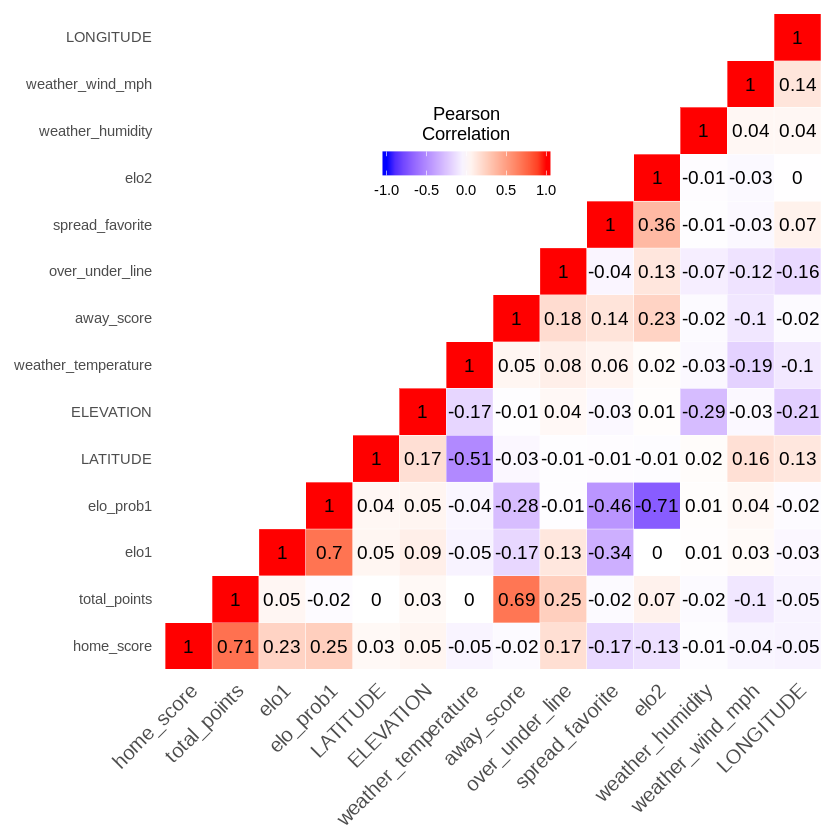

In [5]:
## Correlation matrix of the numeric_nfl_df

cormat <- cor(numeric_nfl_df)
melted_cormat <- melt(cormat)

reorder_cormat <- function(cormat){
# Use correlation between variables as distance
dd <- as.dist((1-cormat)/2)
hc <- hclust(dd)
cormat <-cormat[hc$order, hc$order]
}

# Get lower triangle of the correlation matrix
get_lower_tri<-function(cormat){
    cormat[upper.tri(cormat)] <- NA
    return(cormat)
  }
  # Get upper triangle of the correlation matrix
get_upper_tri <- function(cormat){
    cormat[lower.tri(cormat)]<- NA
    return(cormat)
  }

# Reorder the correlation matrix
cormat <- reorder_cormat(cormat)
upper_tri <- get_upper_tri(cormat)
# Melt the correlation matrix
melted_cormat <- melt(upper_tri, na.rm = TRUE)
# Create a ggheatmap
ggheatmap <- ggplot(melted_cormat, aes(Var2, Var1, fill = value))+
 geom_tile(color = "white")+
 scale_fill_gradient2(low = "blue", high = "red", mid = "white", 
   midpoint = 0, limit = c(-1,1), space = "Lab", 
    name="Pearson\nCorrelation") +
  theme_minimal()+ # minimal theme
 theme(axis.text.x = element_text(angle = 45, vjust = 1, 
    size = 12, hjust = 1))+
 coord_fixed()

ggheatmap + 
geom_text(aes(Var2, Var1, label = round(value, 2)), color = "black", size = 4) +
theme(
  axis.title.x = element_blank(),
  axis.title.y = element_blank(),
  panel.grid.major = element_blank(),
  panel.border = element_blank(),
  panel.background = element_blank(),
  axis.ticks = element_blank(),
  legend.justification = c(1, 0),
  legend.position = c(0.6, 0.7),
  legend.direction = "horizontal")+
  guides(fill = guide_colorbar(barwidth = 7, barheight = 1,
                title.position = "top", title.hjust = 0.5))

In [6]:
## Variables with correlation between 0.1 and 1
## total_points/home_score, elo_prob1/elo1, and total_points/away_score are all highly correlated (0.69 or higher) with 
## each other which makes sense.  The more points either team scores the higher total points for the game.
## Same with elo1 and elo_prob1.  The higher the elo1 score the higher the probability the home team will win which is what the
## elo_prob1 variable represents.
## Expanding to include correlations above 0.1 to see the other variables that are slightly to moderately correlated with
## one another.  They may help our eventual model.

mc <- subset(melted_cormat, value > 0.1 & value < 1, select = c('Var1', 'Var2', 'value'))
mc <- mc[order(-mc$value),]
mc

,Var1,Var2,value
15,home_score,total_points,0.7093881
45,elo1,elo_prob1,0.6996205
100,total_points,away_score,0.6901770
150,spread_favorite,elo2,0.3632257
43,home_score,elo_prob1,0.2526559
114,total_points,over_under_line,0.2526418
29,home_score,elo1,0.2309242
148,away_score,elo2,0.2292835
120,away_score,over_under_line,0.1833452
113,home_score,over_under_line,0.1704771


### Scatterplots of higher correlated variables <a name="highcorr"></a>

### Highly correlated variables (home_score/total_points, elo1/elo_prob1, and away_score/total_points) in relation to stadium surface and temperature, wind speed, and humidity

Warning message:
“Removed 150 rows containing missing values (geom_point).”Warning message:
“Removed 150 rows containing missing values (geom_point).”

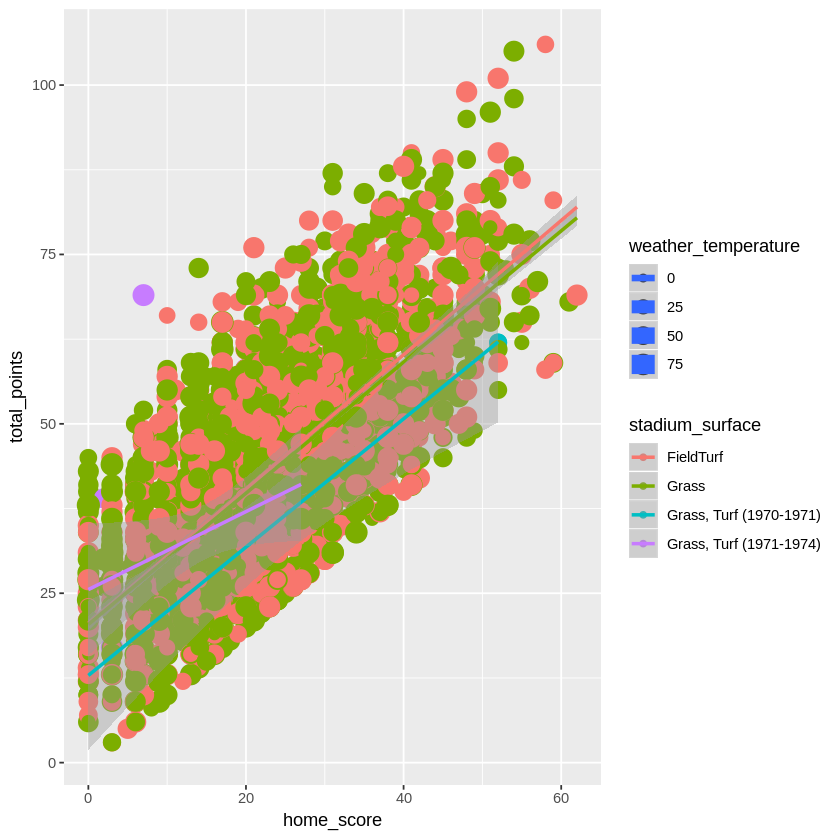

Warning message:
“Removed 2272 rows containing missing values (geom_point).”

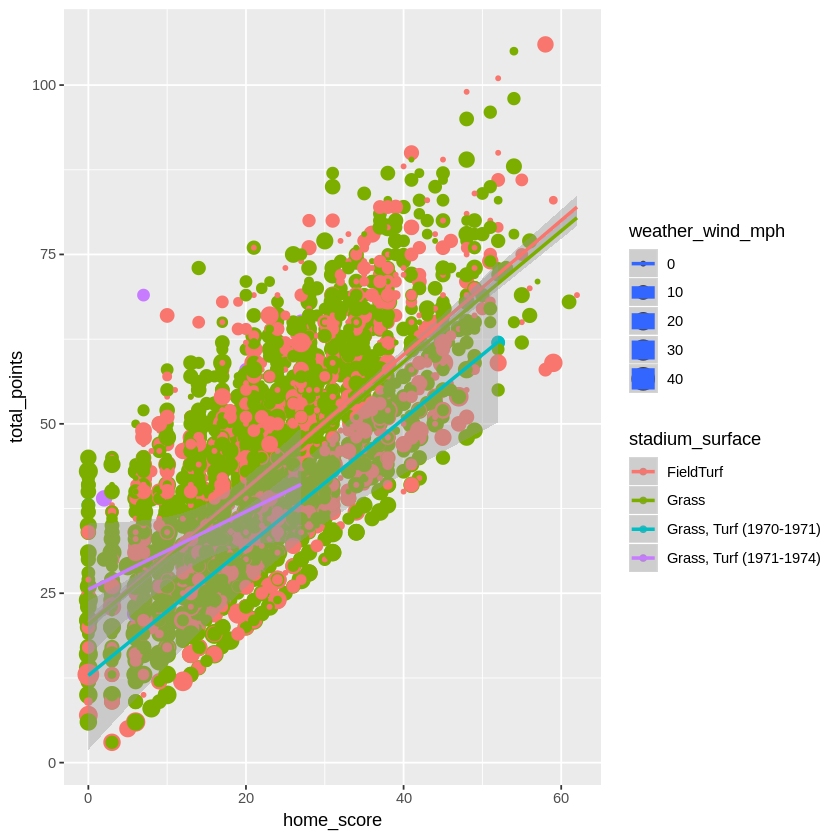

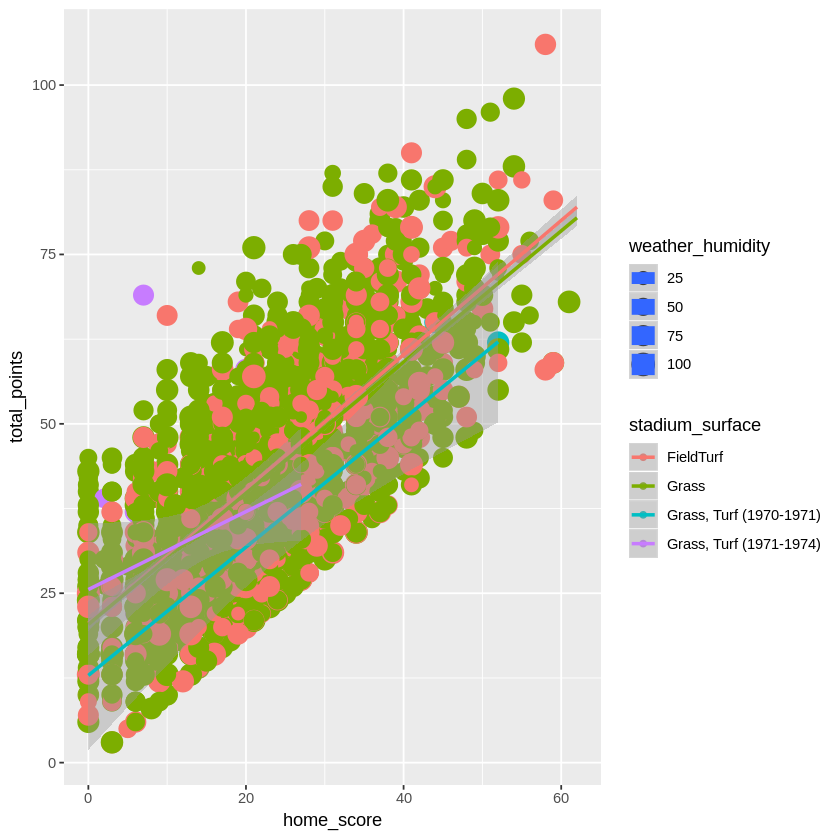

In [7]:
## Scatterplot of home_score, total_points, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature and humidity don't seem to have much affect on home_score or total_points but we can clearly see
## lower wind speeds at higher home_scores and total_points across all stadium_surfaces

stadium_surface <- nfl_df[which(nfl_df$stadium_surface == "FieldTurf" | nfl_df$stadium_surface == "Grass" | 
                                nfl_df$stadium_surface == "Grass, Turf (1970-1971)" | 
                                nfl_df$stadium_surface == "Grass, Turf (1971-1974)"),]

ggplot(stadium_surface, aes(x=home_score,y=total_points, color = stadium_surface, size = weather_temperature)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=home_score,y=total_points, color = stadium_surface, size = weather_wind_mph)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=home_score,y=total_points, color = stadium_surface, size = weather_humidity)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”

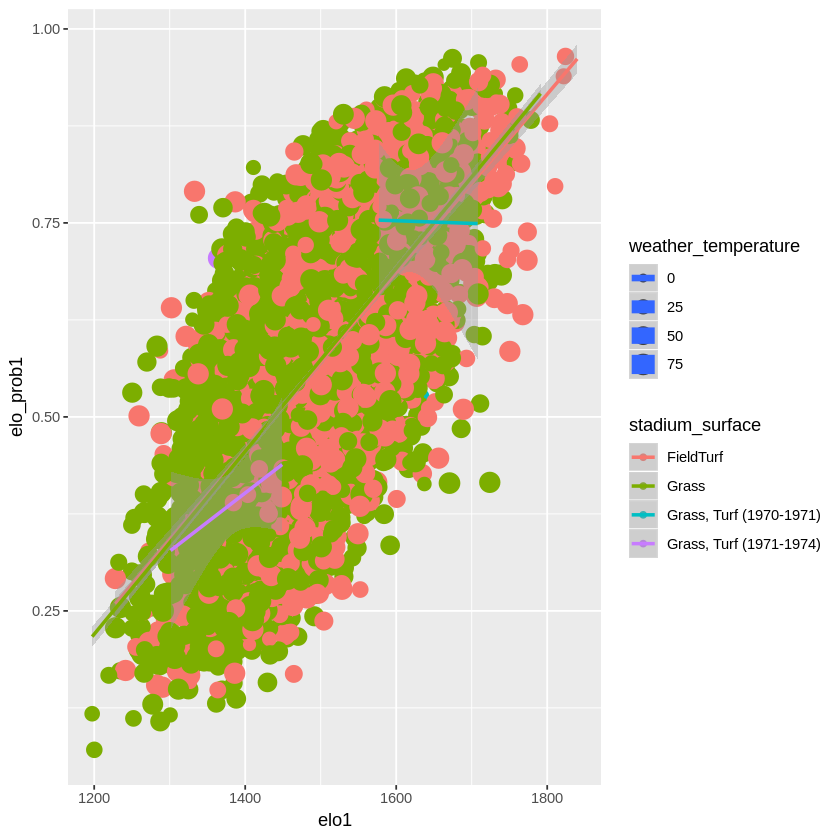

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2377 rows containing missing values (geom_point).”

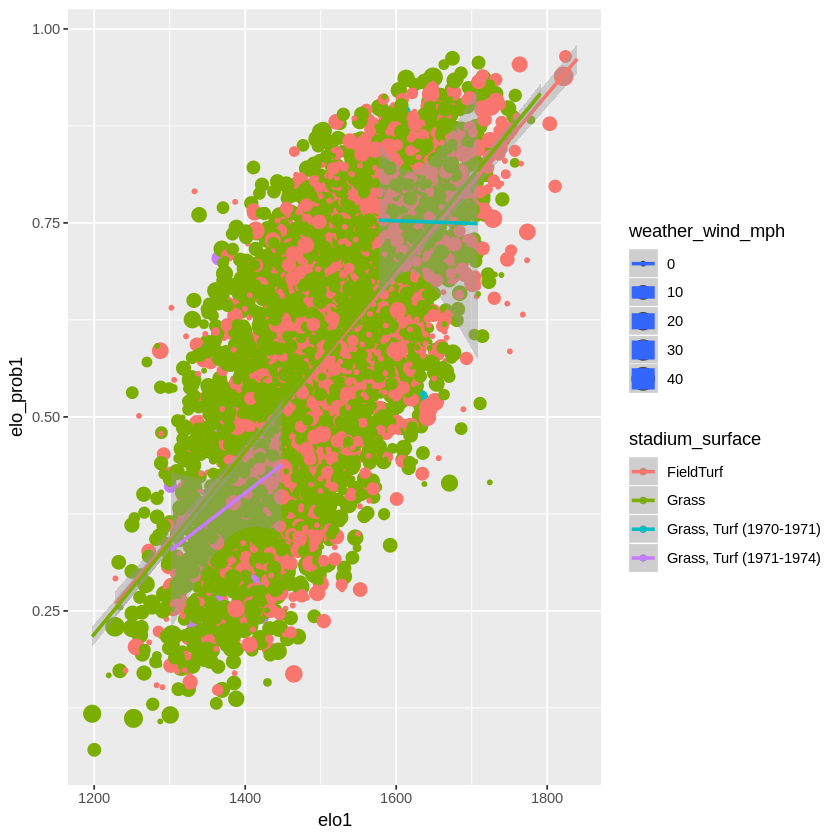

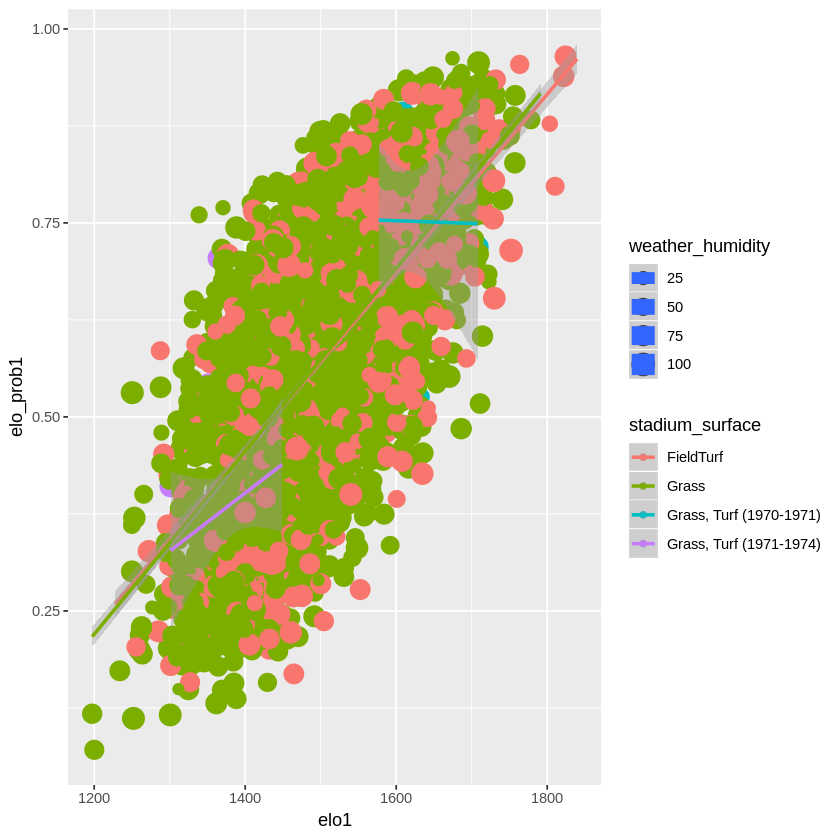

In [8]:
## Scatterplot of elo1, elo_prob1, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature, wind speed and humidity don't seem to have much affect on elo1 or elo_prob1 across all stadium surfaces.
## We can clearly see lower/higher temperatures, wind speeds and humidity at both the higher and lower ends of elo1 & elo_prob1

ggplot(stadium_surface, aes(x=elo1,y=elo_prob1, color = stadium_surface, size = weather_temperature)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=elo_prob1, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=elo_prob1, color = stadium_surface, size = weather_humidity)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 150 rows containing missing values (geom_point).”Warning message:
“Removed 150 rows containing missing values (geom_point).”

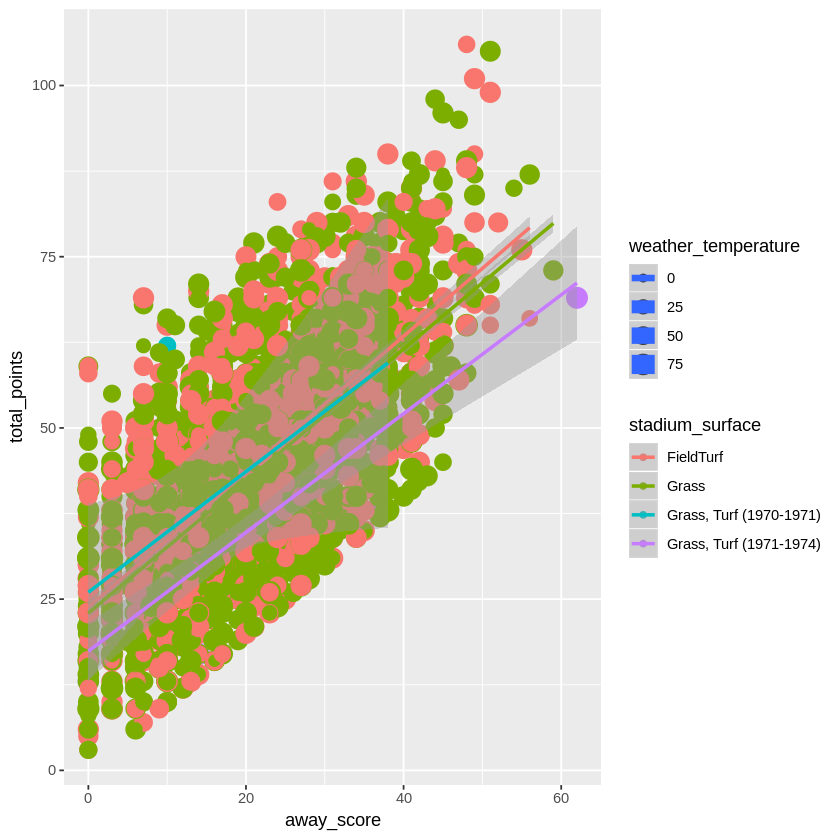

Warning message:
“Removed 2272 rows containing missing values (geom_point).”

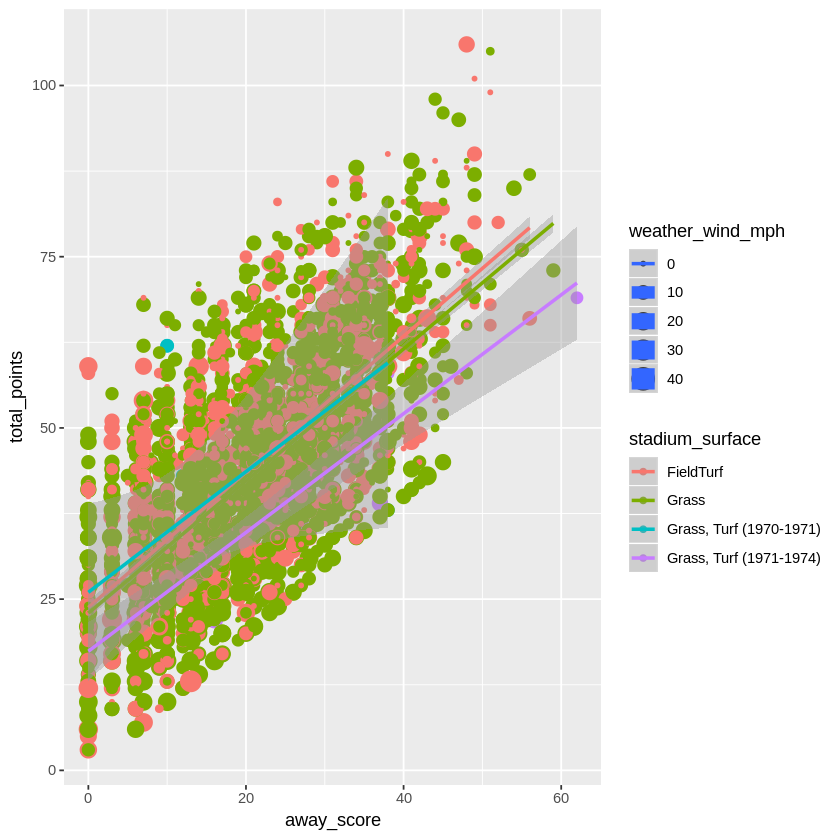

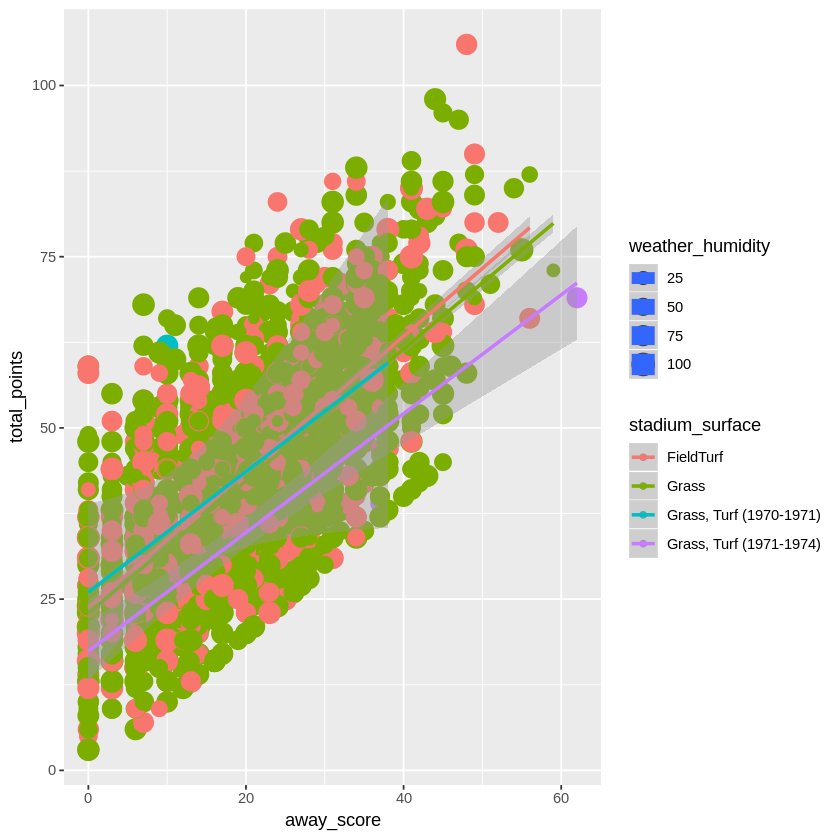

In [9]:
## Scatterplot of away_score, total_points, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature and humidity don't seem to have much affect on away_score or total_points but we can clearly see
## lower wind speeds at higher away_scores and total_points across all stadium_surfaces

ggplot(stadium_surface, aes(x=away_score,y=total_points, color = stadium_surface, size = weather_temperature)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=away_score,y=total_points, color = stadium_surface, size = weather_wind_mph)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=away_score,y=total_points, color = stadium_surface, size = weather_humidity)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

### Highly correlated variables (home_score/total_points, elo1/elo_prob1, and away_score/total_points) in relation to stadium_type and temperature, wind speed, and humidity

Warning message:
“Removed 292 rows containing missing values (geom_point).”Warning message:
“Removed 292 rows containing missing values (geom_point).”

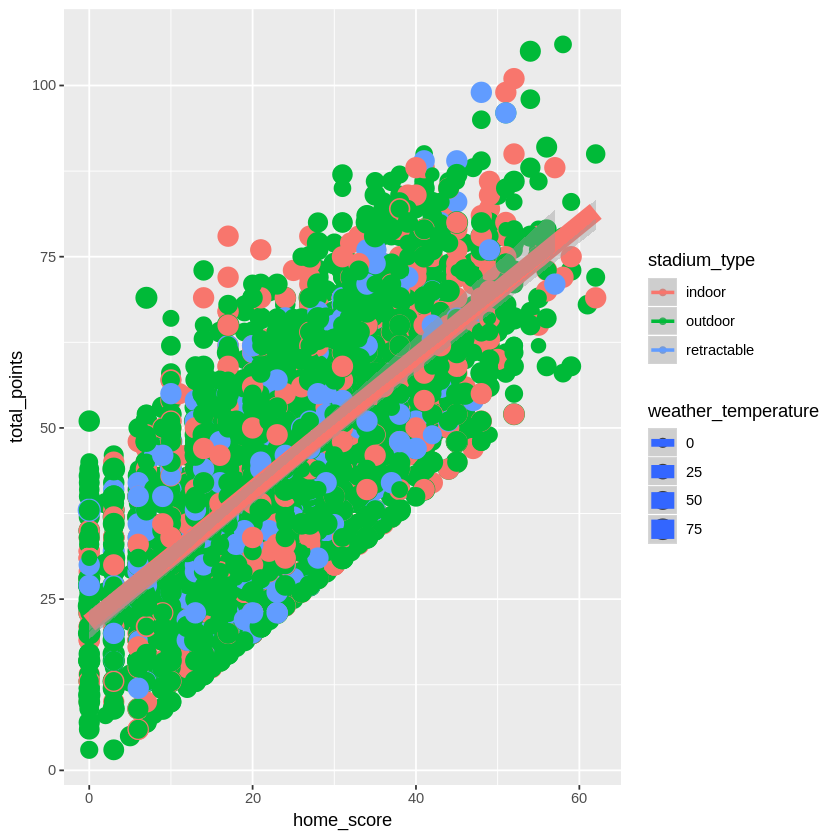

Warning message:
“Removed 3712 rows containing missing values (geom_point).”

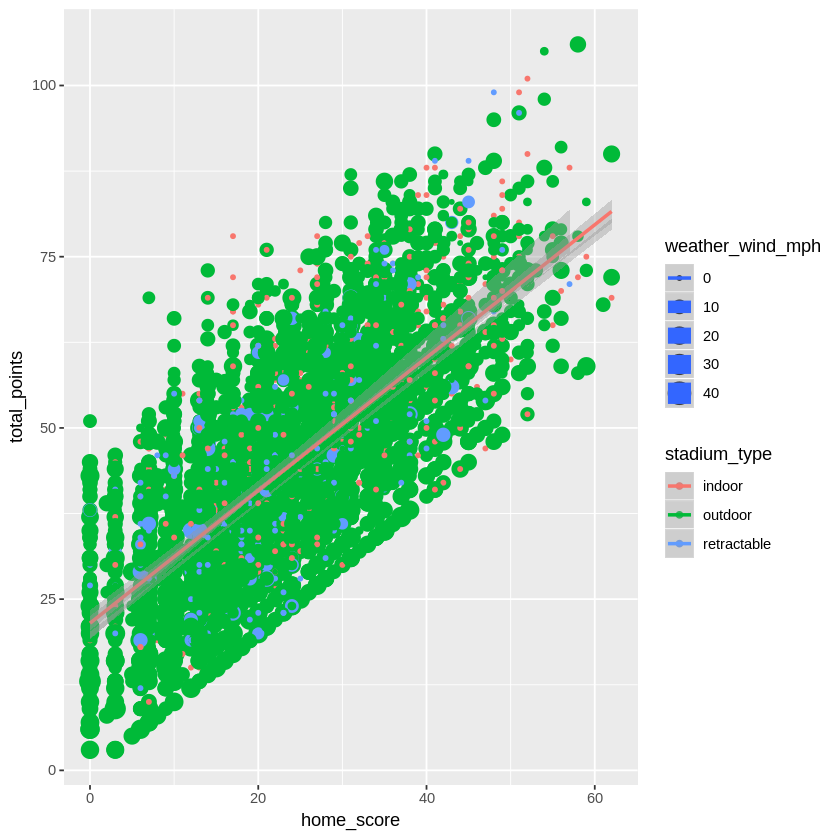

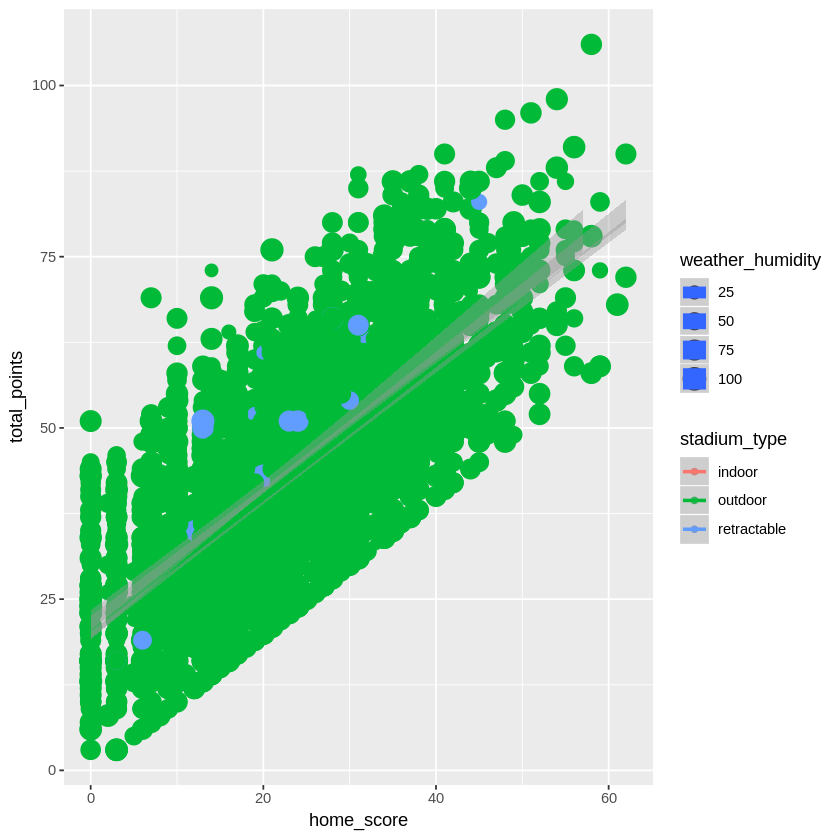

In [10]:
## Scatterplot of home_score, total_points, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Clearly most games are played outdoors as opposed to indoors(dome) or retractable roof (recent development).
## Again, temperature and humidity don't seem to have much affect on home_score or total_points but we can clearly see
## lower wind speeds at higher away_scores and total_points across all stadium_types

stadium_type <- nfl_df[which(nfl_df$stadium_type == "indoor" | nfl_df$stadium_type == "outdoor" | 
                                nfl_df$stadium_type == "retractable"),]

ggplot(stadium_type, aes(x=home_score,y=total_points, color = stadium_type, size = weather_temperature)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=home_score,y=total_points, color = stadium_type, size = weather_wind_mph)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=home_score,y=total_points, color = stadium_type, size = weather_humidity)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

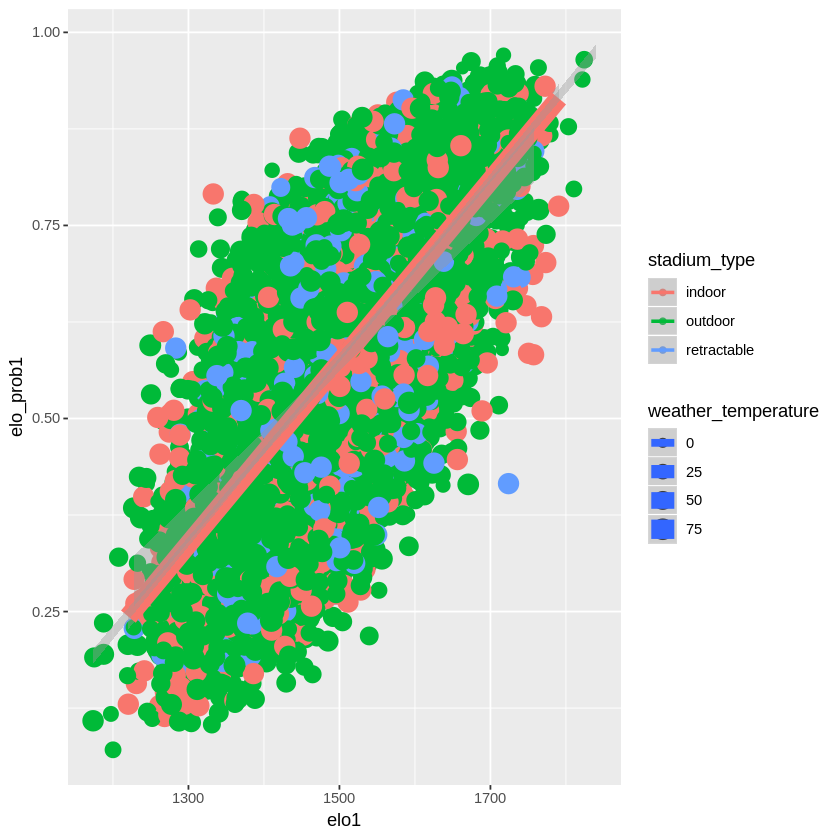

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

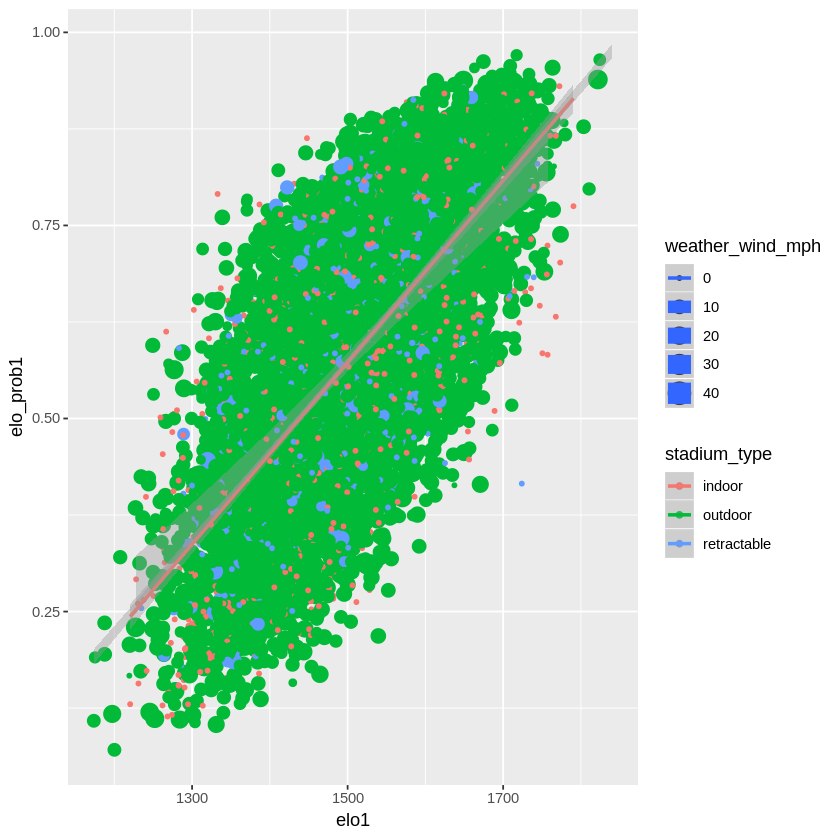

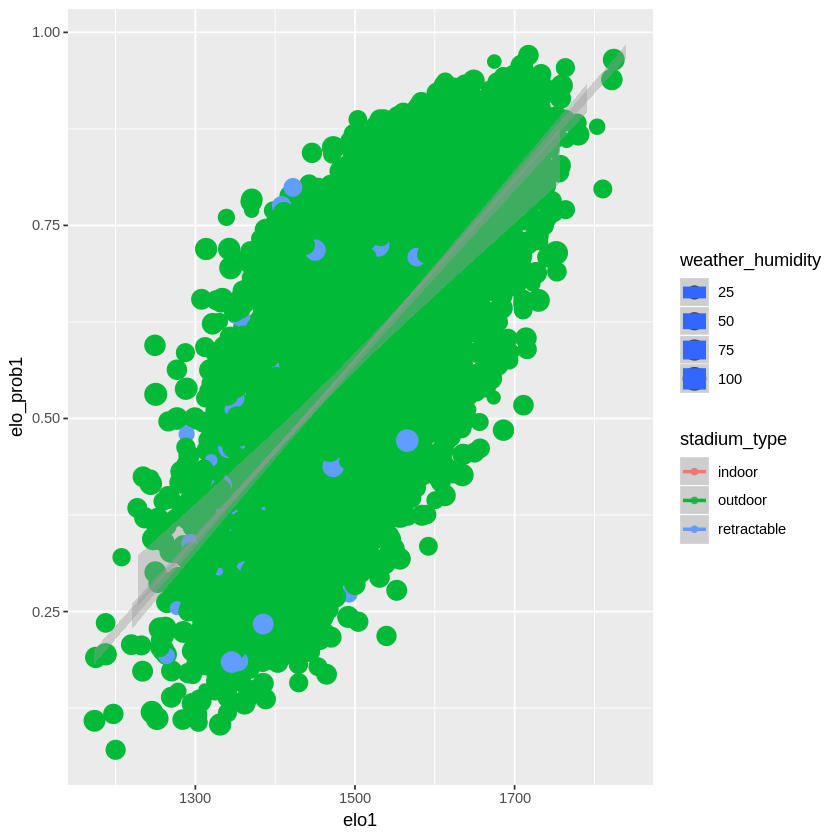

In [11]:
## Scatterplot of elo1, elo_prob1, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature, wind speed and humidity don't seem to have much affect on elo1 or elo_prob1 across all stadium_types
## We can clearly see lower/higher temperatures, wind speeds and humidity at both the higher and lower ends of elo1 & elo_prob1
## Obviously, there's no humidity in indoor staduiums since they're climate controlled

ggplot(stadium_type, aes(x=elo1,y=elo_prob1, color = stadium_type, size = weather_temperature)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=elo_prob1, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=elo_prob1, color = stadium_type, size = weather_humidity)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 292 rows containing missing values (geom_point).”Warning message:
“Removed 292 rows containing missing values (geom_point).”

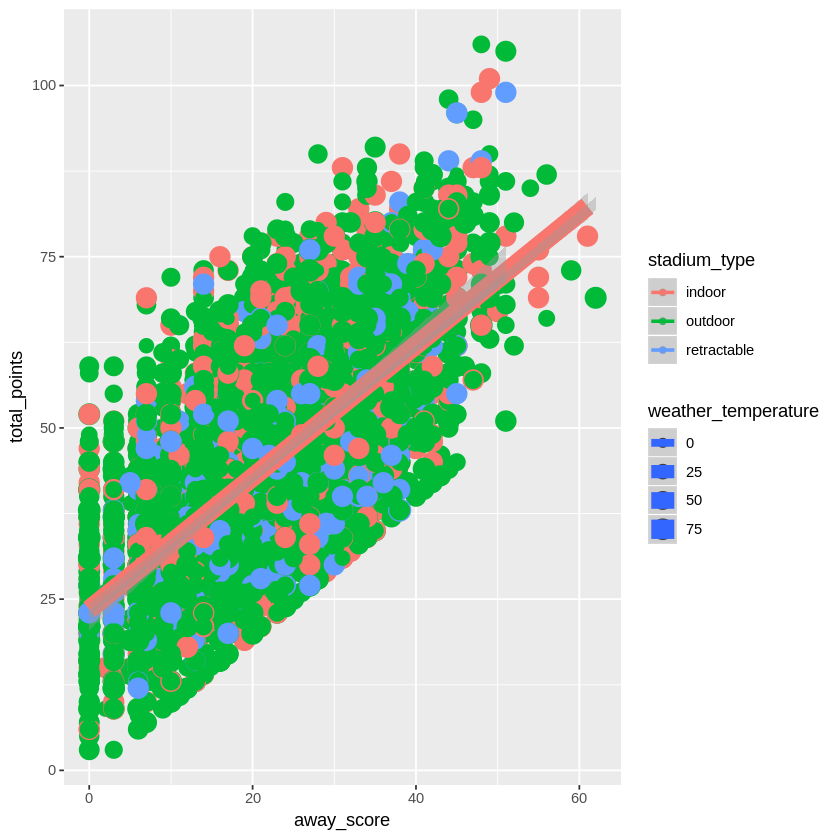

Warning message:
“Removed 3712 rows containing missing values (geom_point).”

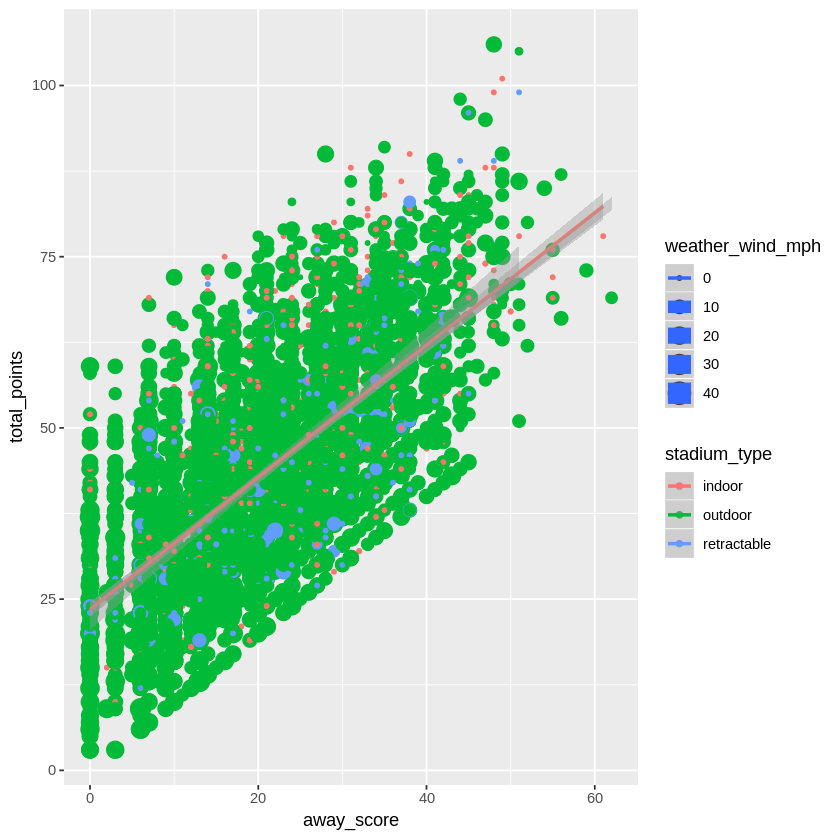

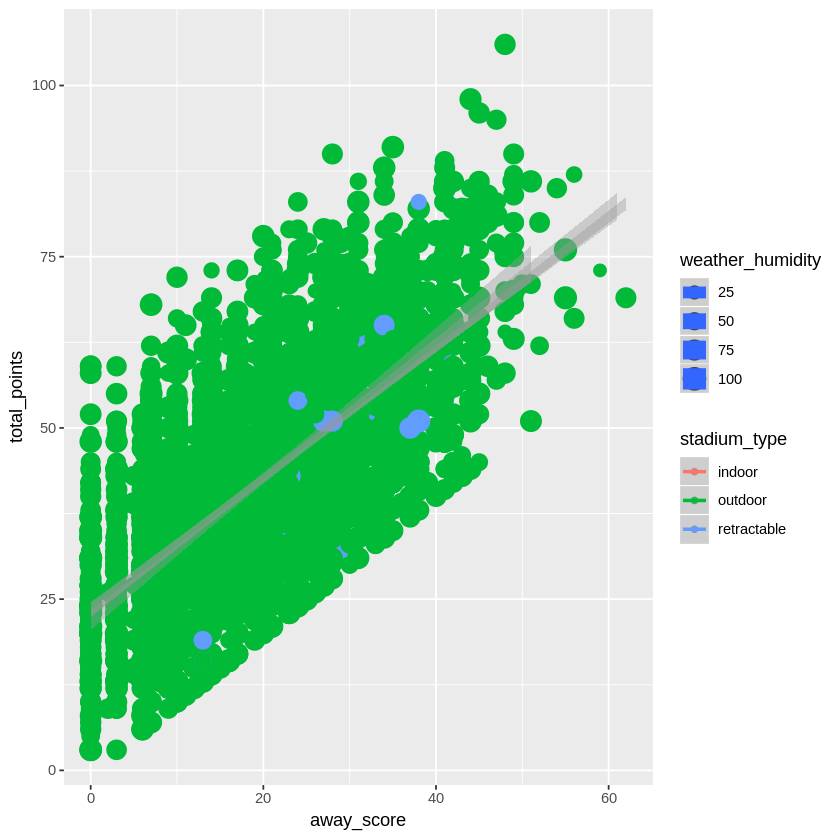

In [12]:
## Scatterplot of away_score, total_points, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature and humidity don't seem to have much affect on away_score or total_points but we can clearly see
## lower wind speeds at higher away_scores and total_points across all stadium_types

ggplot(stadium_type, aes(x=away_score,y=total_points, color = stadium_type, size = weather_temperature)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=away_score,y=total_points, color = stadium_type, size = weather_wind_mph)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=away_score,y=total_points, color = stadium_type, size = weather_humidity)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

### Highly correlated variables (home_score/total_points, elo1/elo_prob1, and away_score/total_points) in relation to stadium_weather_type and temperature, wind speed, and humidity

Warning message:
“Removed 292 rows containing missing values (geom_point).”Warning message:
“Removed 292 rows containing missing values (geom_point).”

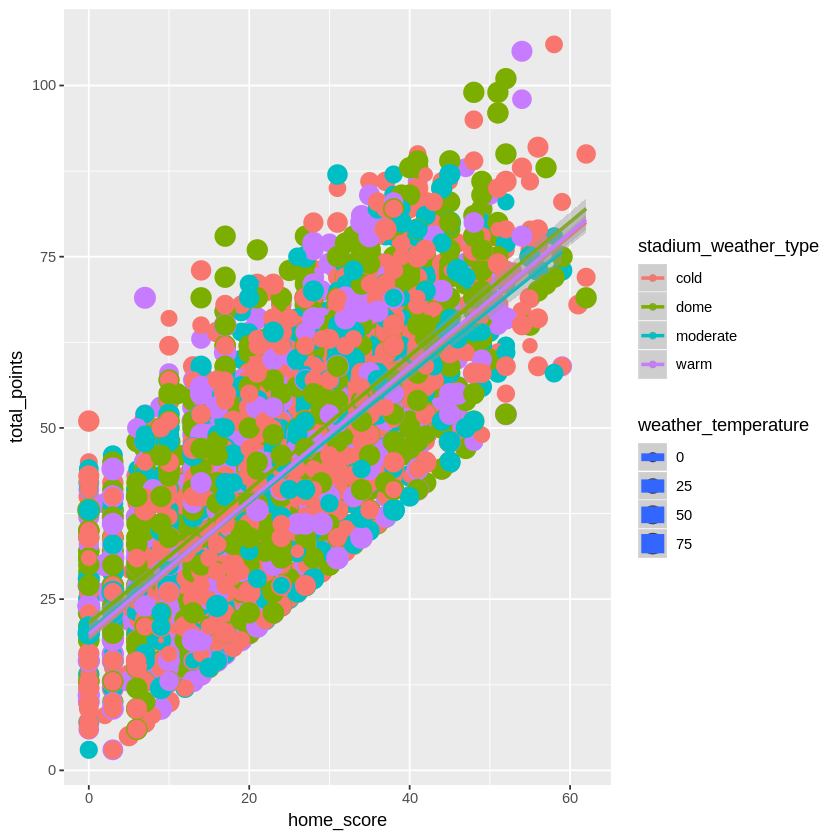

Warning message:
“Removed 3712 rows containing missing values (geom_point).”

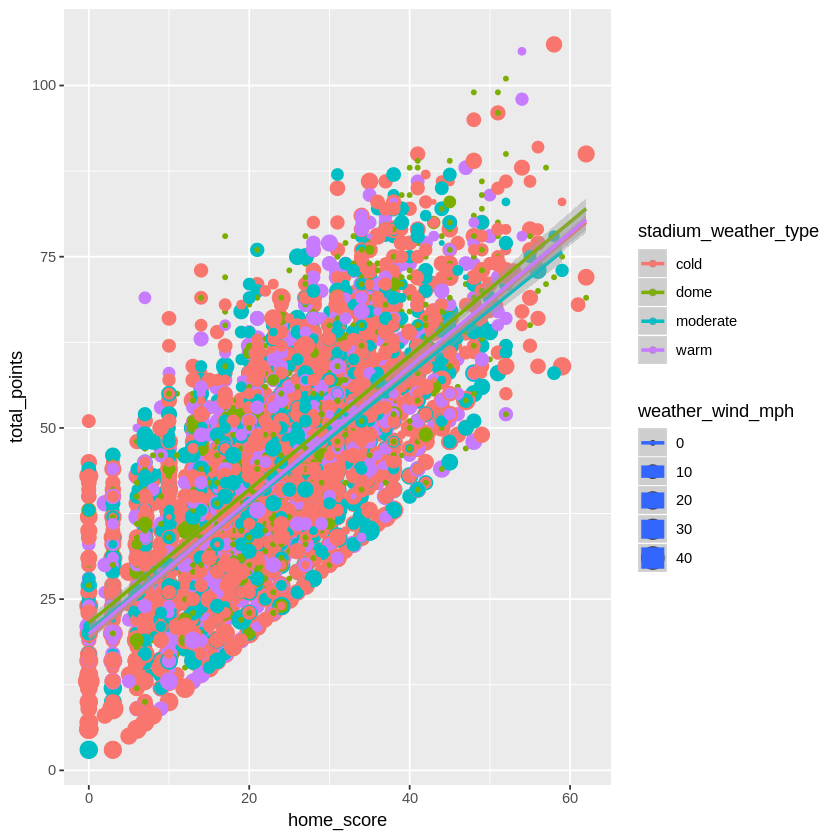

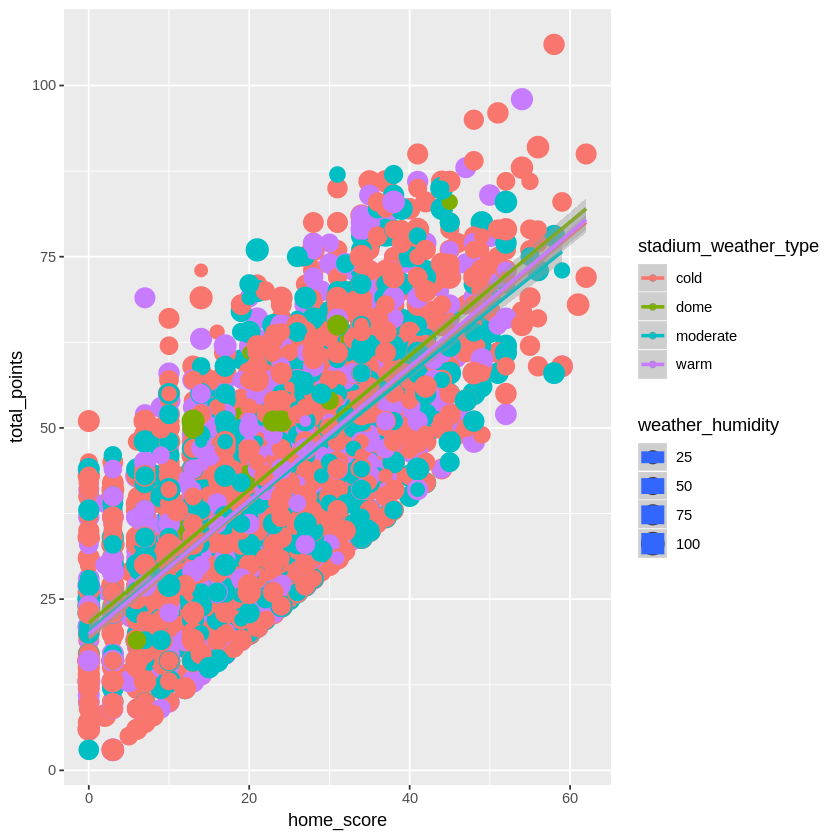

In [13]:
## Scatterplot of home_score, total_points, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again, temperature and humidity don't seem to have much affect on home_score or total_points but we can clearly see
## lower wind speeds at higher away_scores and total_points across all stadium_weather_types

stadium_weather_type <- nfl_df[which(nfl_df$stadium_weather_type == "cold" | nfl_df$stadium_weather_type == "dome" | 
                                nfl_df$stadium_weather_type == "moderate" | nfl_df$stadium_weather_type == "warm"),]

ggplot(stadium_weather_type, aes(x=home_score,y=total_points, color = stadium_weather_type, size = weather_temperature)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=home_score,y=total_points, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=home_score,y=total_points, color = stadium_weather_type, size = weather_humidity)) +
    xlab("home_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)


Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

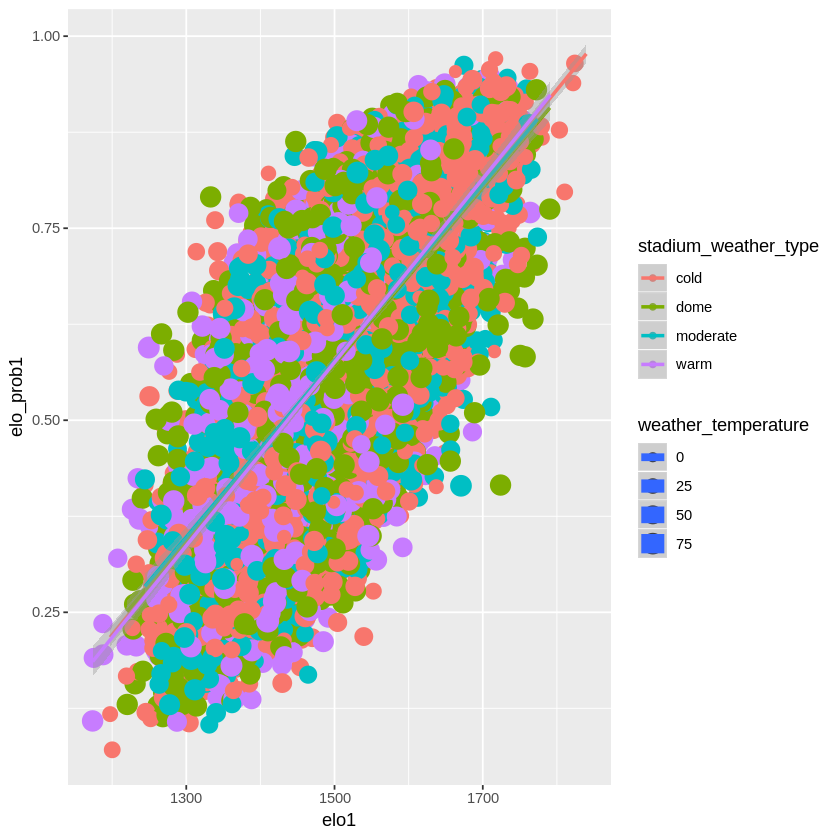

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

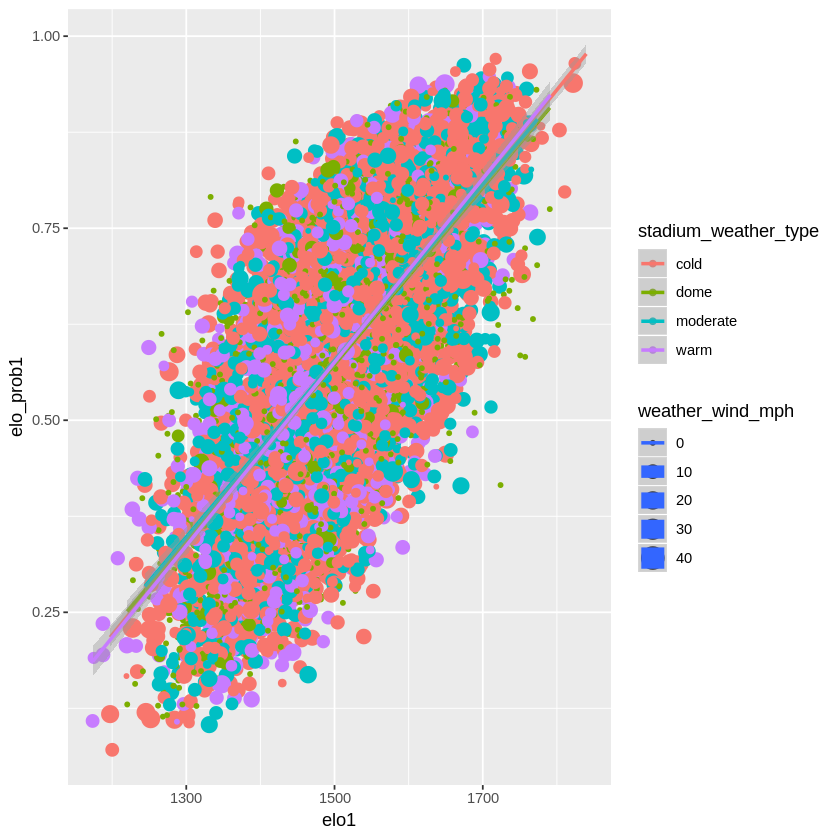

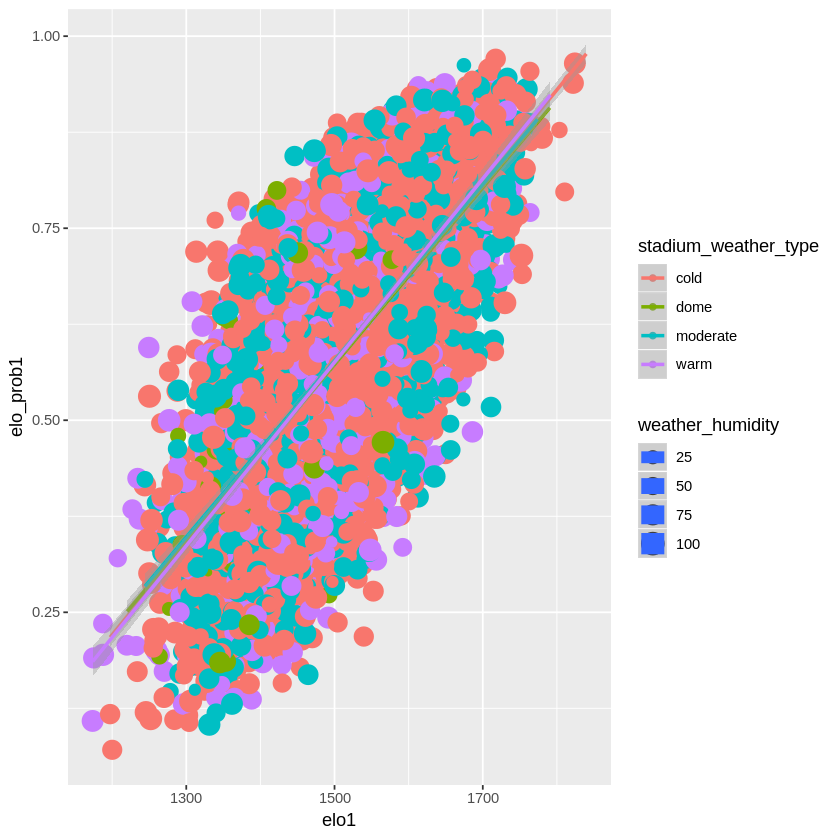

In [14]:
## Scatterplot of elo1, elo_prob1, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature, wind speed and humidity don't seem to have much affect on elo1 or elo_prob1 across all stadium_weather_types
## We can clearly see lower/higher temperatures, wind speeds and humidity at both the higher and lower ends of elo1 & elo_prob1

ggplot(stadium_weather_type, aes(x=elo1,y=elo_prob1, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=elo_prob1, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=elo_prob1, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo1") + ylab("elo_prob1") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 292 rows containing missing values (geom_point).”Warning message:
“Removed 292 rows containing missing values (geom_point).”

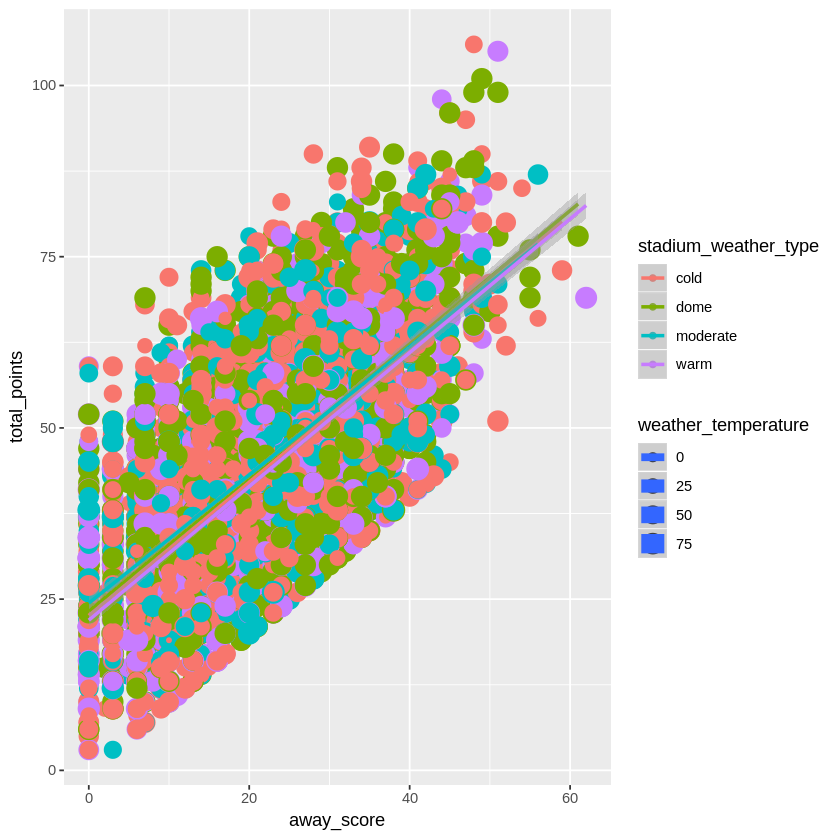

Warning message:
“Removed 3712 rows containing missing values (geom_point).”

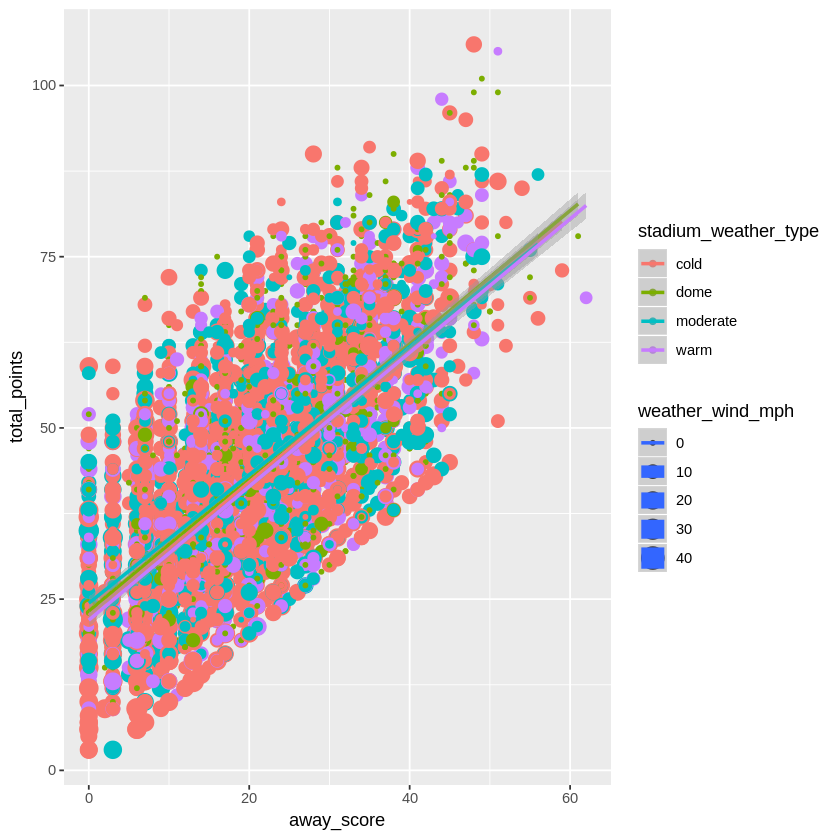

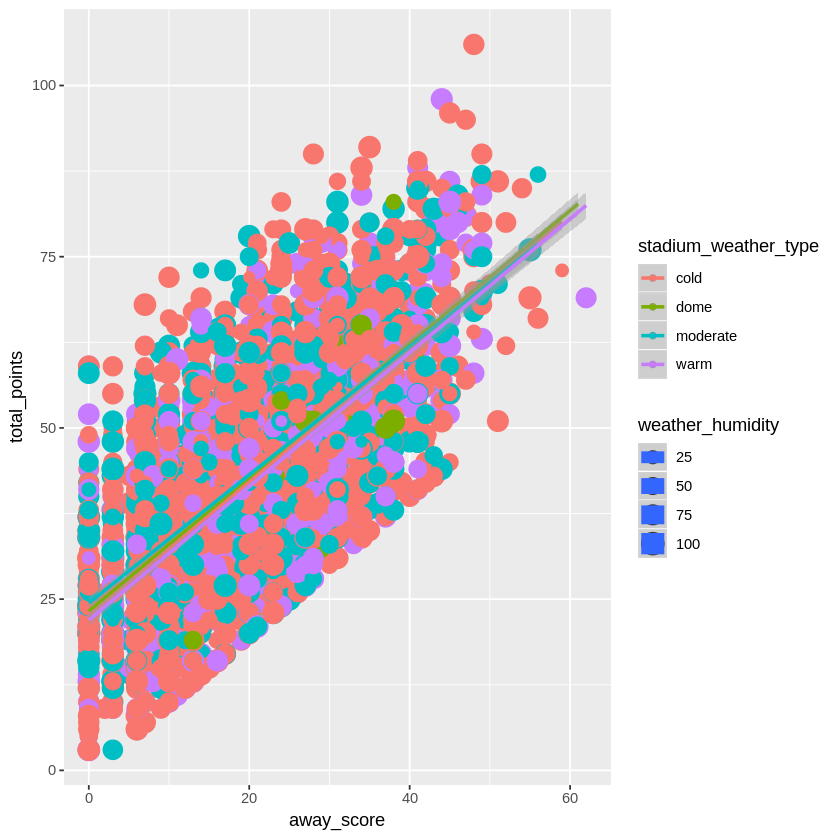

In [15]:
## Scatterplot of away_score, total_points, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature and humidity don't seem to have much affect on away_score or total_points but we can clearly see
## lower wind speeds at higher away_scores and total_points across all stadium_weather_types

ggplot(stadium_weather_type, aes(x=away_score,y=total_points, color = stadium_weather_type, size = weather_temperature)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=away_score,y=total_points, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=away_score,y=total_points, color = stadium_weather_type, size = weather_humidity)) +
    xlab("away_score") + ylab("total_points") + geom_point() + geom_smooth(method=lm)

### Scatterplots of moderate/low correlated variables <a name="lowcorr"></a>

### Scatterplots of moderate/low correlated variables in with  stadium_surface/stadium_type/stadium_weather_type and temperature/wind speed/humidity as additional visual channels

Warning message:
“Removed 1047 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1187 rows containing missing values (geom_point).”Warning message:
“Removed 1047 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1187 rows containing missing values (geom_point).”

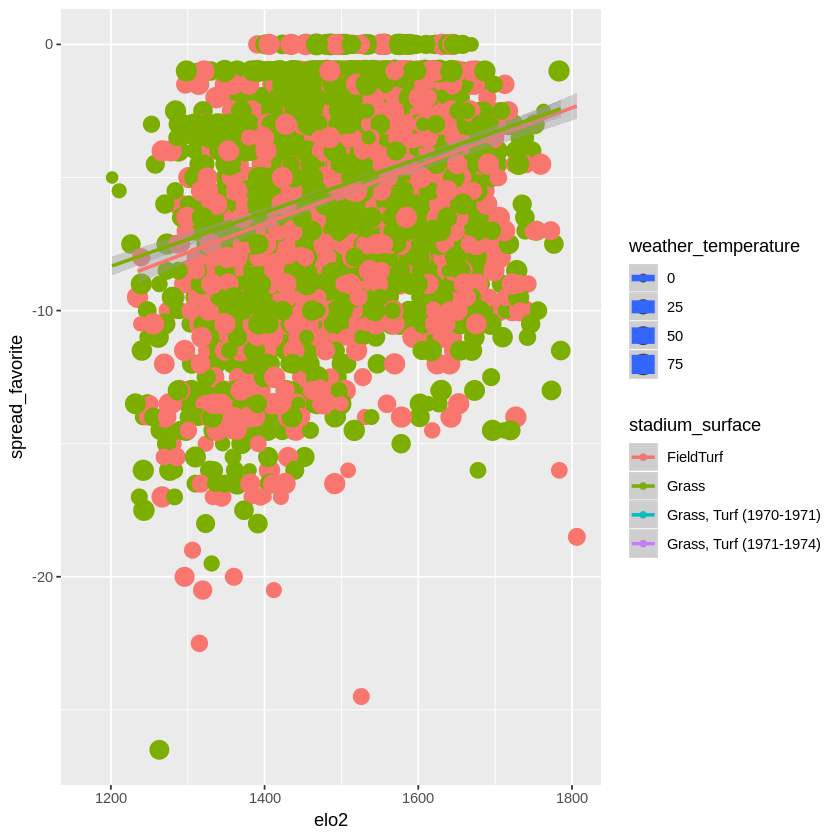

Warning message:
“Removed 1047 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2967 rows containing missing values (geom_point).”

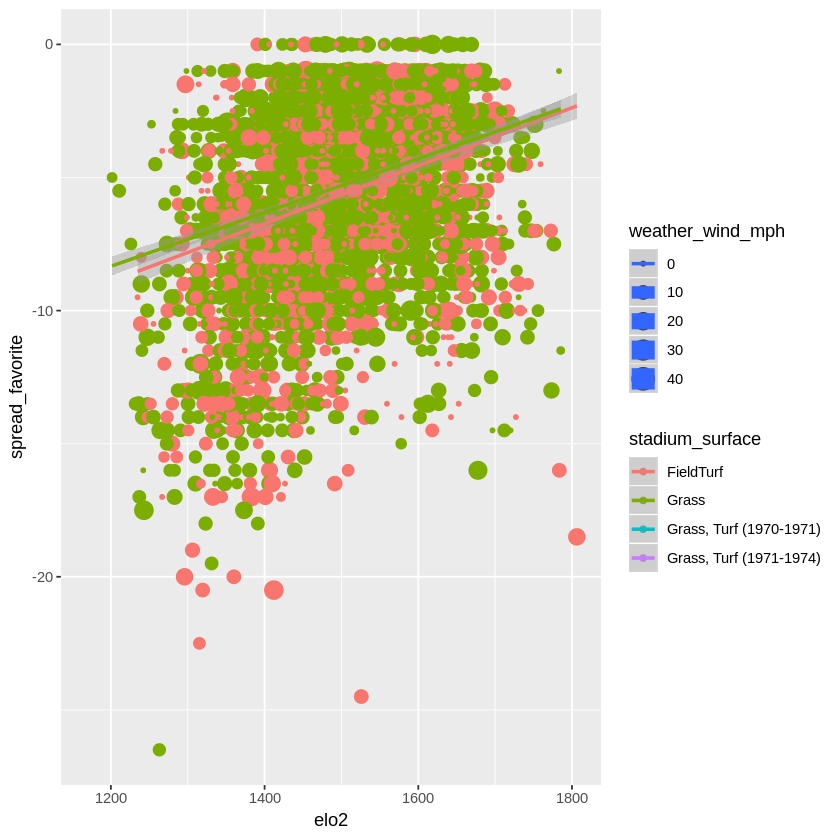

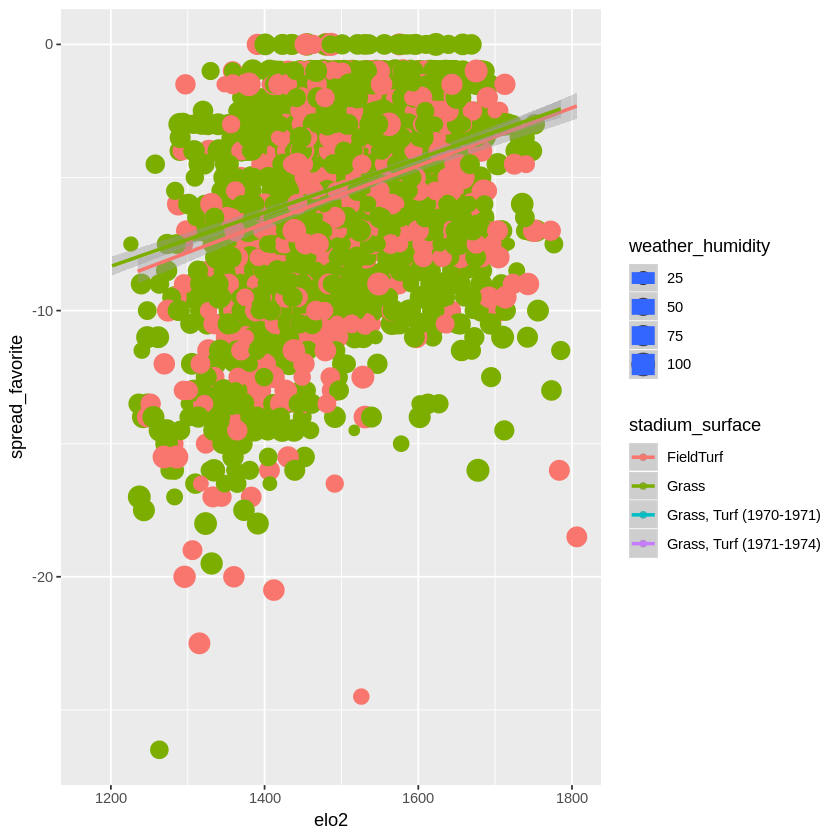

In [16]:
## Scatterplot of elo2, spread_favorite, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Since spreads are given in negative numbers, -1 is a lower spread than -20.

## Temperature, wind speed, and humidity all seems to be evenly spread across all stadiums surfaces when looking at elo2 in 
## relation to spread_favorite

ggplot(stadium_surface, aes(x=elo2,y=spread_favorite, color = stadium_surface, size = weather_temperature)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=spread_favorite, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=spread_favorite, color = stadium_surface, size = weather_humidity)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2777 rows containing missing values (geom_point).”Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2777 rows containing missing values (geom_point).”

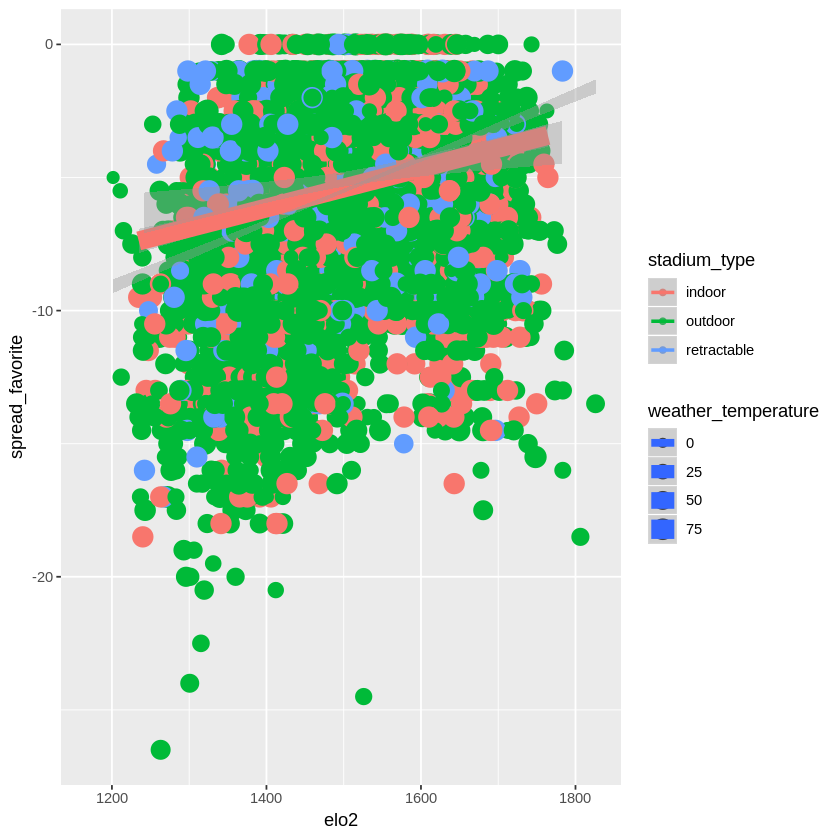

Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5697 rows containing missing values (geom_point).”

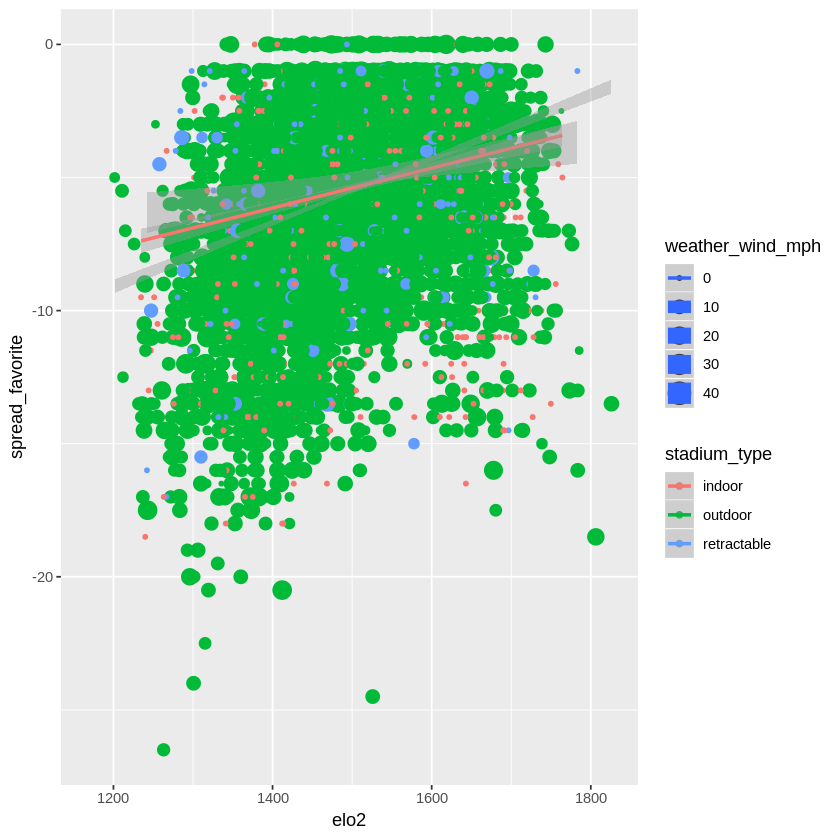

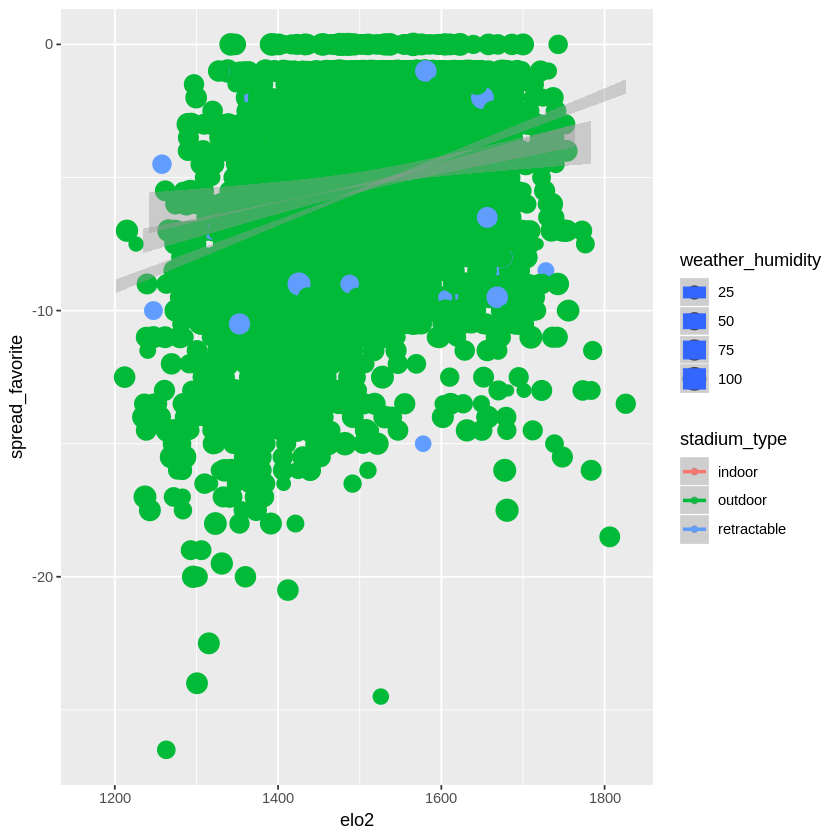

In [17]:
## Scatterplot of elo2, spread_favorite, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again, most games are played outdoors and we see an even disbursement of temperature, wind speed, and humidity across all
## stadium types.

ggplot(stadium_type, aes(x=elo2,y=spread_favorite, color = stadium_type, size = weather_temperature)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=spread_favorite, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=spread_favorite, color = stadium_type, size = weather_humidity)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2777 rows containing missing values (geom_point).”Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2777 rows containing missing values (geom_point).”

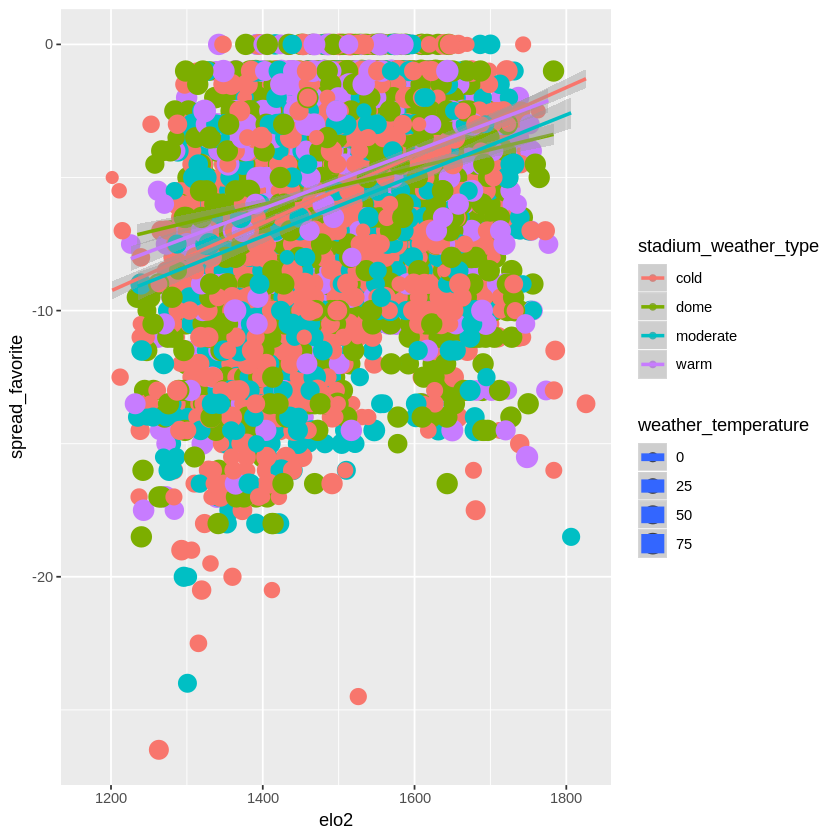

Warning message:
“Removed 2512 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5697 rows containing missing values (geom_point).”

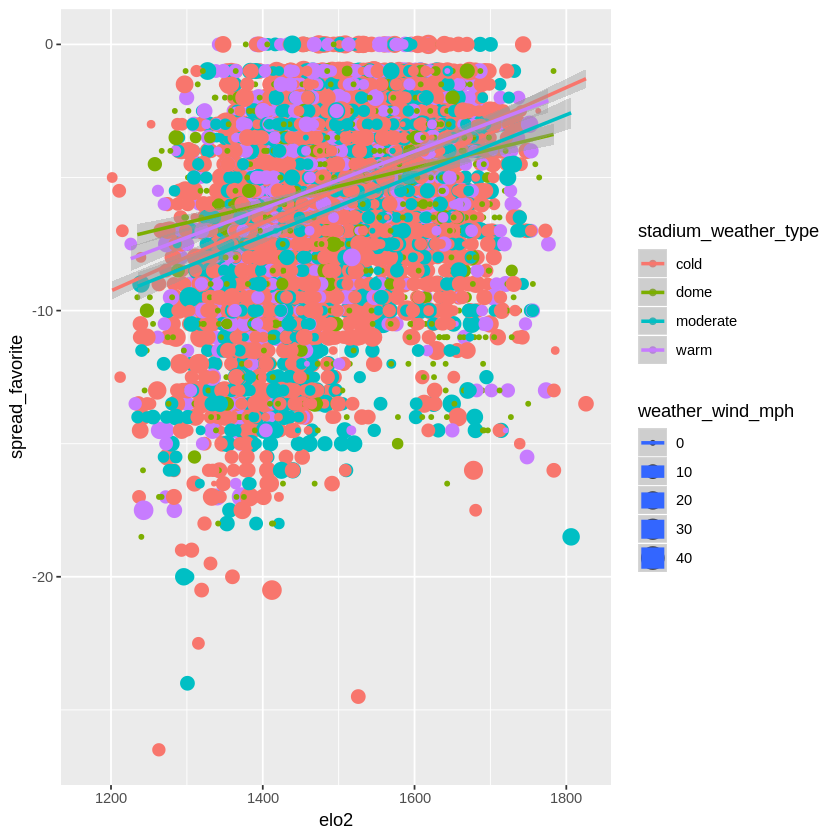

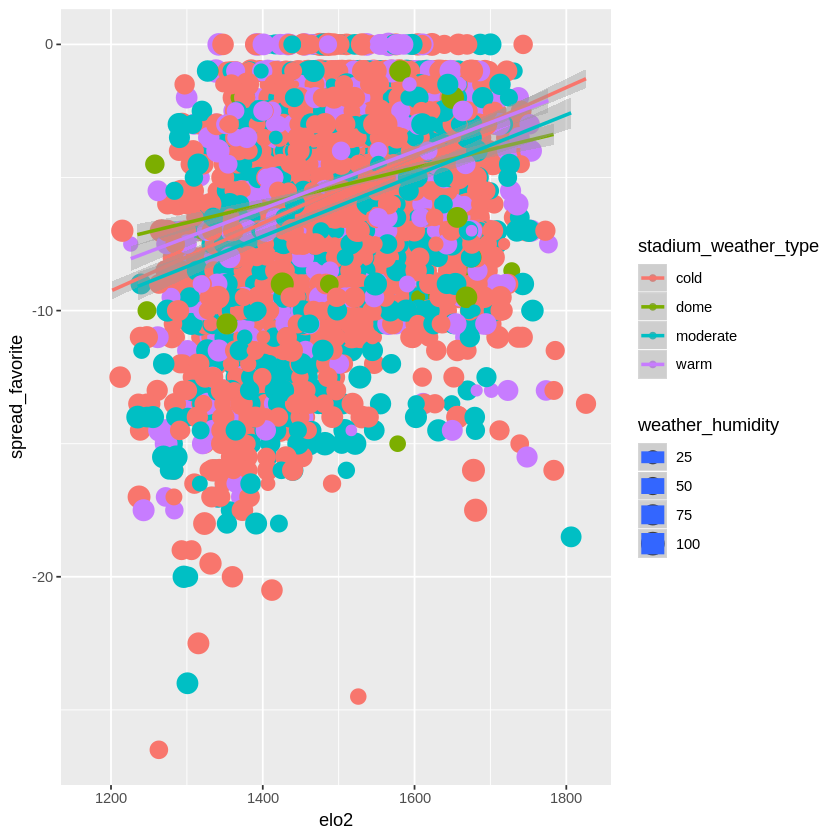

In [18]:
## Scatterplot of elo2, spread_favorite, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## We see the same disbursement as above when looking at stadium_weather_types.

ggplot(stadium_weather_type, aes(x=elo2,y=spread_favorite, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=spread_favorite, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=spread_favorite, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo2") + ylab("spread_favorite") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”

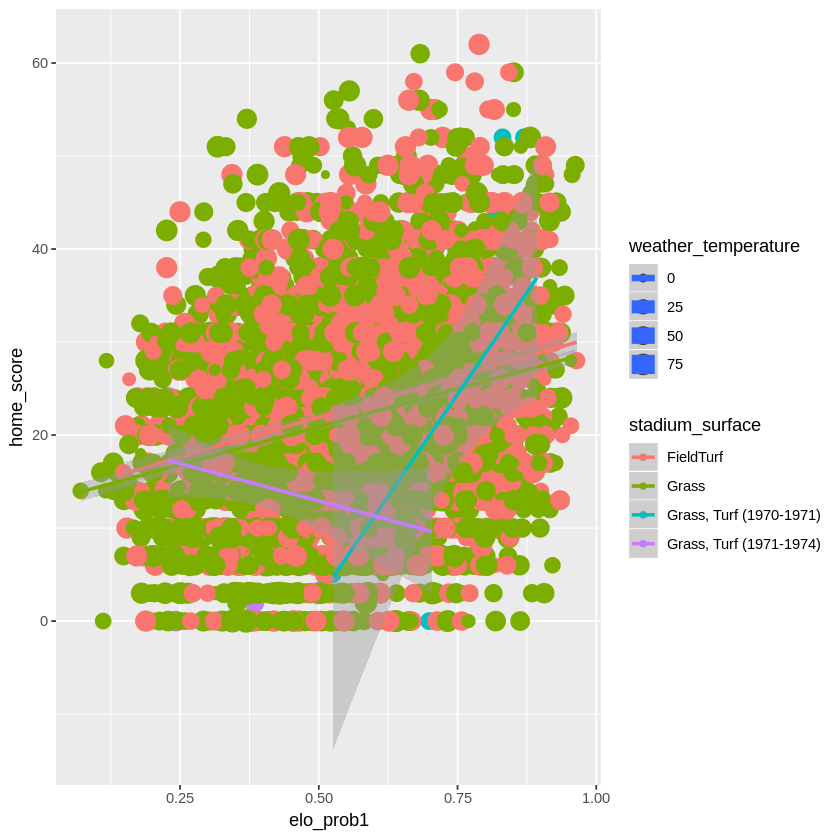

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2377 rows containing missing values (geom_point).”

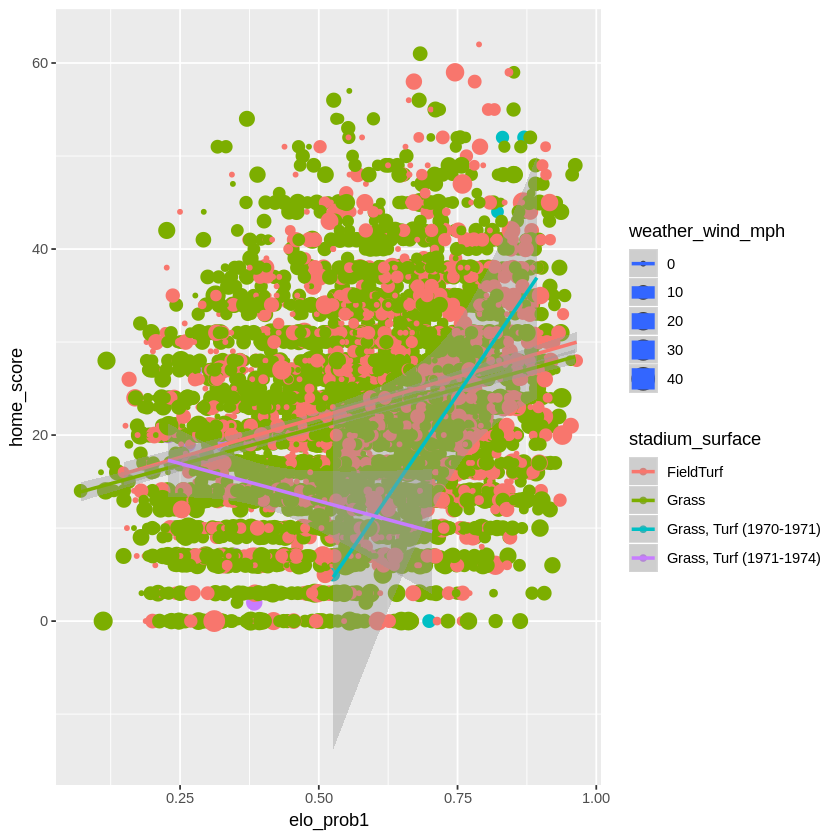

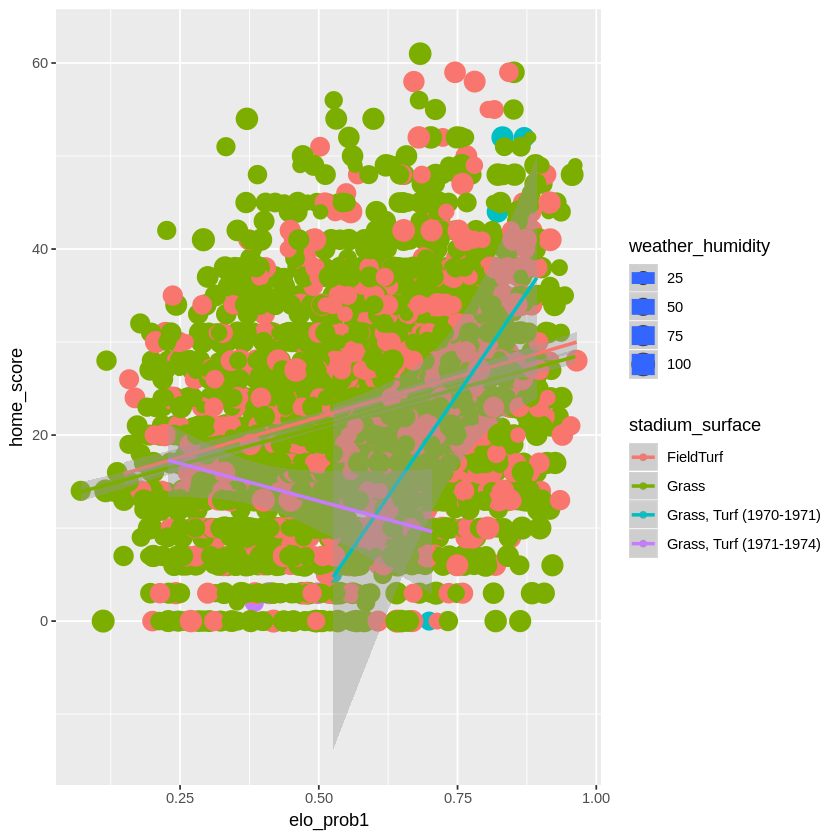

In [19]:
## Scatterplot of elo_prob1, home_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## We don't see any significant groupings in the weather data across stadium_surfaces when looking home score
## and elo_prob1.  But it's interesting to note that these to variables are more highly correlated.  There are many games
## where the home team had a high probability of winning and also had a low score at the end of the game.

ggplot(stadium_surface, aes(x=elo_prob1,y=home_score, color = stadium_surface, size = weather_temperature)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo_prob1,y=home_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo_prob1,y=home_score, color = stadium_surface, size = weather_humidity)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

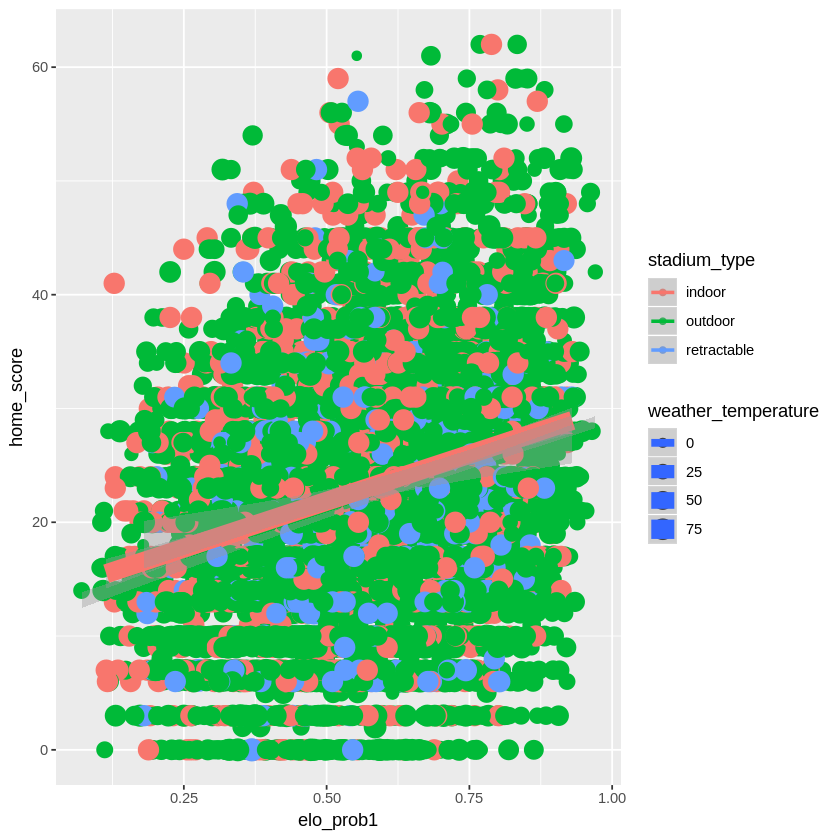

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

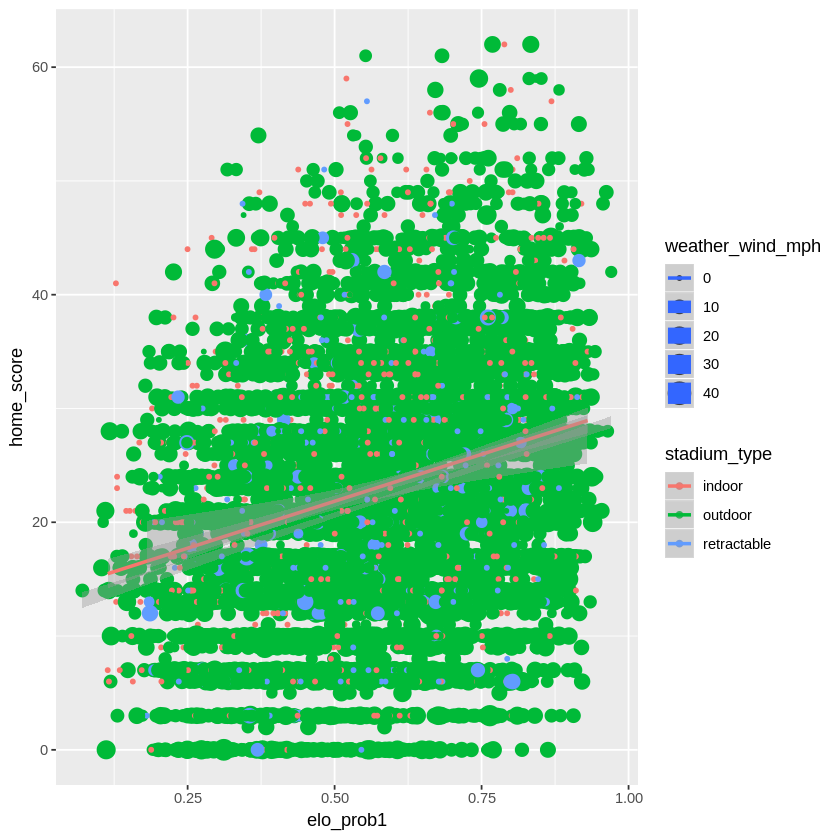

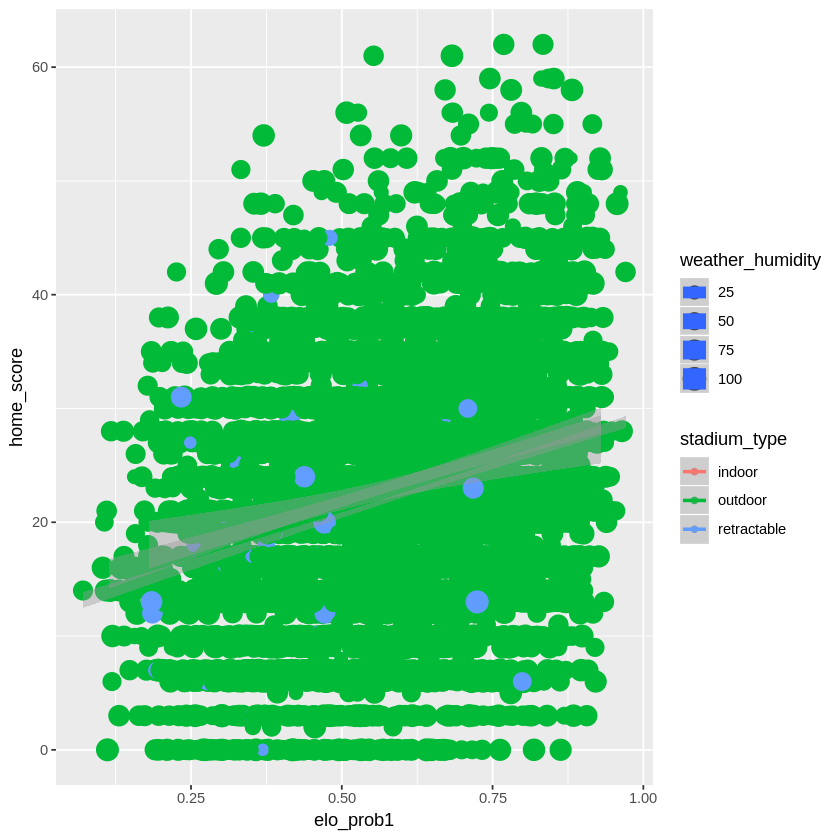

In [20]:
## Scatterplot of elo_prob1, home_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again, we don't see any significant groupings of temperature, wind speed, and humidity across stadium types when looking 
## at elo_prob1 and home score.

ggplot(stadium_type, aes(x=elo_prob1,y=home_score, color = stadium_type, size = weather_temperature)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo_prob1,y=home_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo_prob1,y=home_score, color = stadium_type, size = weather_humidity)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

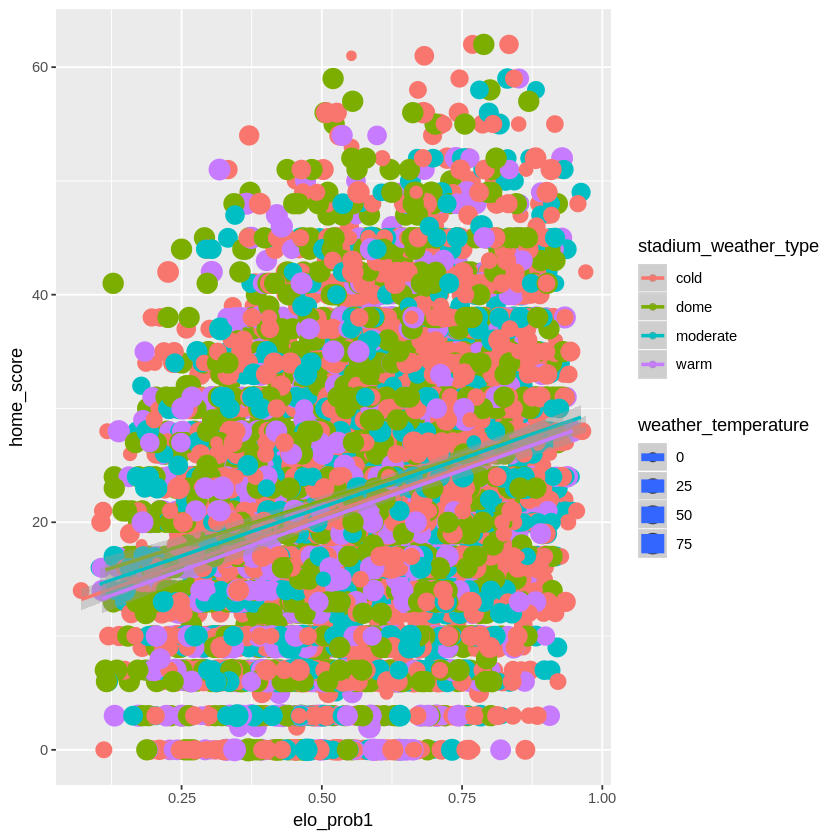

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

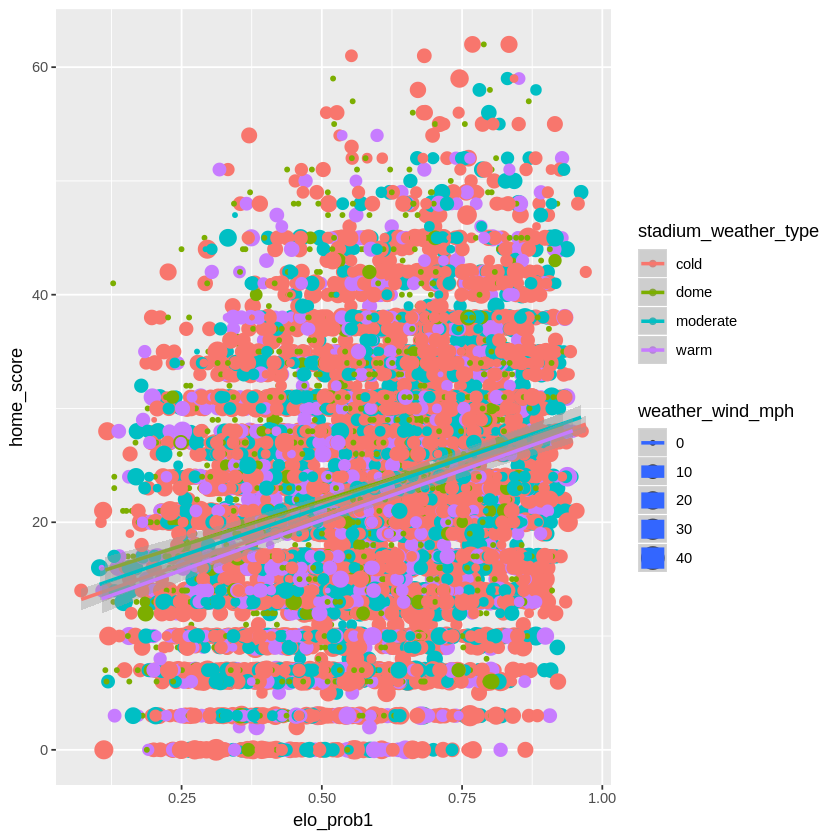

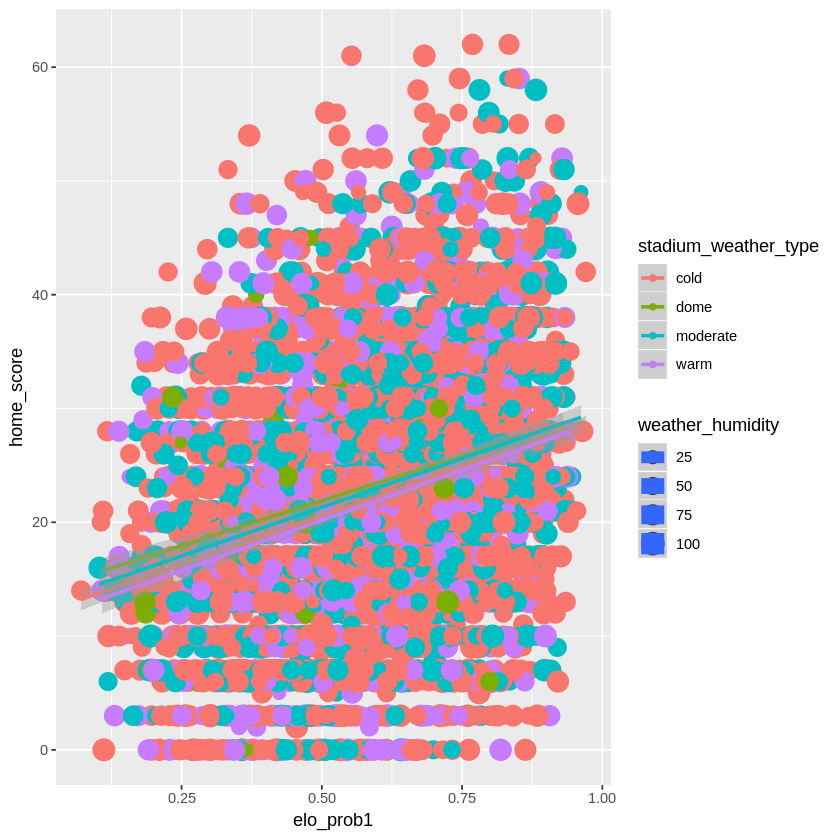

In [21]:
## Scatterplot of elo_prob1, home_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again, we don't see any significant groupings of temperature, wind speed, and humidity across stadium_weather_type types 
## when looking at elo_prob1 and home score.

ggplot(stadium_weather_type, aes(x=elo_prob1,y=home_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo_prob1,y=home_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo_prob1,y=home_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo_prob1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”

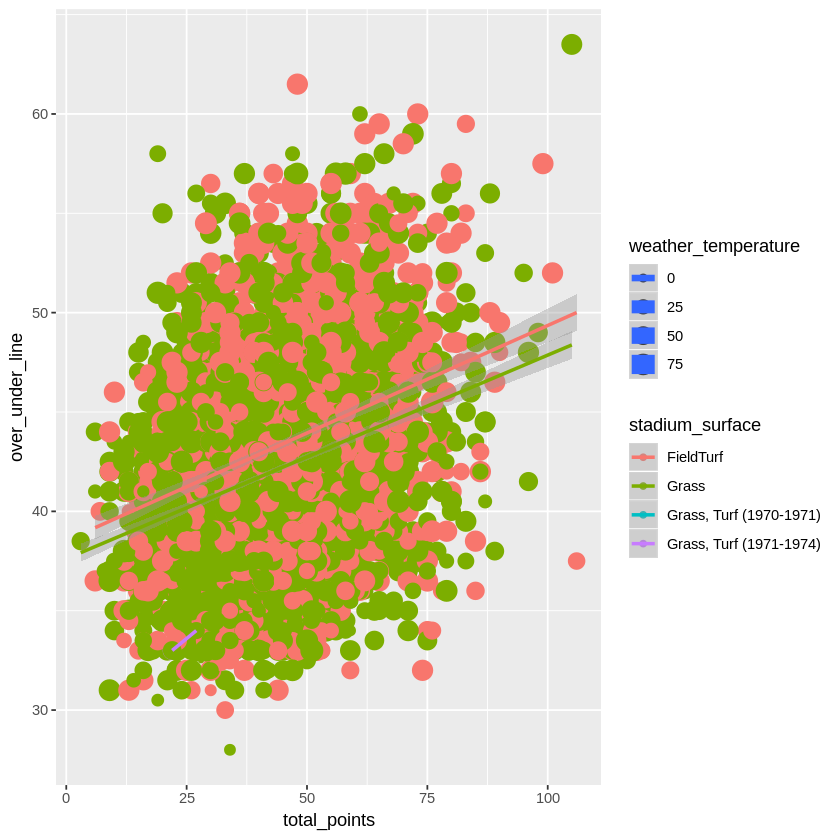

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 2882 rows containing missing values (geom_point).”

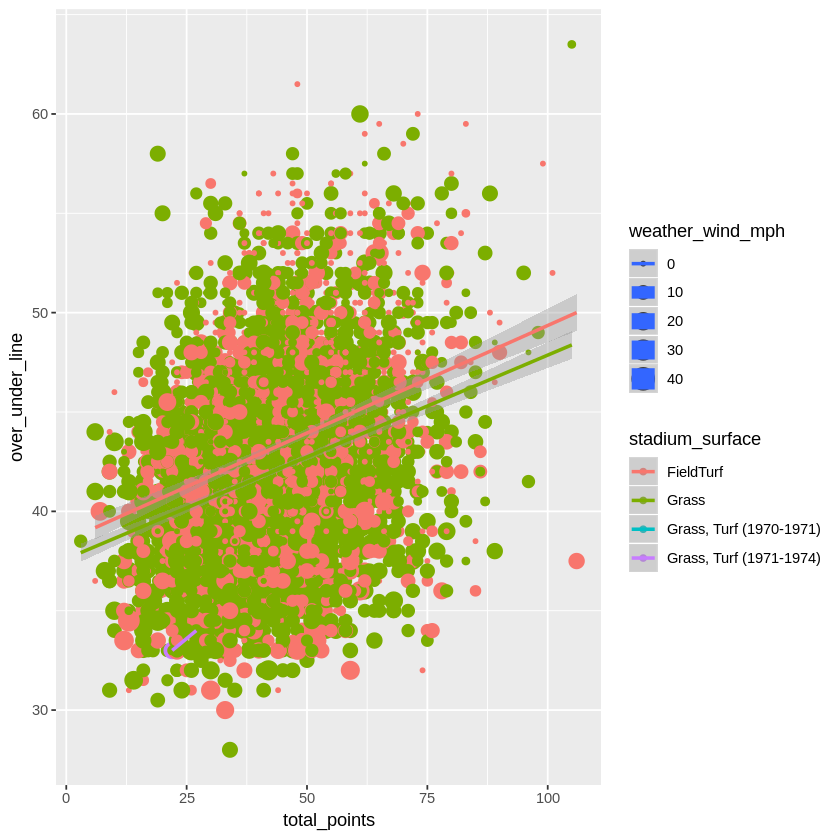

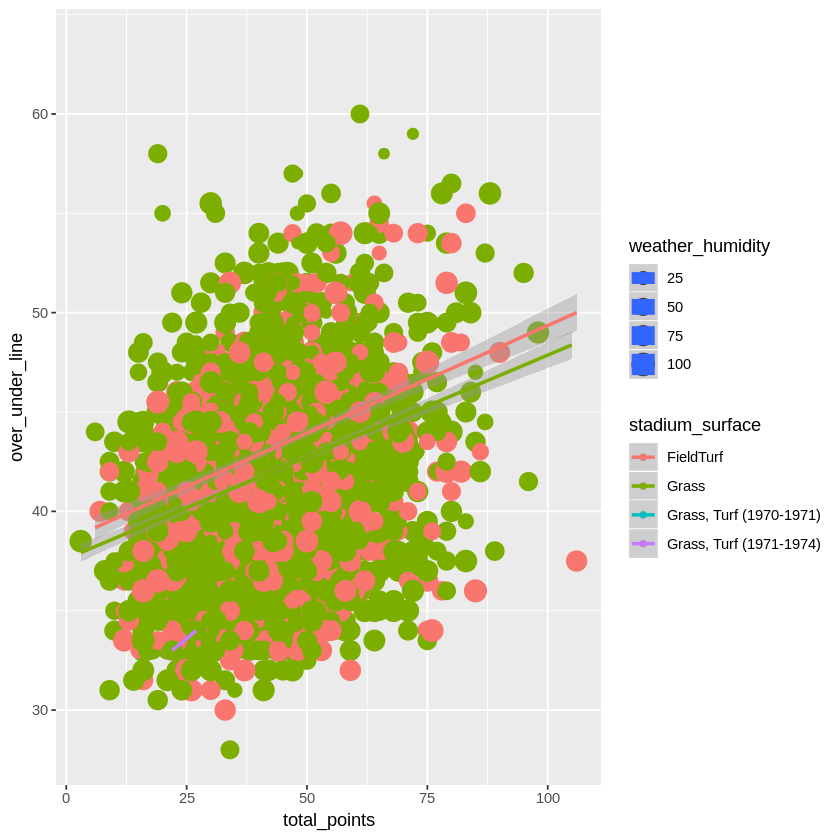

In [22]:
## Scatterplot of total_points, over_under_line, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Temperature and humidity look evenly disbursed but lower wind speeds seem to translate into higher over_under_lines.  
## This makes sense.  If the wind is calm the weather is likely calm which makes for higher scoring games.

ggplot(stadium_surface, aes(x=total_points,y=over_under_line, color = stadium_surface, size = weather_temperature)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=total_points,y=over_under_line, color = stadium_surface, size = weather_wind_mph)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=total_points,y=over_under_line, color = stadium_surface, size = weather_humidity)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

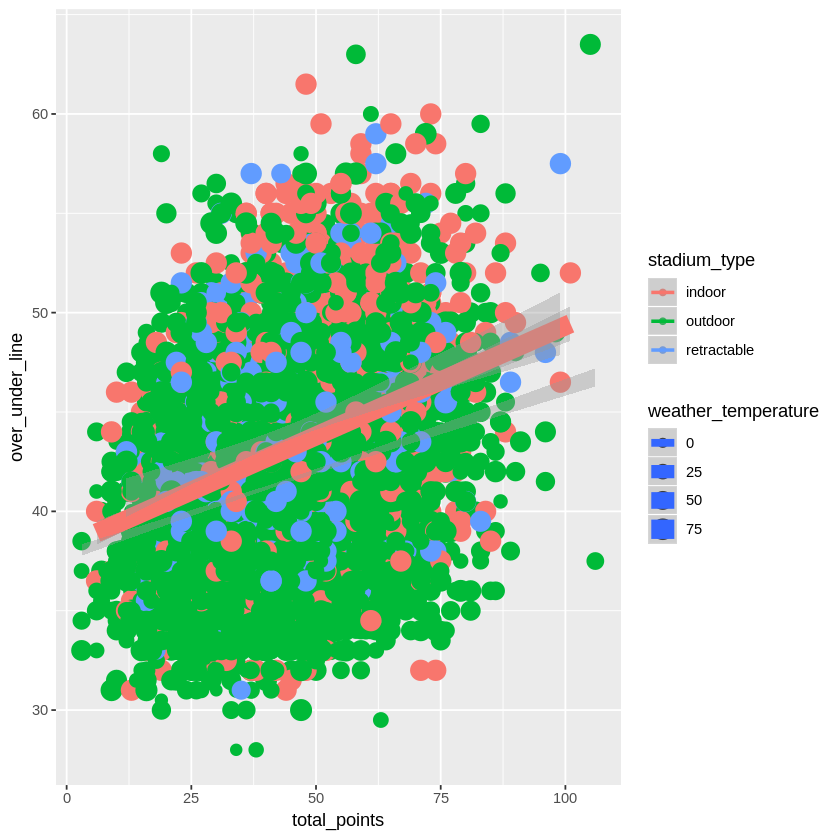

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

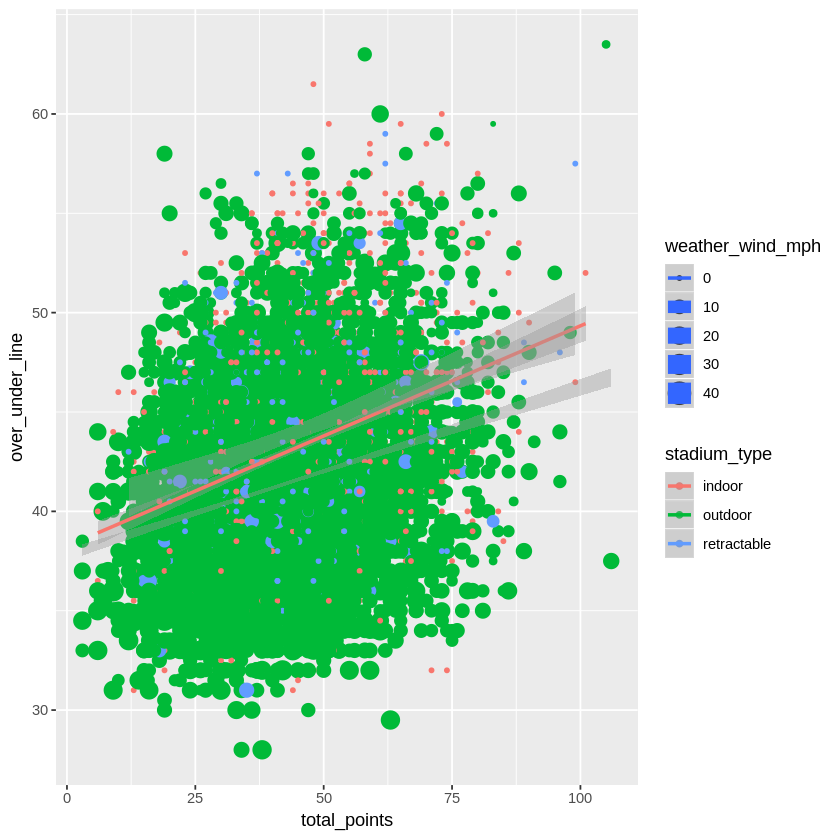

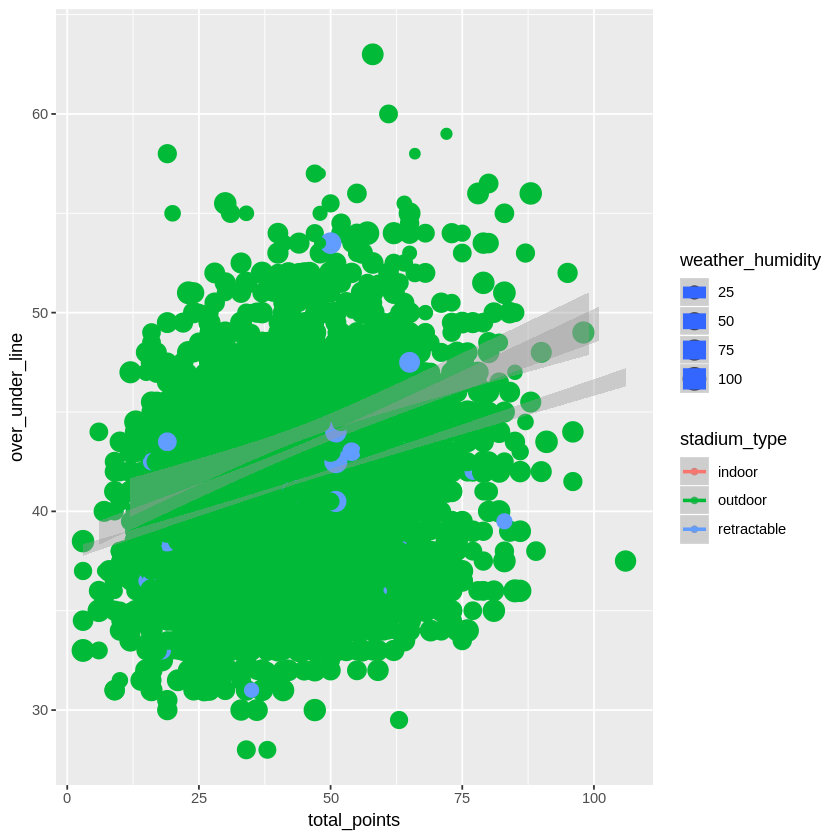

In [23]:
## Scatterplot of total_points, over_under_line, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## We see the same groupings as above when looking at stadium types.  Notice that there are more indoor games with high
## over under lines than lower over under lines.

ggplot(stadium_type, aes(x=total_points,y=over_under_line, color = stadium_type, size = weather_temperature)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=total_points,y=over_under_line, color = stadium_type, size = weather_wind_mph)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=total_points,y=over_under_line, color = stadium_type, size = weather_humidity)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

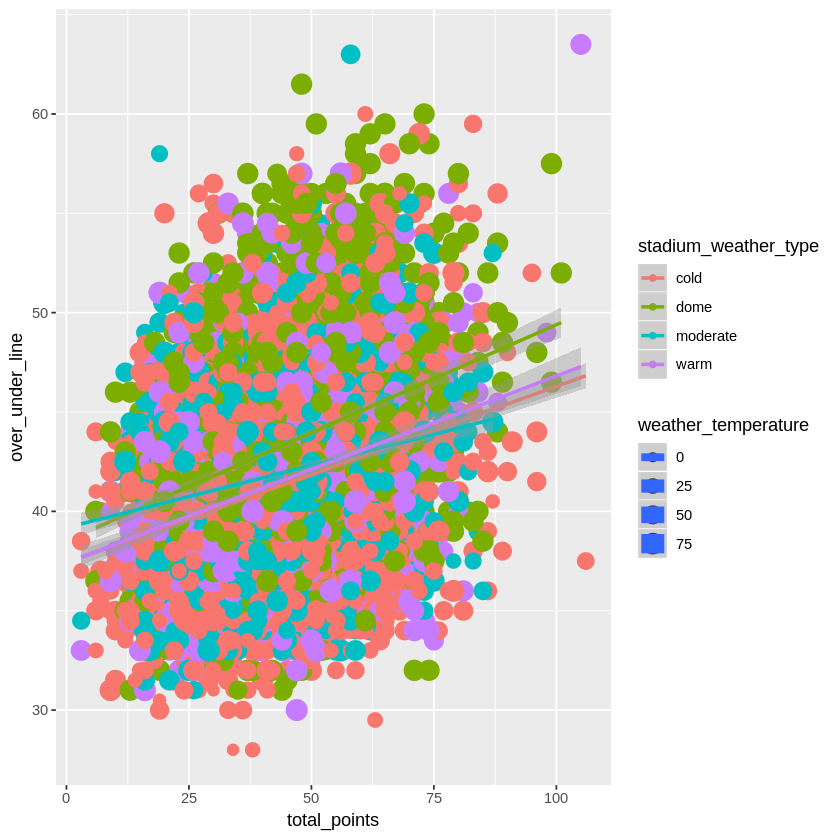

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

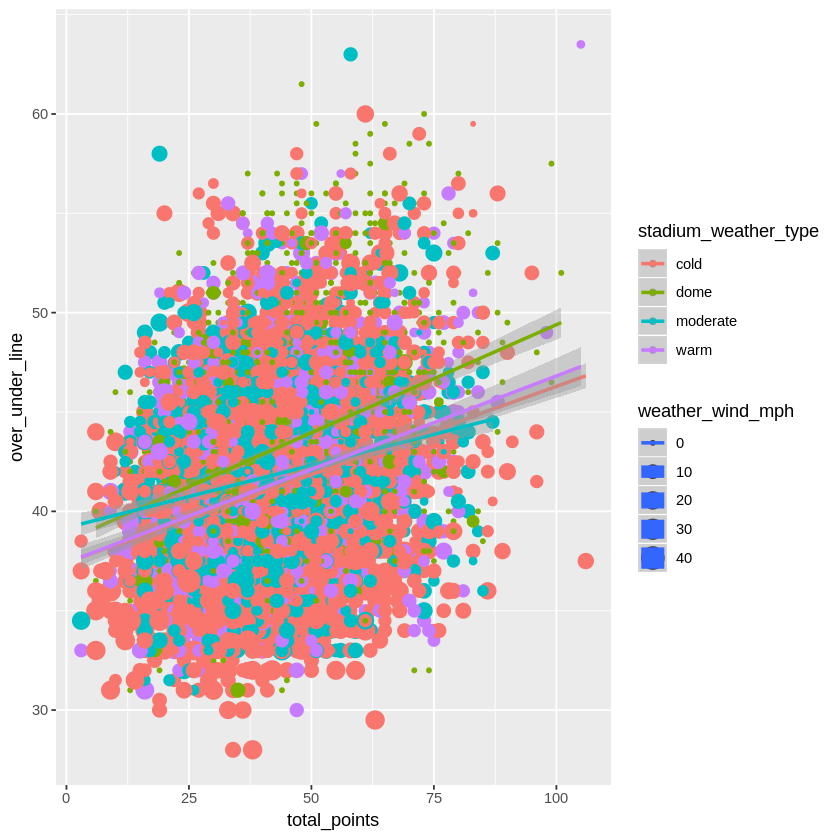

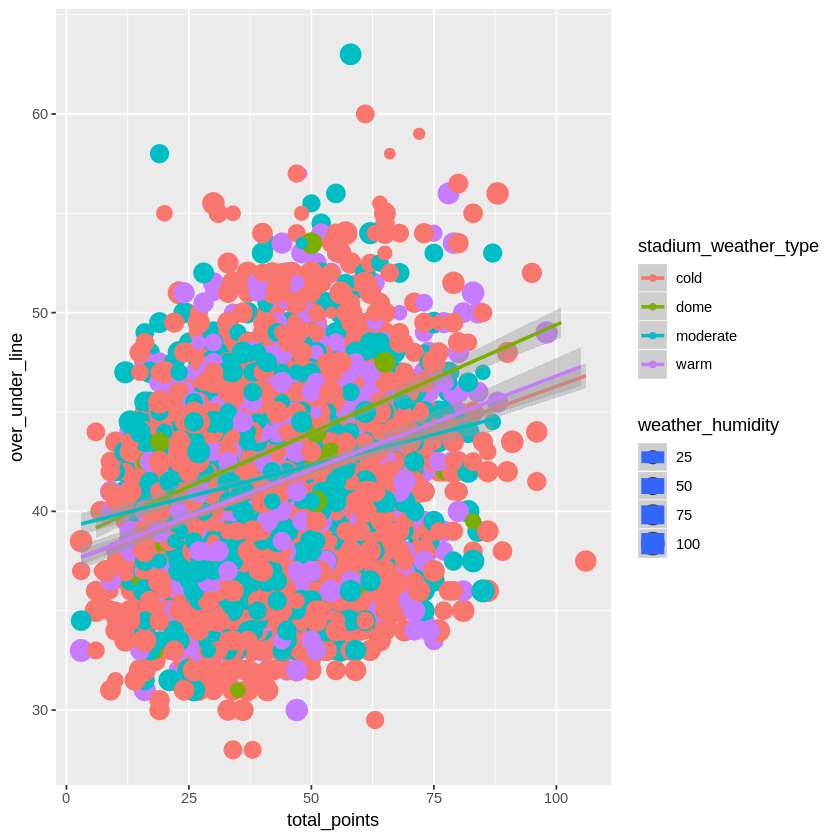

In [24]:
## Scatterplot of total_points, over_under_line, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, 
## and weather_humidity

## Just as above we see more games played in domes (indoor) with high over under lines than with lower under over lines.

ggplot(stadium_weather_type, aes(x=total_points,y=over_under_line, color = stadium_weather_type, size = weather_temperature)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=total_points,y=over_under_line, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=total_points,y=over_under_line, color = stadium_weather_type, size = weather_humidity)) +
    xlab("total_points") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”

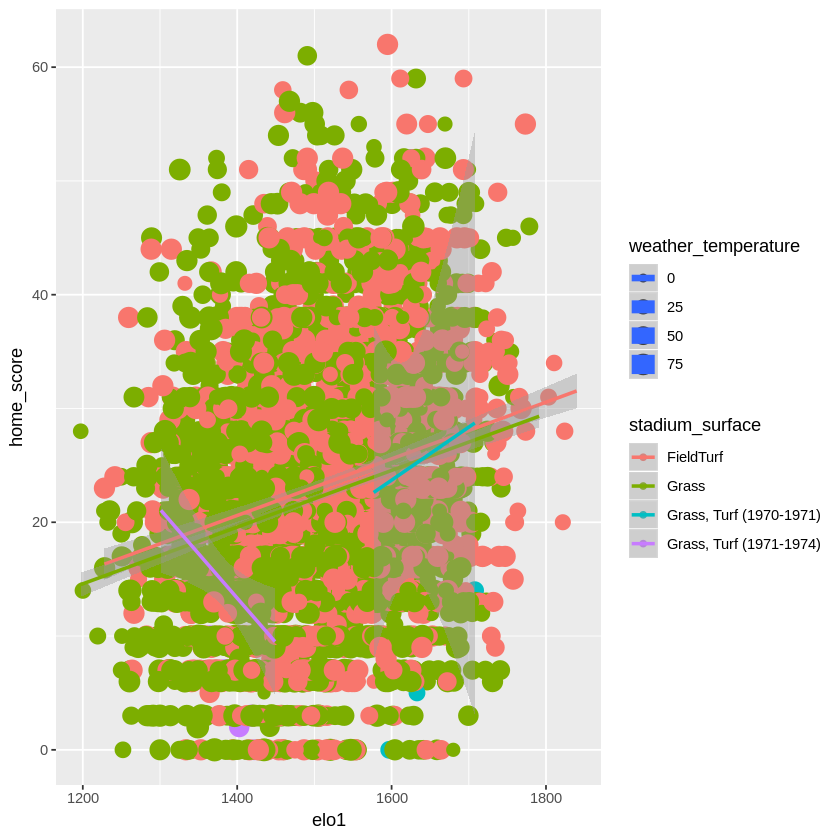

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2377 rows containing missing values (geom_point).”

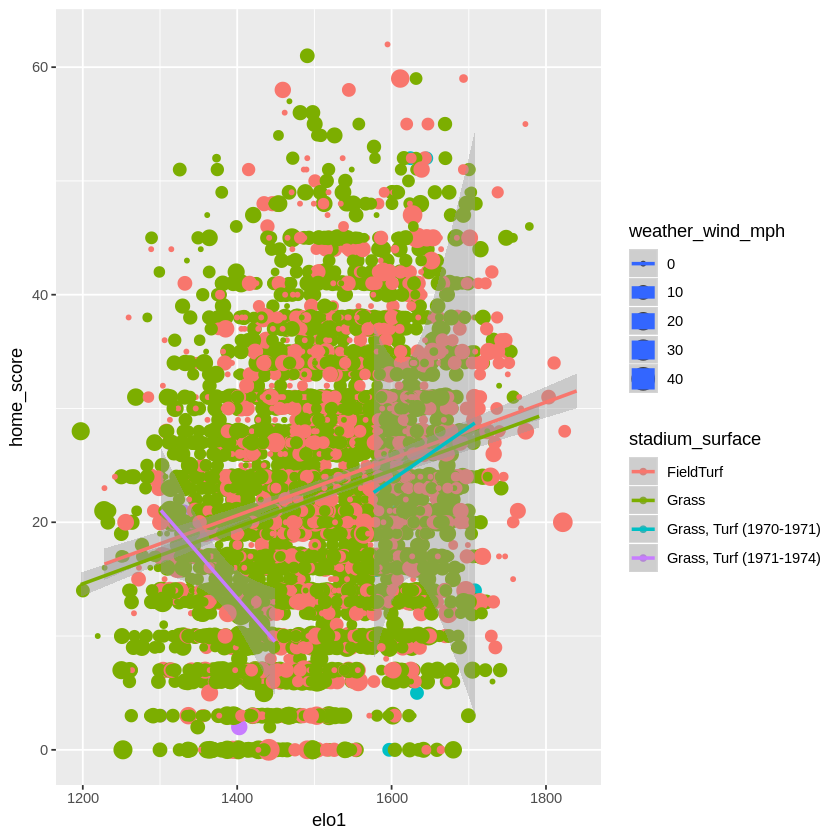

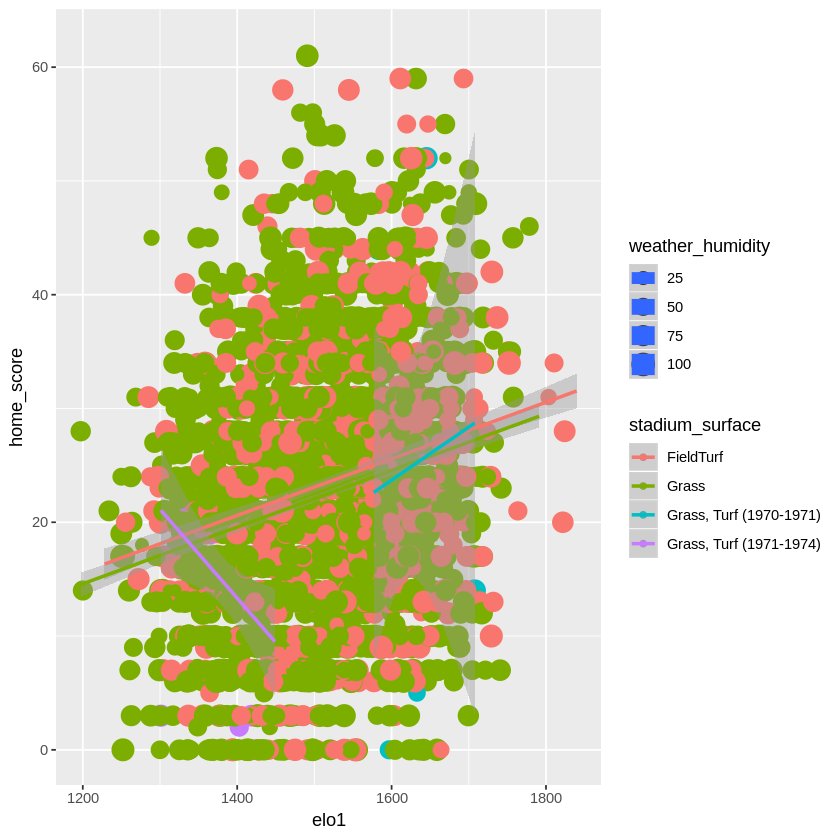

In [25]:
## Scatterplot of elo1, home_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## We're noticing a pattern.  Lower wind speeds seem to translate into higher homes scores and elo1 score which makes sense.
## Calm weather at home provides a better opportunity to score points than volatile weather.

ggplot(stadium_surface, aes(x=elo1,y=home_score, color = stadium_surface, size = weather_temperature)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=home_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=home_score, color = stadium_surface, size = weather_humidity)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

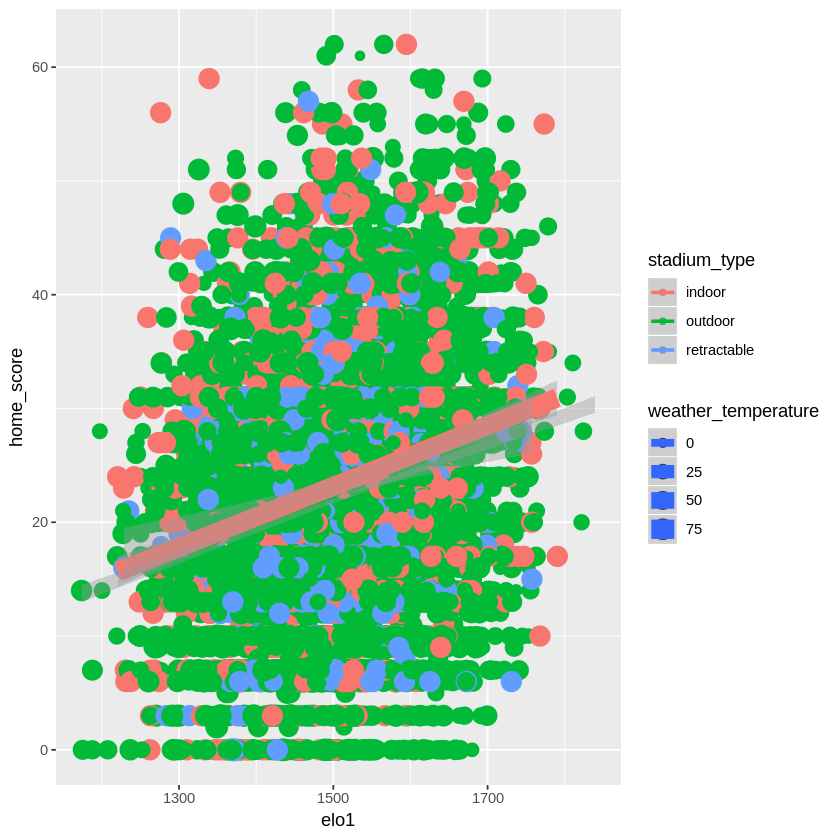

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

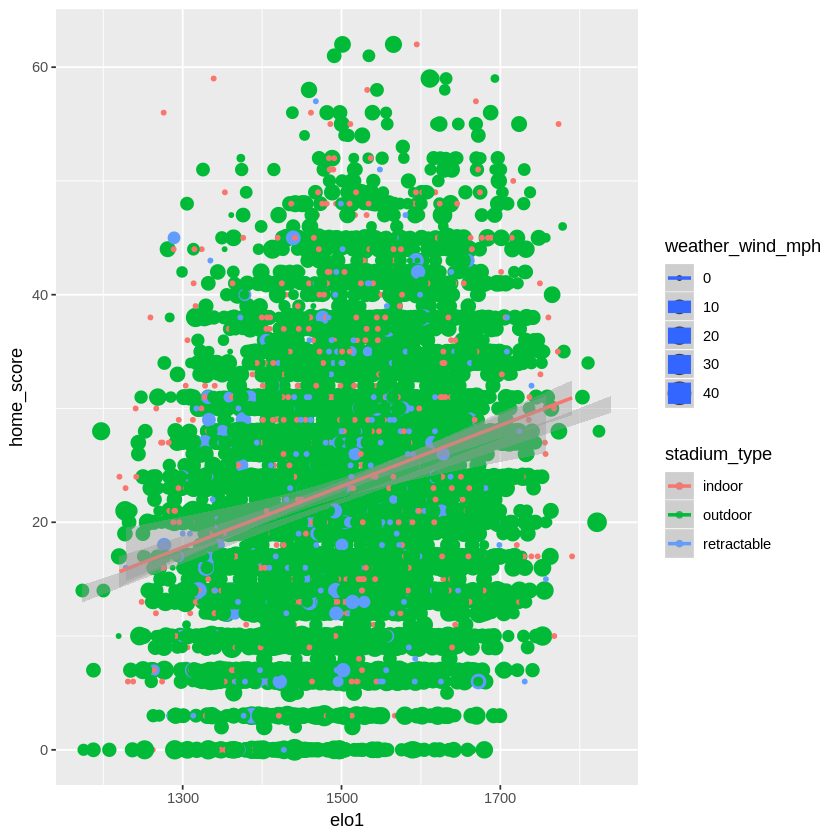

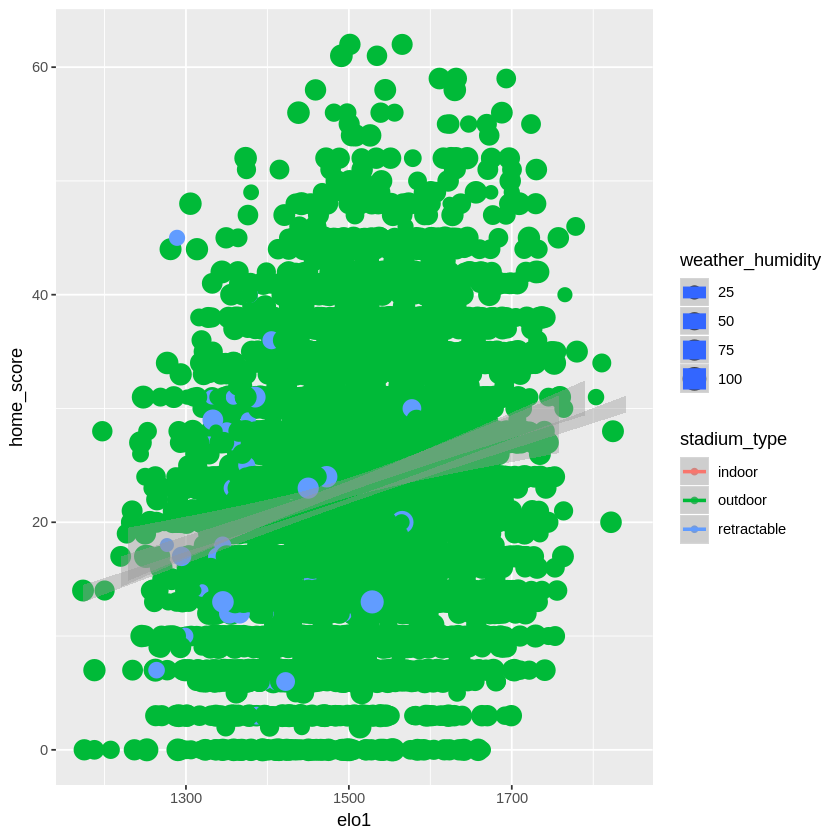

In [26]:
## Scatterplot of elo1, home_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again wind speed seems to have a large affect on home score and elo1 but there are still quite a few games played in
## low wind speeds than resulted in lower home scores and elo1 scores.

ggplot(stadium_type, aes(x=elo1,y=home_score, color = stadium_type, size = weather_temperature)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=home_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=home_score, color = stadium_type, size = weather_humidity)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

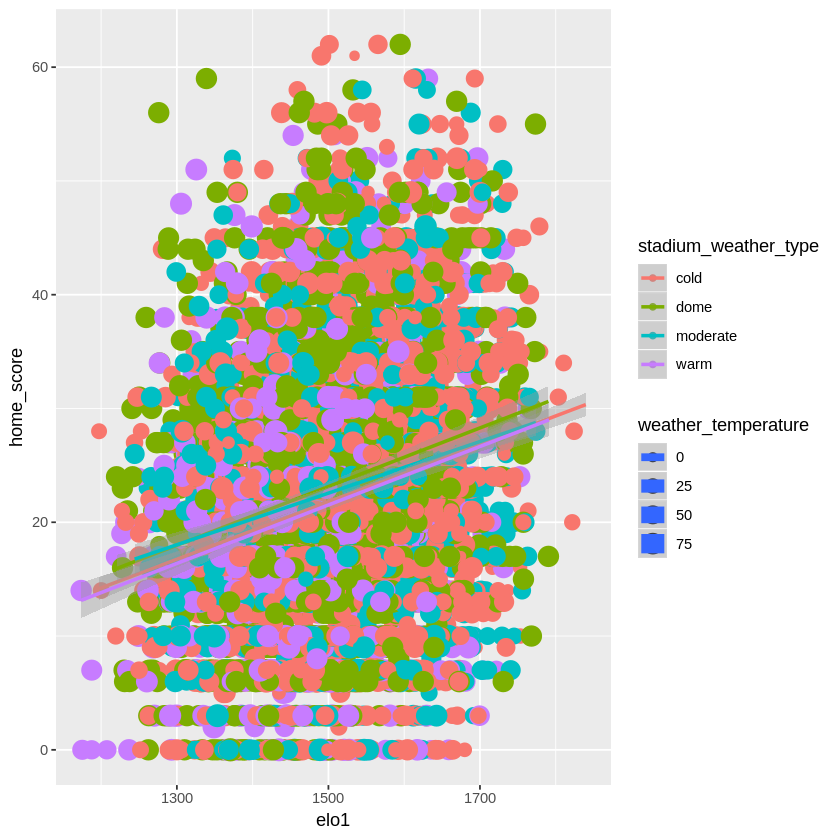

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

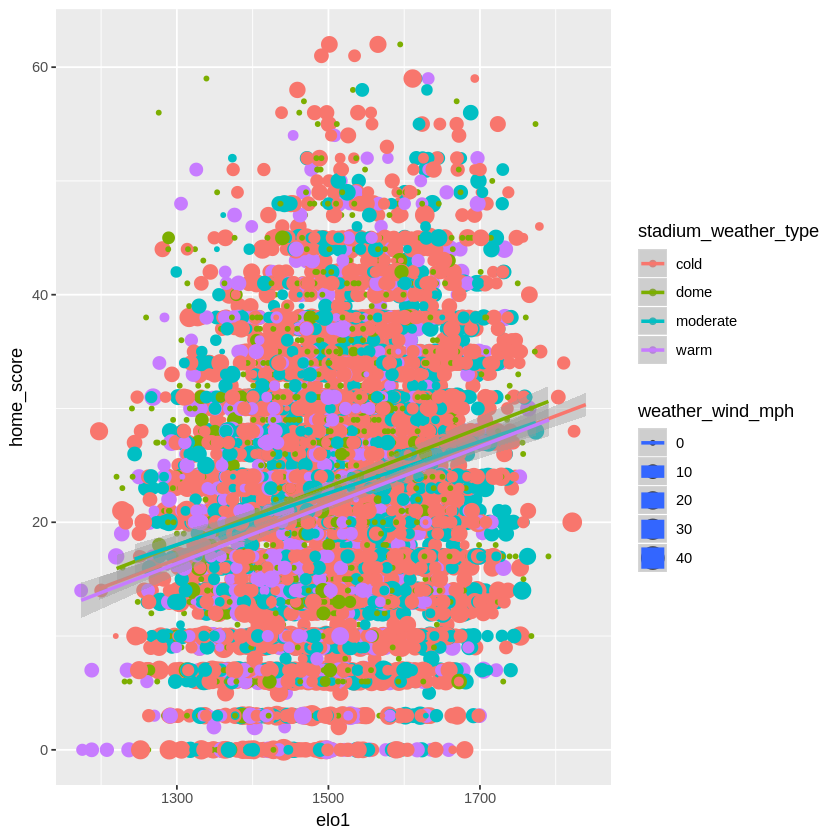

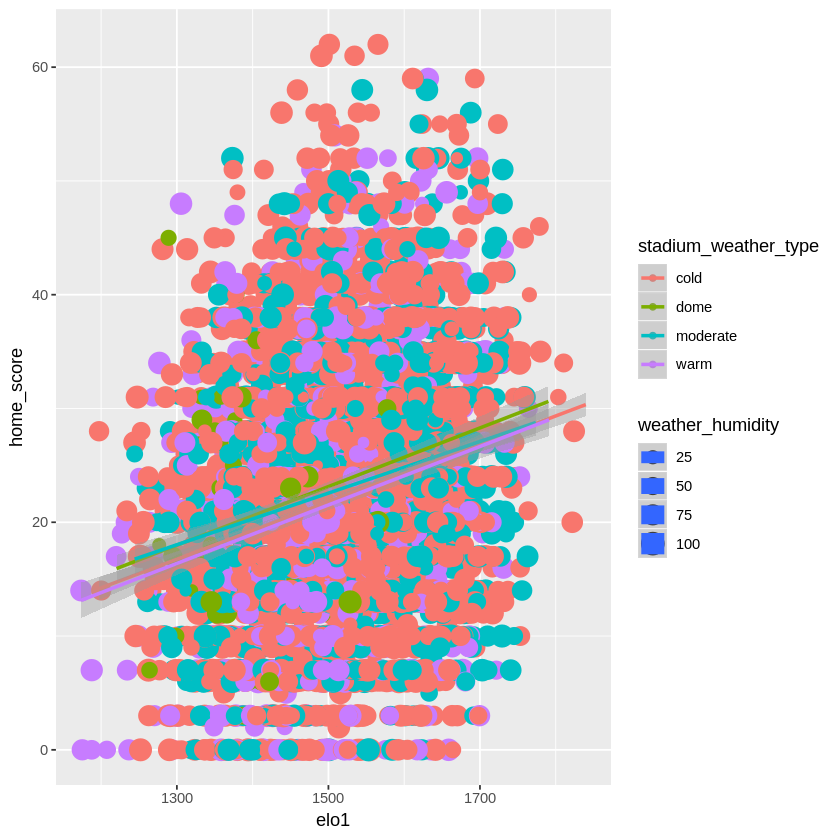

In [27]:
## Scatterplot of elo1, home_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The pattern holds when looking at stadium_weather_type.  More games with higher home scores and elo1 scores have lower
## wind speeds than games with lower homes score and elo1 scores.

ggplot(stadium_weather_type, aes(x=elo1,y=home_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=home_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=home_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo1") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 566 rows containing missing values (geom_point).”

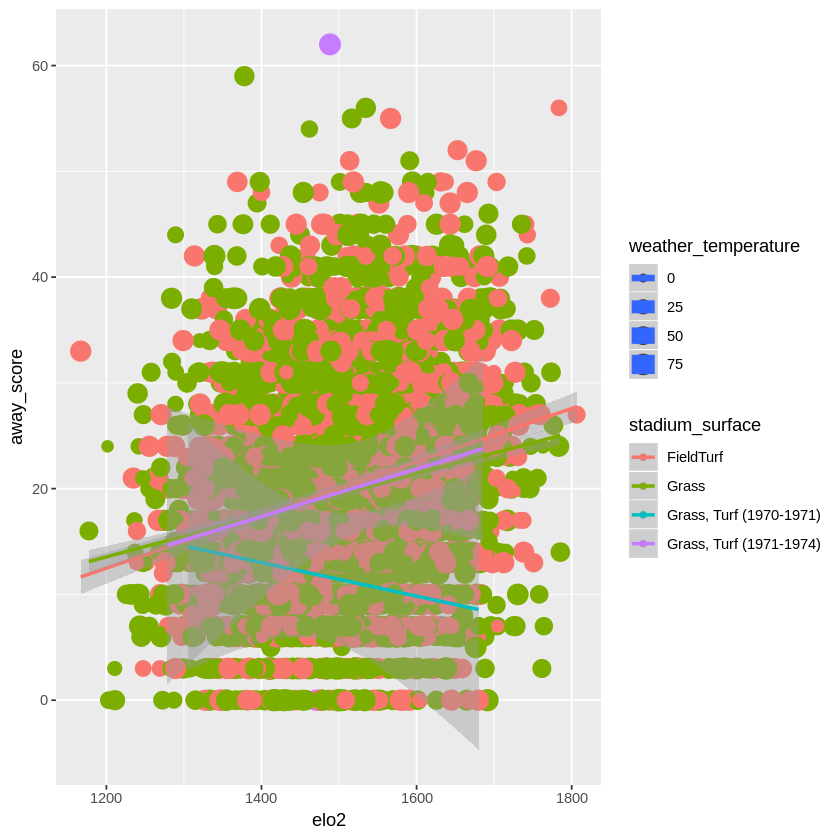

Warning message:
“Removed 426 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2377 rows containing missing values (geom_point).”

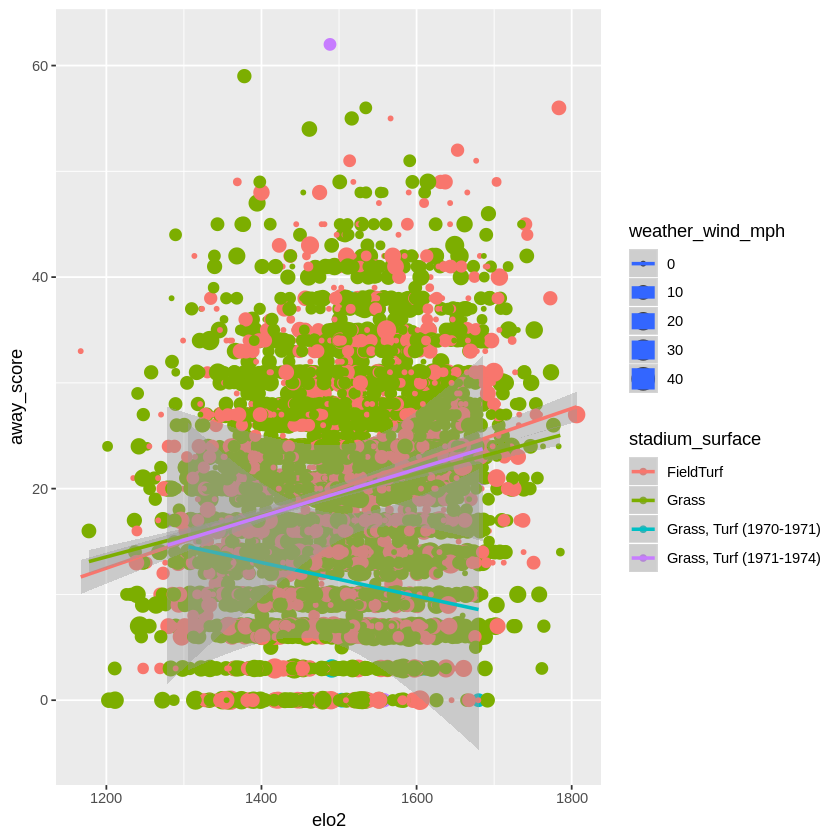

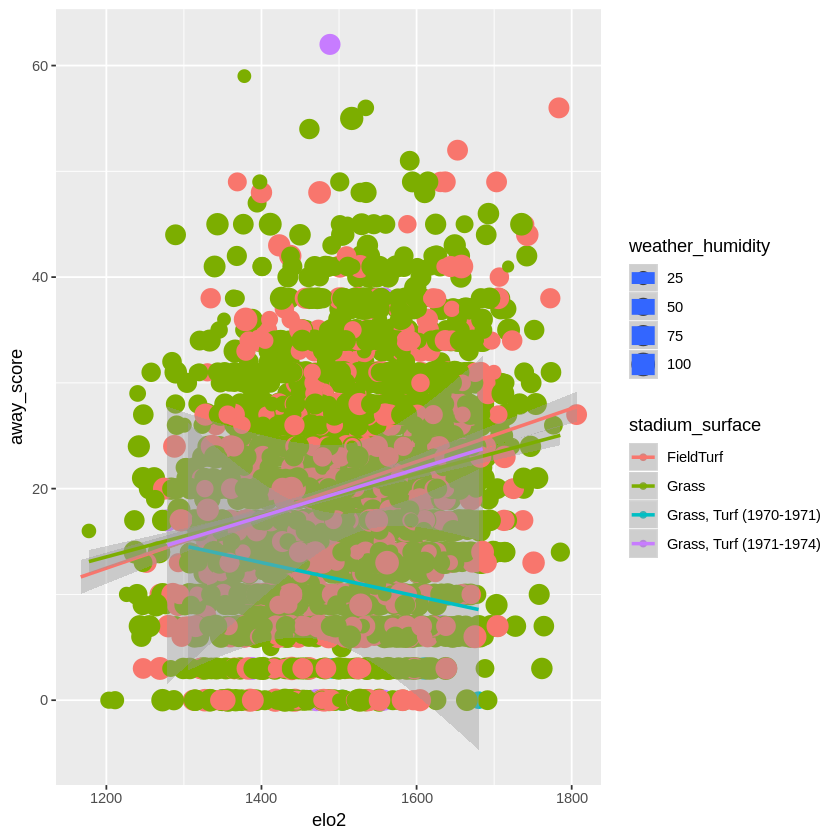

In [28]:
## Scatterplot of elo2, away_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The same is true when looking at stadium surfaces.  More games with higher home scores and elo1 scores have lower
## wind speeds than games with lower homes score and elo1 scores.

ggplot(stadium_surface, aes(x=elo2,y=away_score, color = stadium_surface, size = weather_temperature)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=away_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=away_score, color = stadium_surface, size = weather_humidity)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

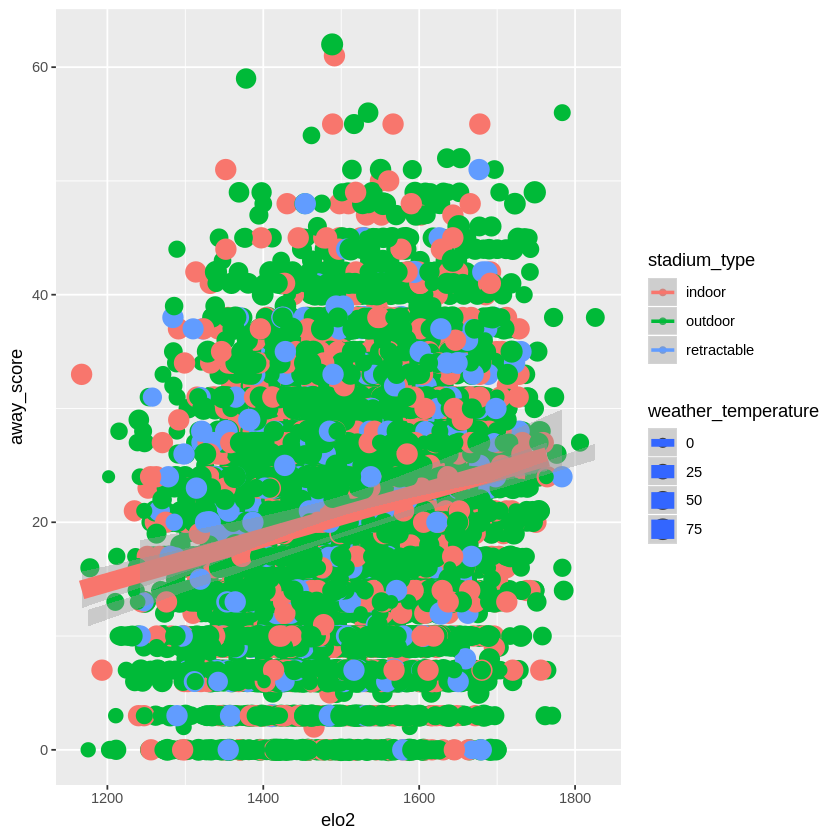

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

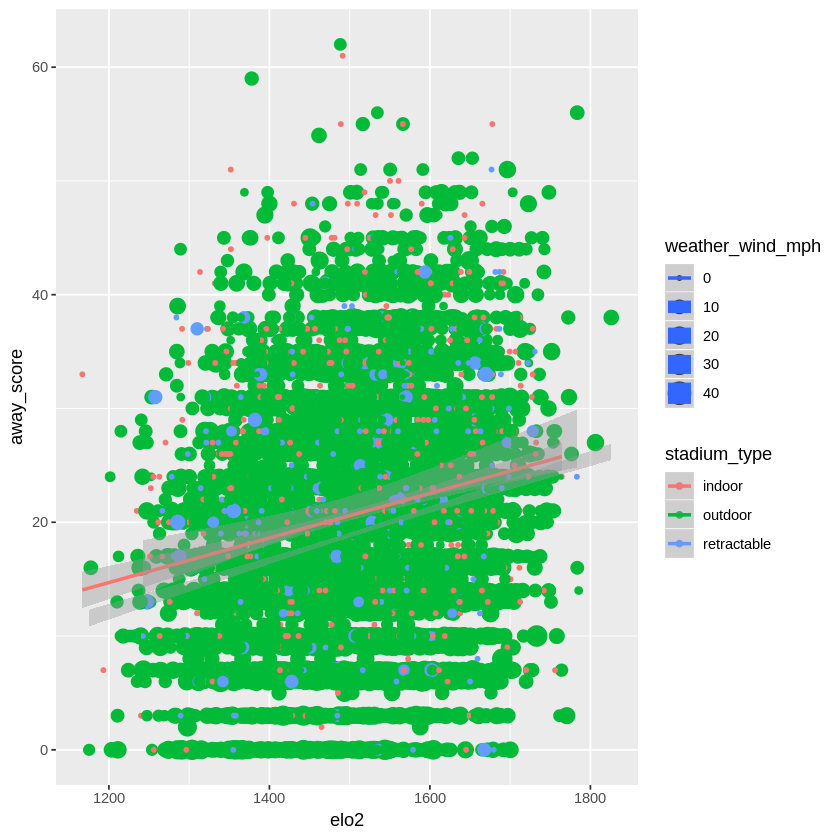

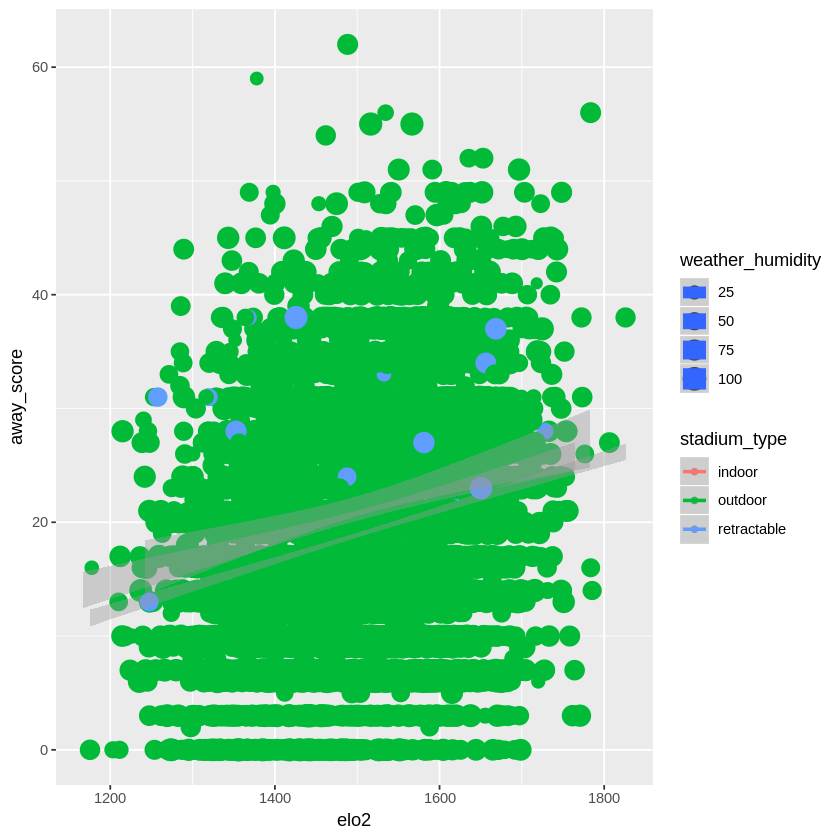

In [29]:
## Scatterplot of elo2, away_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Wind speeds seems to be the winner when looking at elo2 in relation to away scores for stadium types.  Games with lower wind
## speeds produce higher score gaming for both the homes and away team.  As as result, the elo2 score which is the away team
## rating is higher in games with calm weather.

ggplot(stadium_type, aes(x=elo2,y=away_score, color = stadium_type, size = weather_temperature)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=away_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=away_score, color = stadium_type, size = weather_humidity)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1156 rows containing missing values (geom_point).”

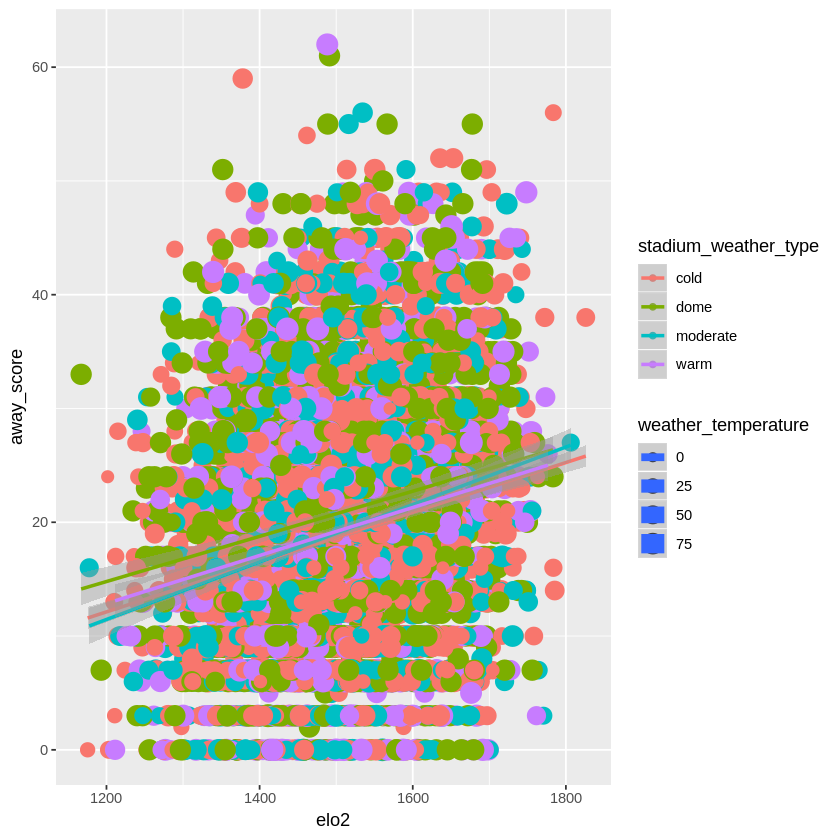

Warning message:
“Removed 891 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 4221 rows containing missing values (geom_point).”

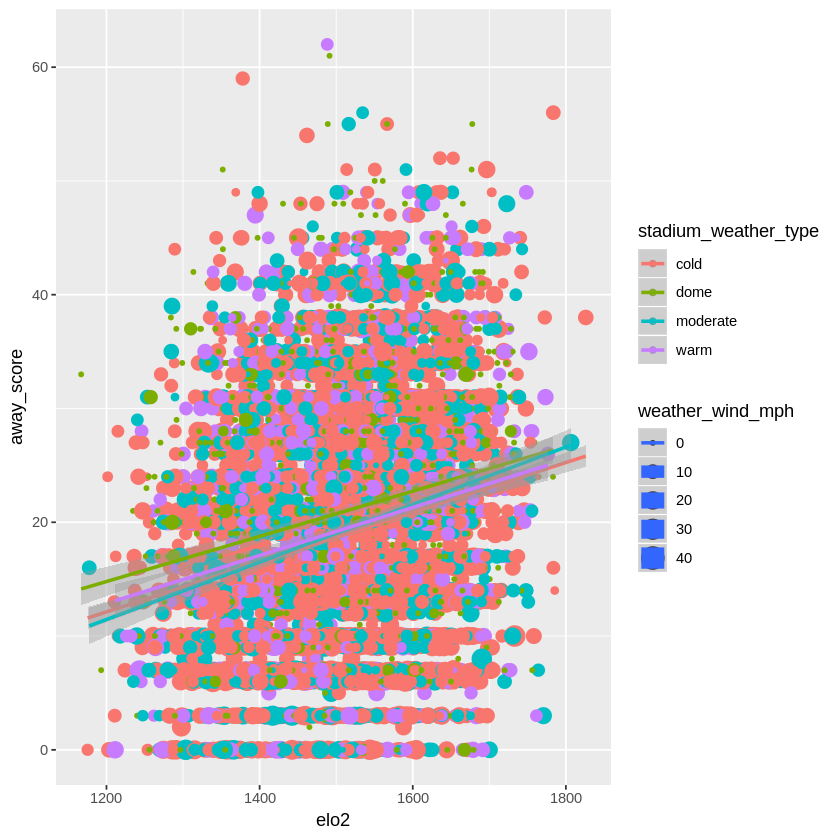

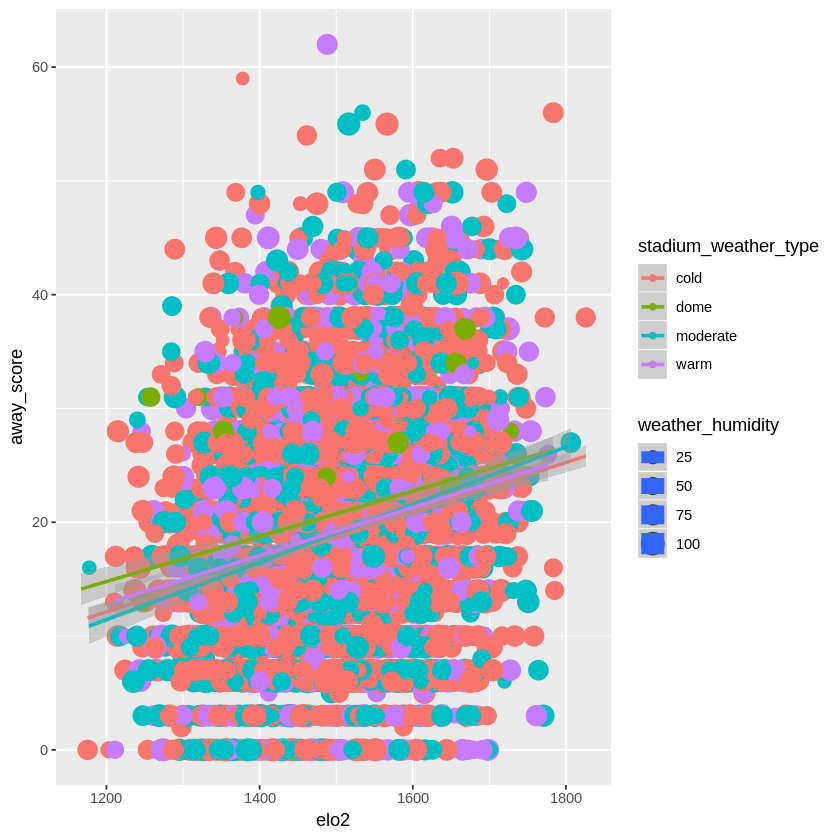

In [30]:
## Scatterplot of elo2, away_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Again, lower wind speeds seems to translate into higher elo2 and away scores when across stadium_weather_types.

ggplot(stadium_weather_type, aes(x=elo2,y=away_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=away_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=away_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo2") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”

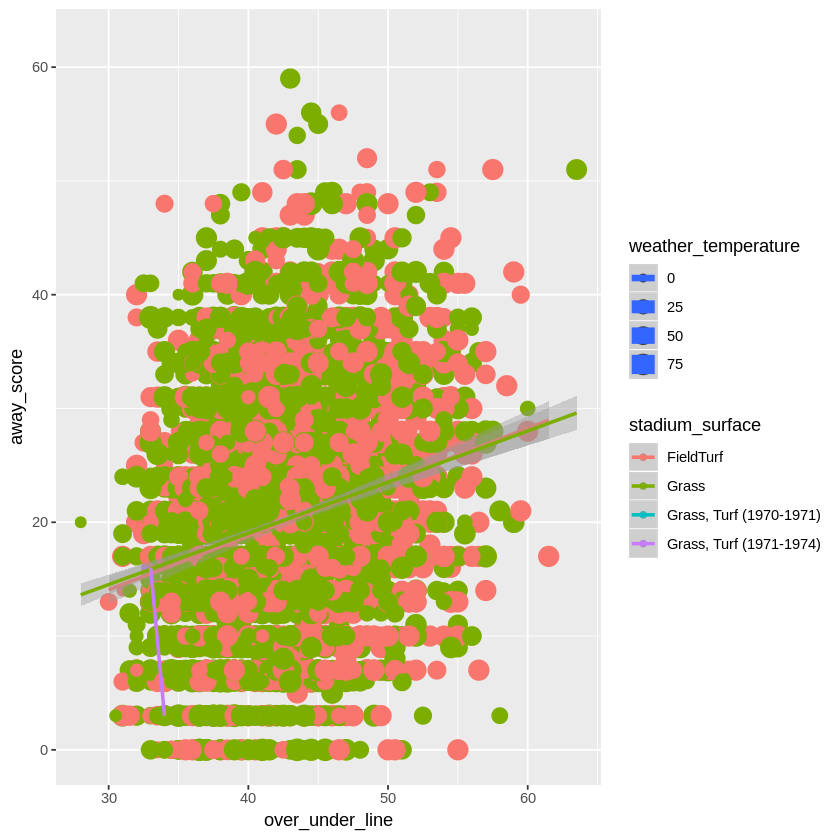

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 2882 rows containing missing values (geom_point).”

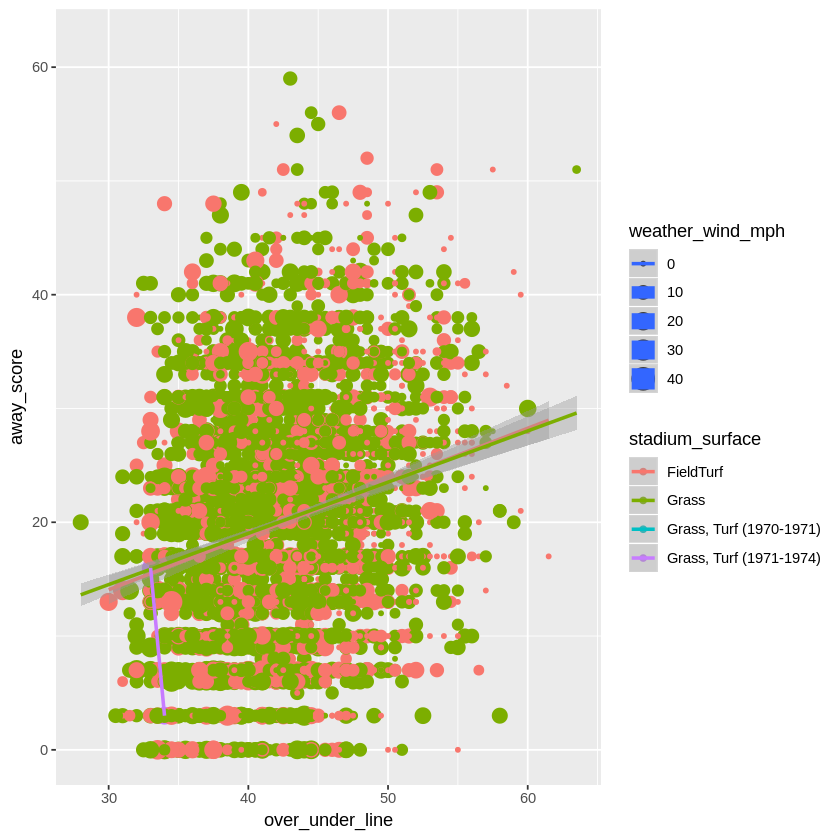

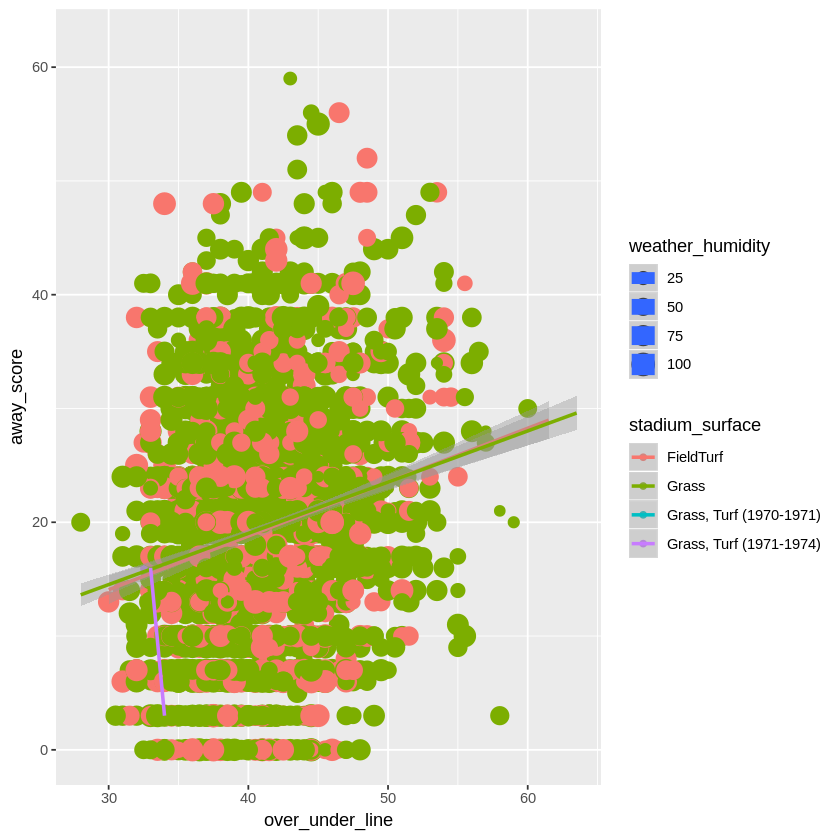

In [31]:
## Scatterplot of over_under_line, away_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Lower wind speeds are present in games with higer over under lines and
## higher away score, although, we see quite a few games with lower away scores and lower wind speeds but higher over under
## lines.

ggplot(stadium_surface, aes(x=over_under_line,y=away_score, color = stadium_surface, size = weather_temperature)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=over_under_line,y=away_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=over_under_line,y=away_score, color = stadium_surface, size = weather_humidity)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

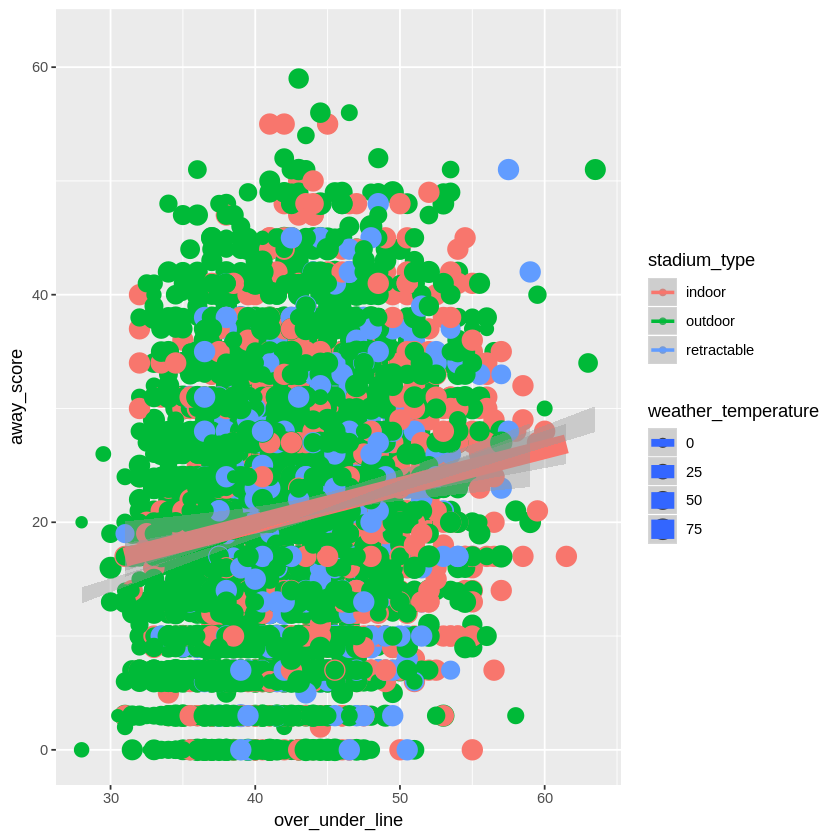

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

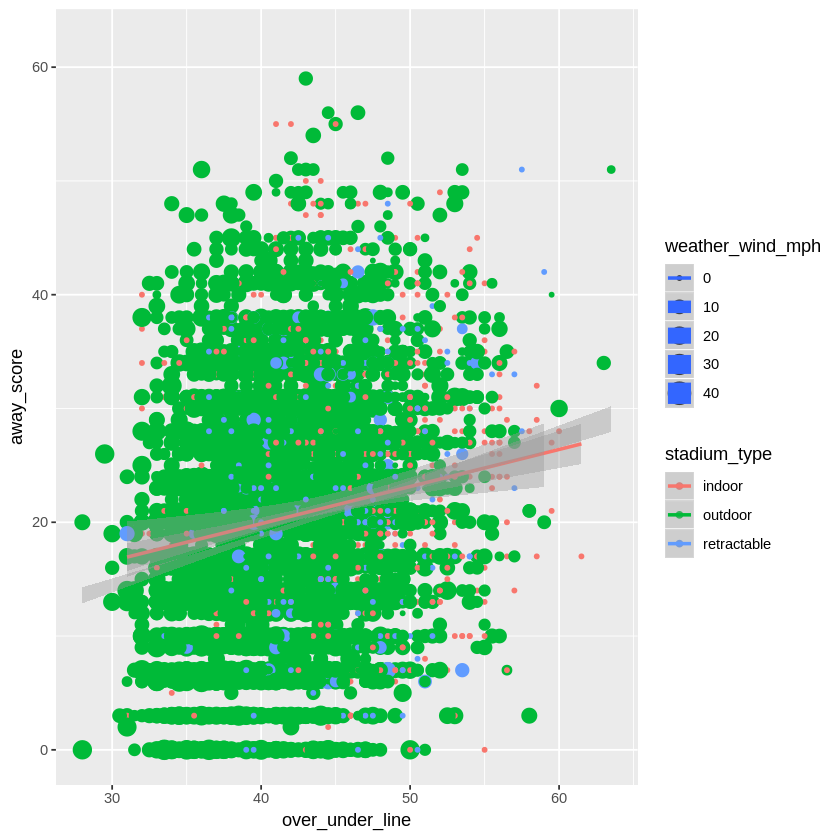

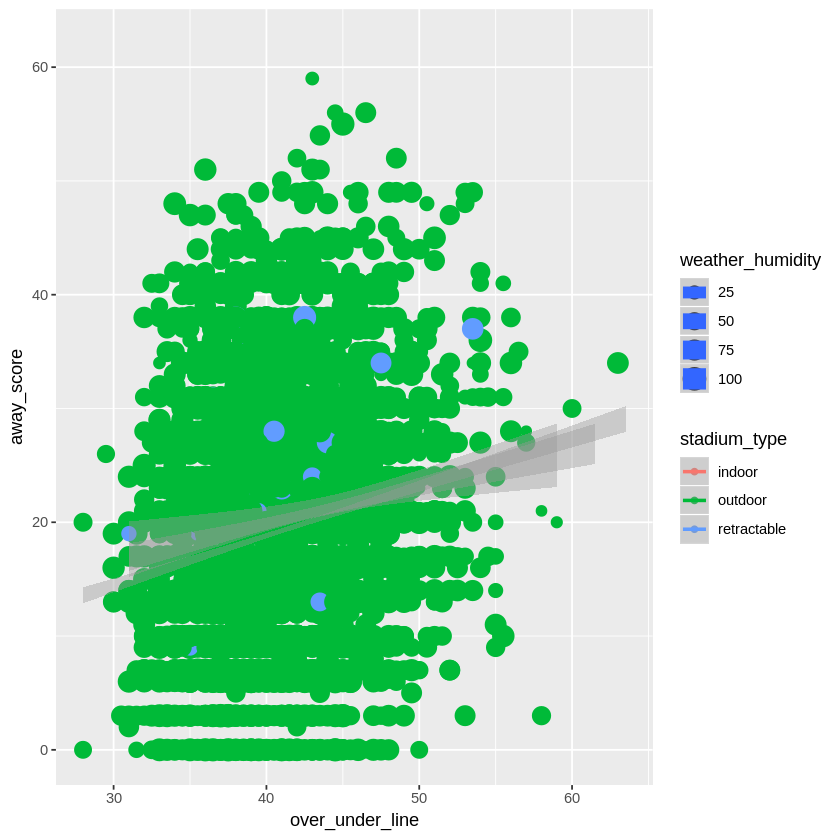

In [32]:
## Scatterplot of over_under_line, away_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The same is true when looking at our weather data across stadium_types.  Lower wind speeds are present in games with higher
## away scores and higher over under lines.  Calmer games likely translate into higher scoring games for both teams.

ggplot(stadium_type, aes(x=over_under_line,y=away_score, color = stadium_type, size = weather_temperature)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=over_under_line,y=away_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=over_under_line,y=away_score, color = stadium_type, size = weather_humidity)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

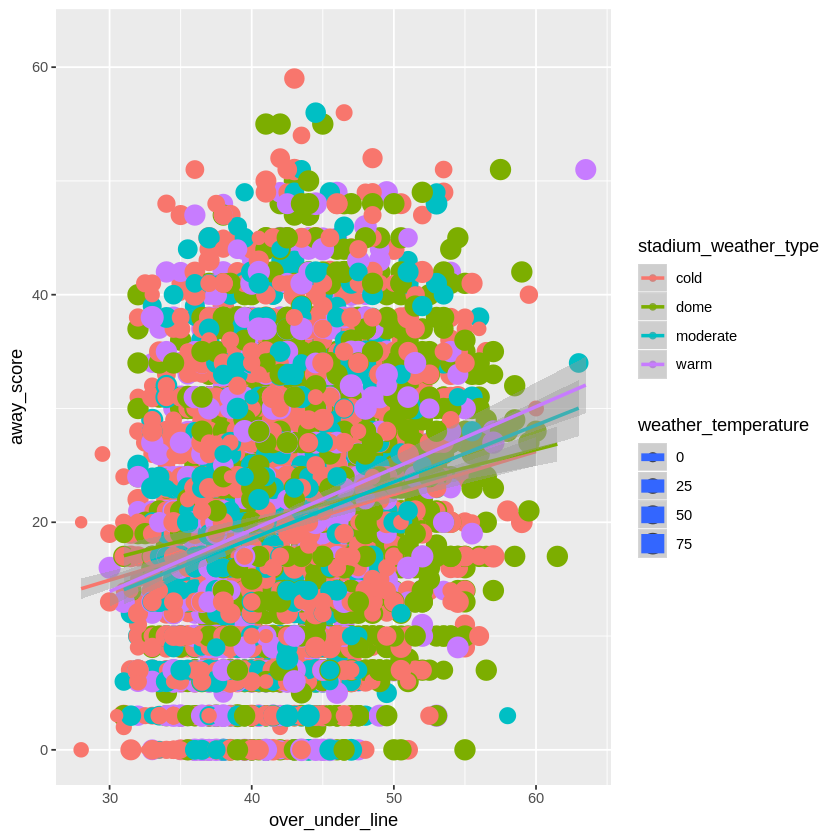

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

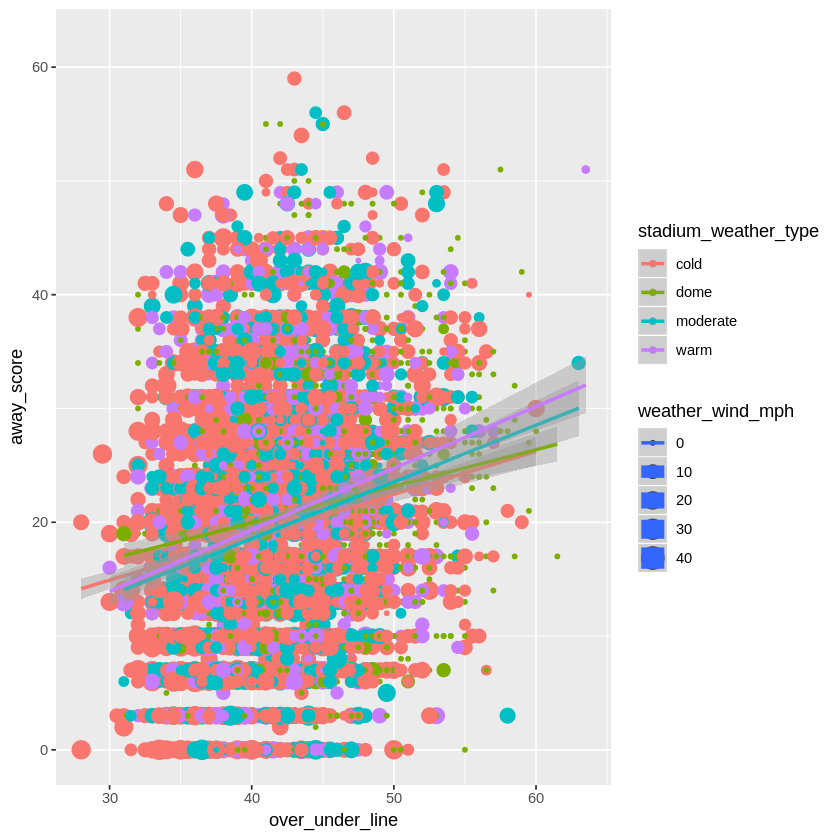

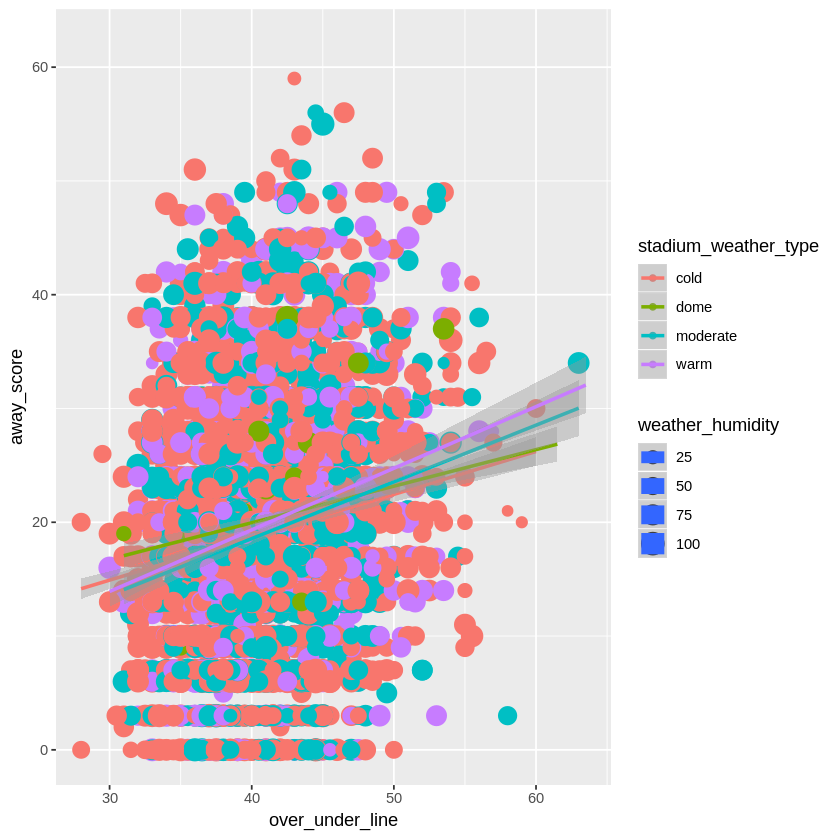

In [33]:
## Scatterplot of over_under_line, away_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, & 
## weather_humidity

## The same is true when looking at stadium_weather_types.  Game in calmer environments (lower wind speeds) produce games 
## with higher away scores and over under lines. 

ggplot(stadium_weather_type, aes(x=over_under_line,y=away_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=over_under_line,y=away_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=over_under_line,y=away_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("over_under_line") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 791 rows containing missing values (geom_point).”

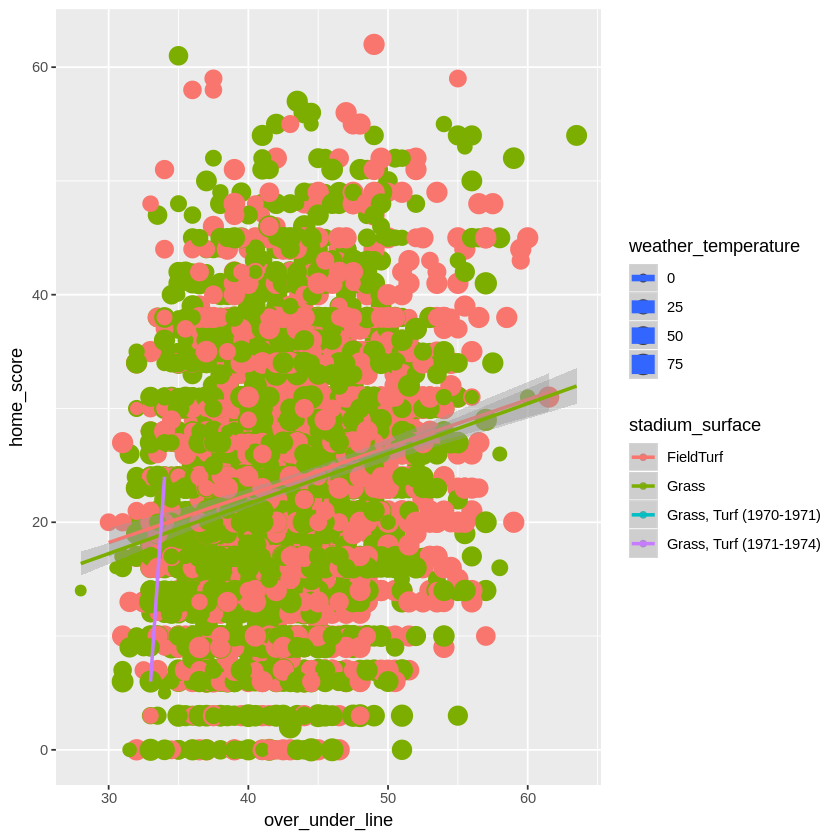

Warning message:
“Removed 653 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 2882 rows containing missing values (geom_point).”

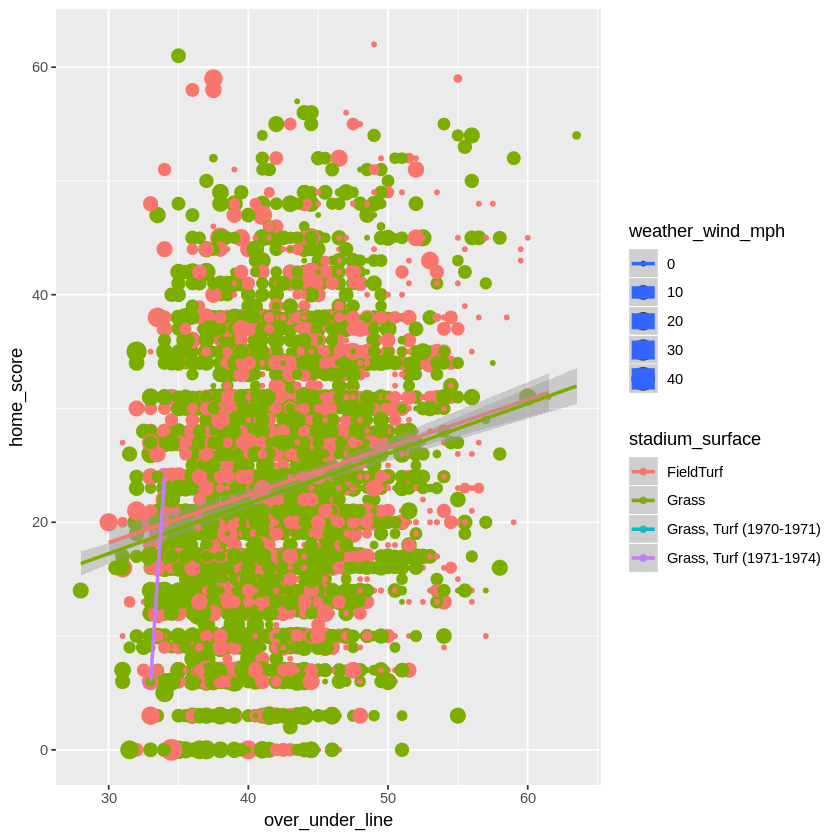

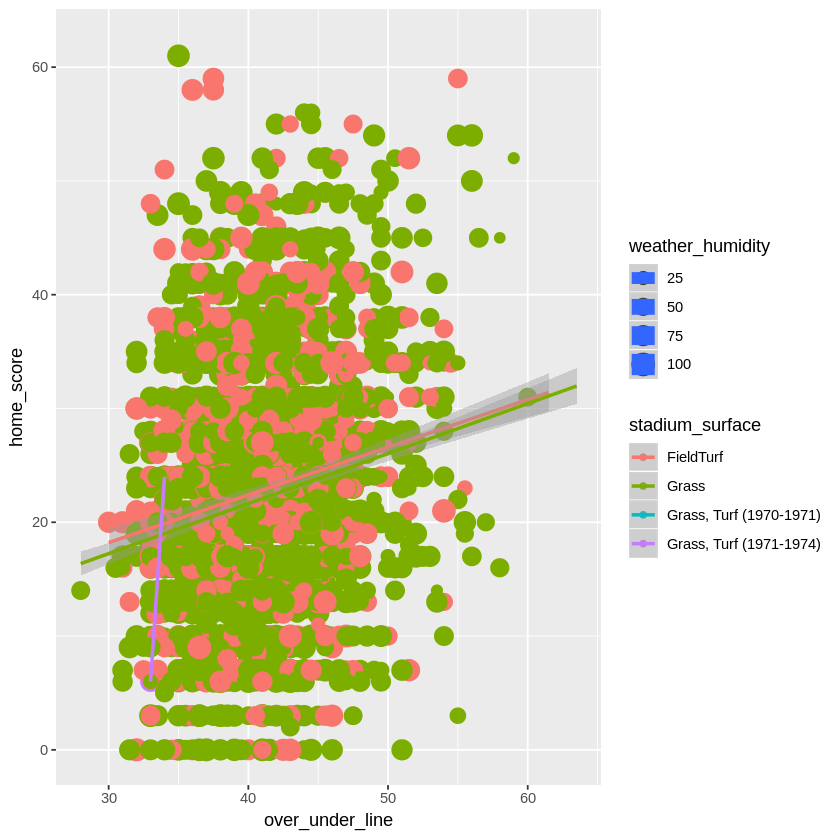

In [34]:
## Scatterplot of over_under_line, home_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Unsuprisingly, wind speed wins out again when looking at stadiums surfaces.  Games with lower wind speeds are also games 
## with higher homes score and higher over under lines.

ggplot(stadium_surface, aes(x=over_under_line,y=home_score, color = stadium_surface, size = weather_temperature)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=over_under_line,y=home_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=over_under_line,y=home_score, color = stadium_surface, size = weather_humidity)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

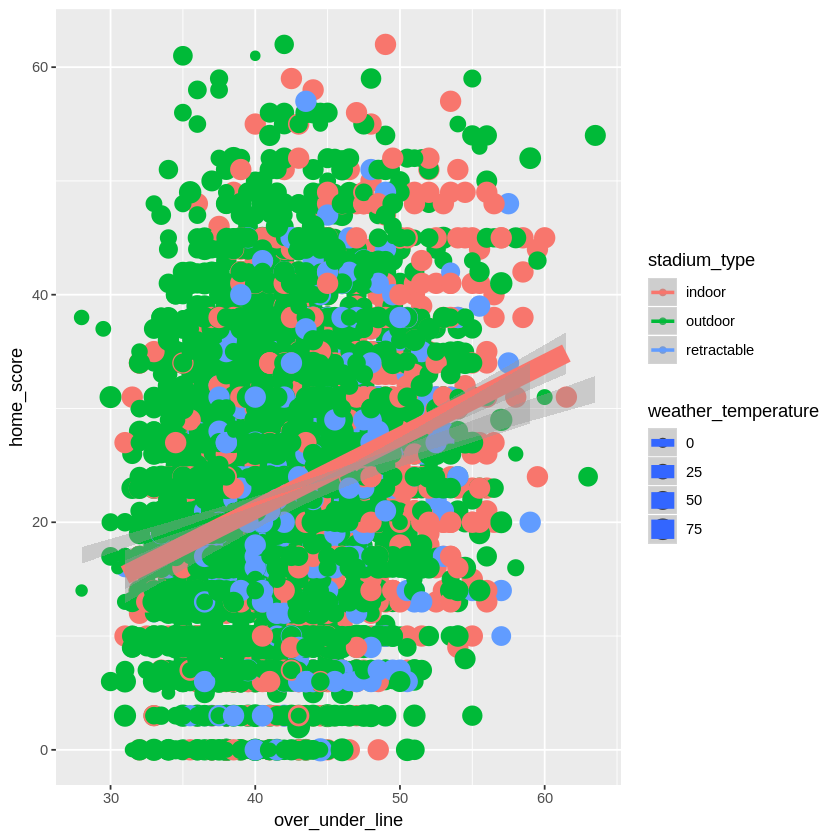

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

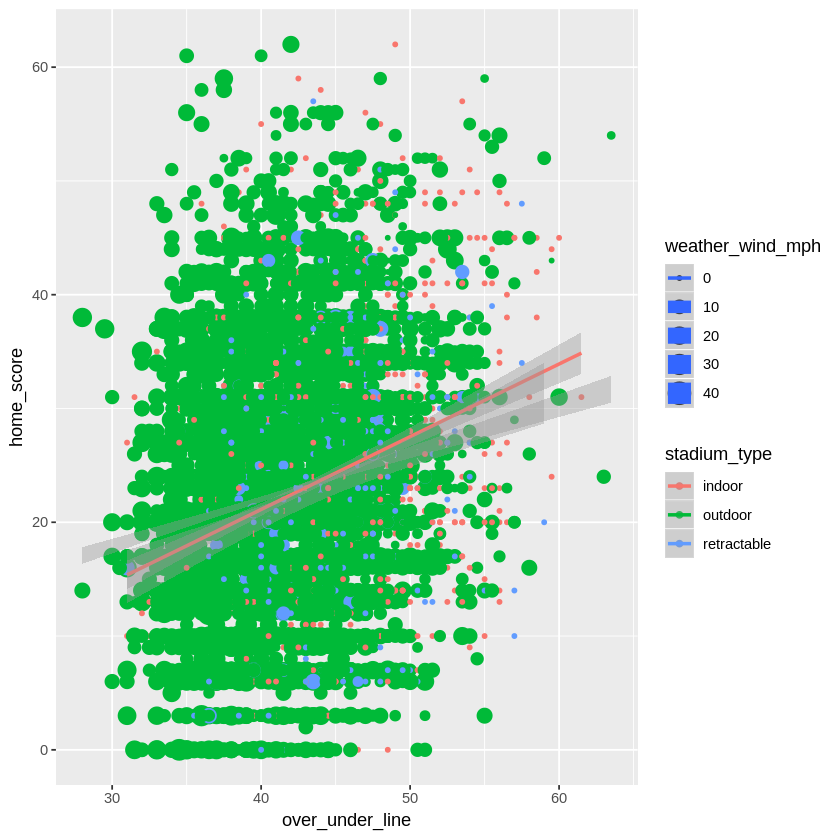

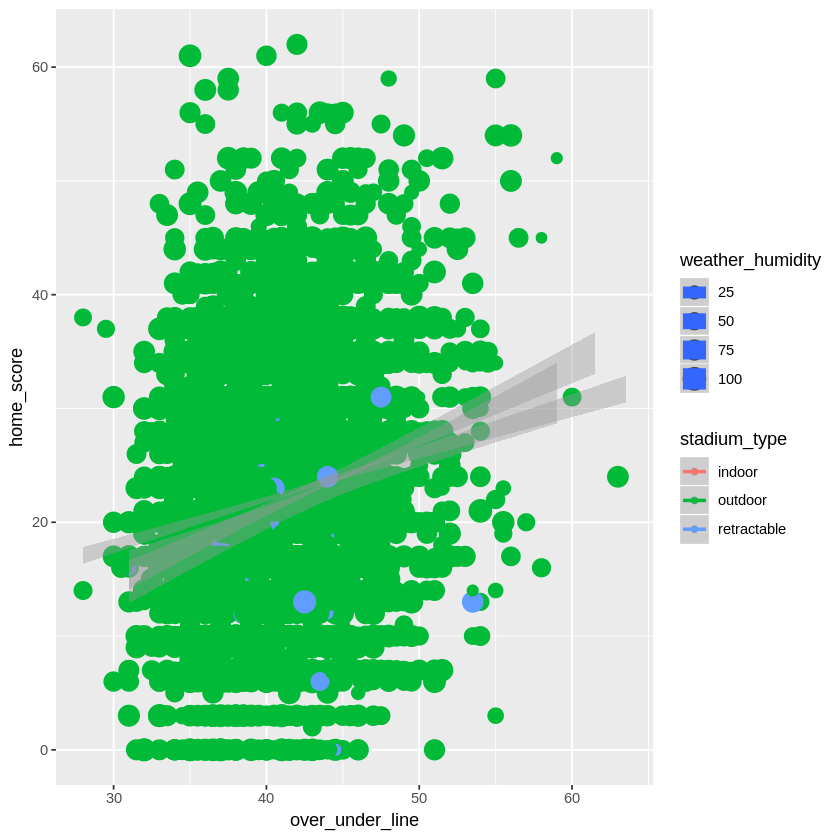

In [35]:
## Scatterplot of over_under_line, home_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The same is true when looking at stadium types.  Games played in lower wind speed are games with higher home scores and 
## higher over under lines.

ggplot(stadium_type, aes(x=over_under_line,y=home_score, color = stadium_type, size = weather_temperature)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=over_under_line,y=home_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=over_under_line,y=home_score, color = stadium_type, size = weather_humidity)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2060 rows containing missing values (geom_point).”

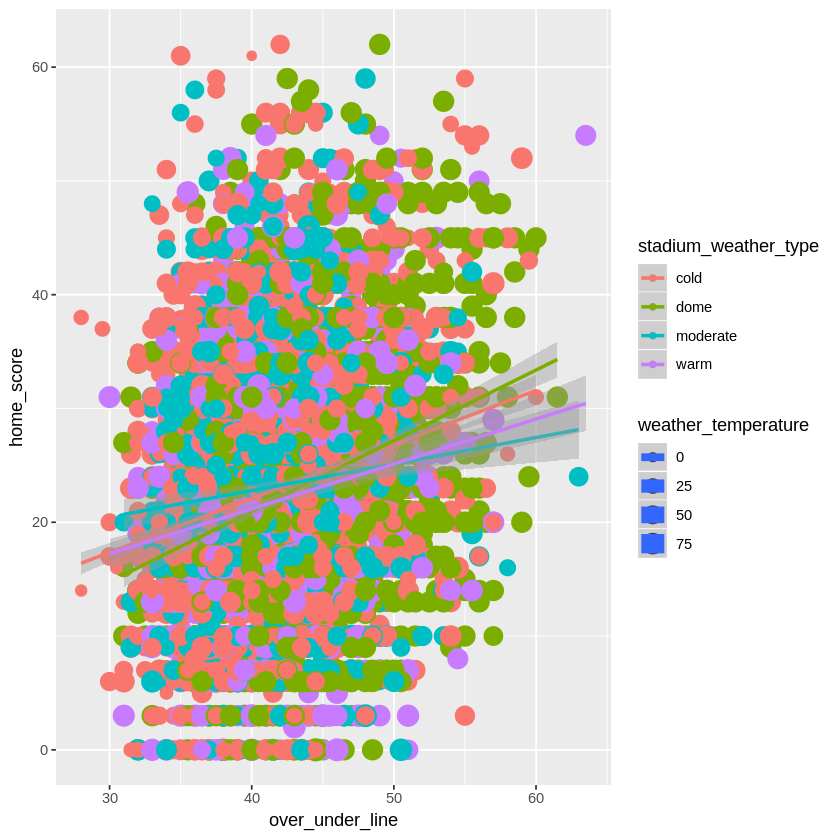

Warning message:
“Removed 1826 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5329 rows containing missing values (geom_point).”

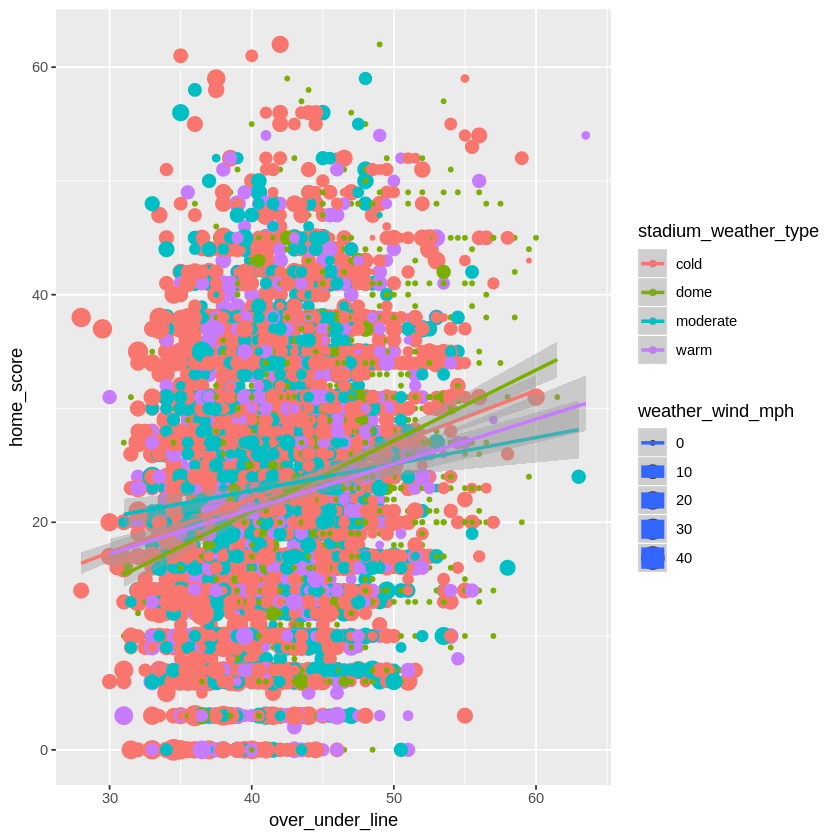

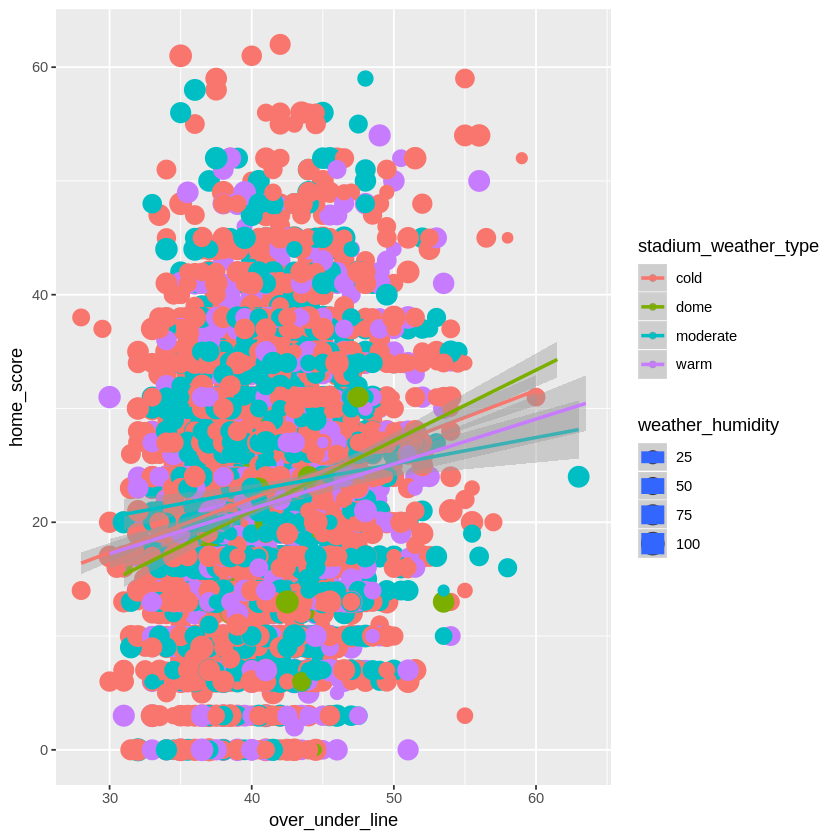

In [36]:
## Scatterplot of over_under_line, home_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, & 
## weather_humidity

## And the same is true when looking at stadium_weather_types.  Games played in lower wind speed are games with higher home 
## scores and higher over under lines.

ggplot(stadium_weather_type, aes(x=over_under_line,y=home_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=over_under_line,y=home_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=over_under_line,y=home_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("over_under_line") + ylab("home_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 639 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 789 rows containing missing values (geom_point).”Warning message:
“Removed 639 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 789 rows containing missing values (geom_point).”

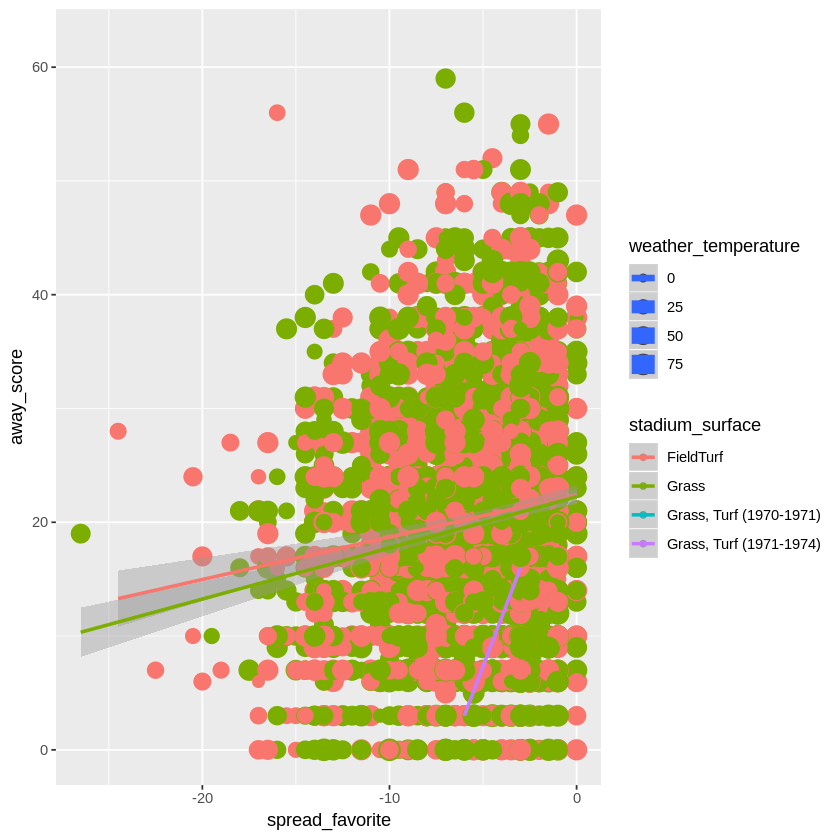

Warning message:
“Removed 639 rows containing non-finite values (stat_smooth).”Warning message in qt((1 - level)/2, df):
“NaNs produced”Warning message:
“Removed 2880 rows containing missing values (geom_point).”

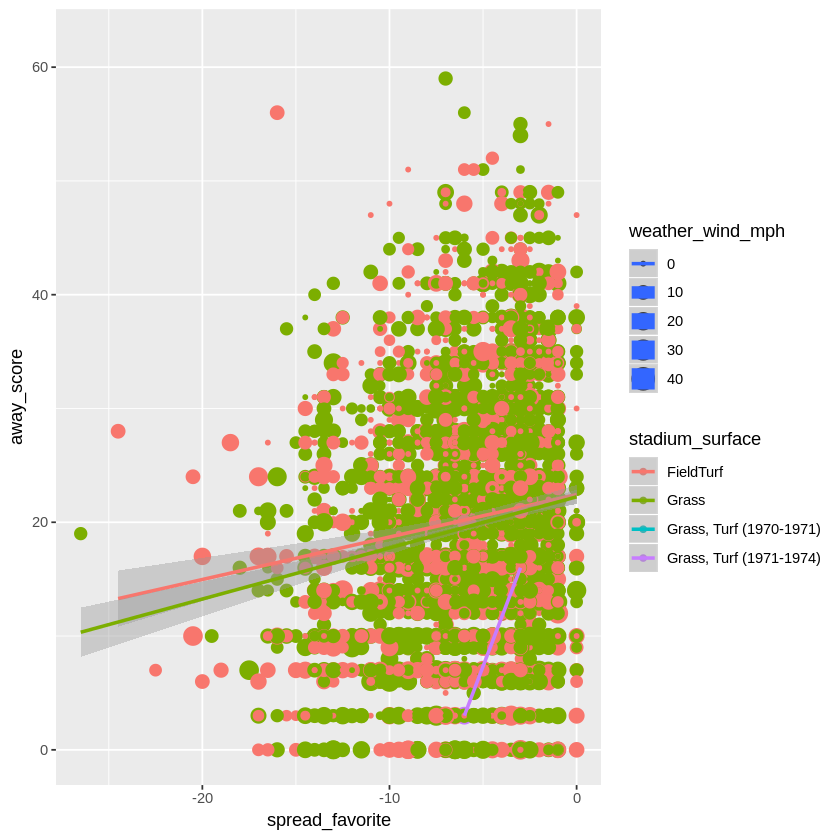

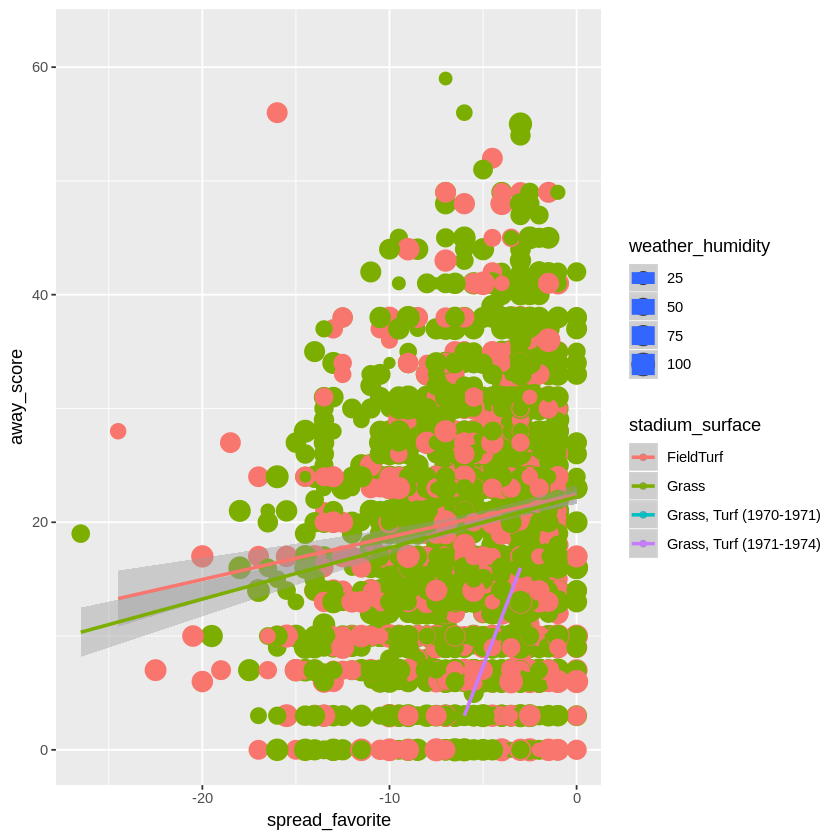

In [43]:
## Scatterplot of spread_favorite, away_score, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Here we see wind speed win out yet again.  Games with lower speeds seems to group at higher away scores and lower spreads
## The lower the spread the more evenly matched the teams which could produce higher score for either team.

ggplot(stadium_surface, aes(x=spread_favorite,y=away_score, color = stadium_surface, size = weather_temperature)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=spread_favorite,y=away_score, color = stadium_surface, size = weather_wind_mph)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=spread_favorite,y=away_score, color = stadium_surface, size = weather_humidity)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2047 rows containing missing values (geom_point).”Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2047 rows containing missing values (geom_point).”

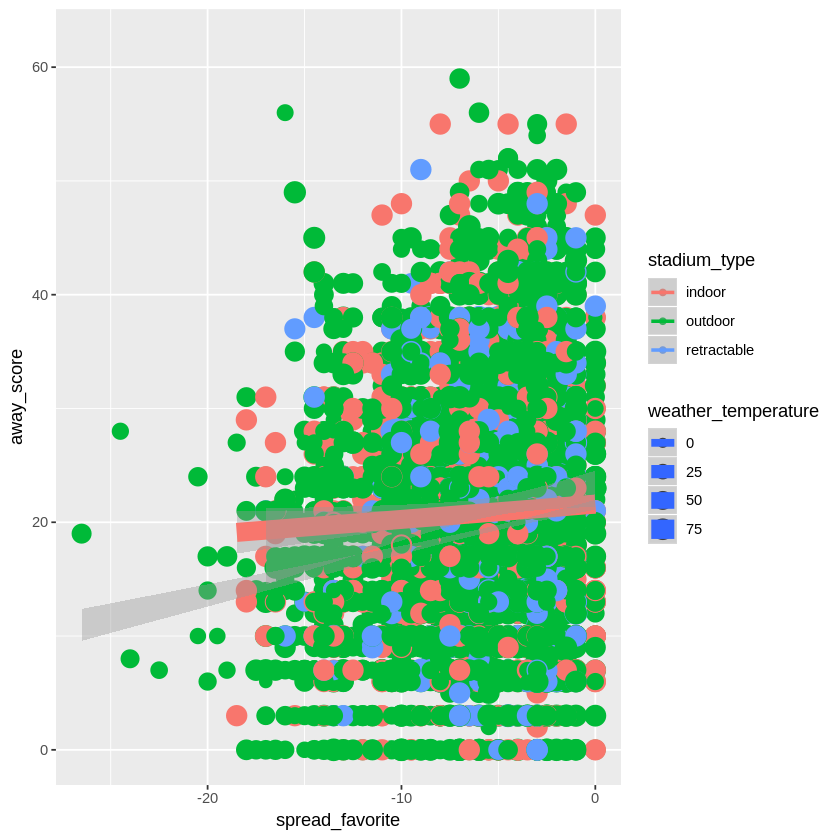

Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5320 rows containing missing values (geom_point).”

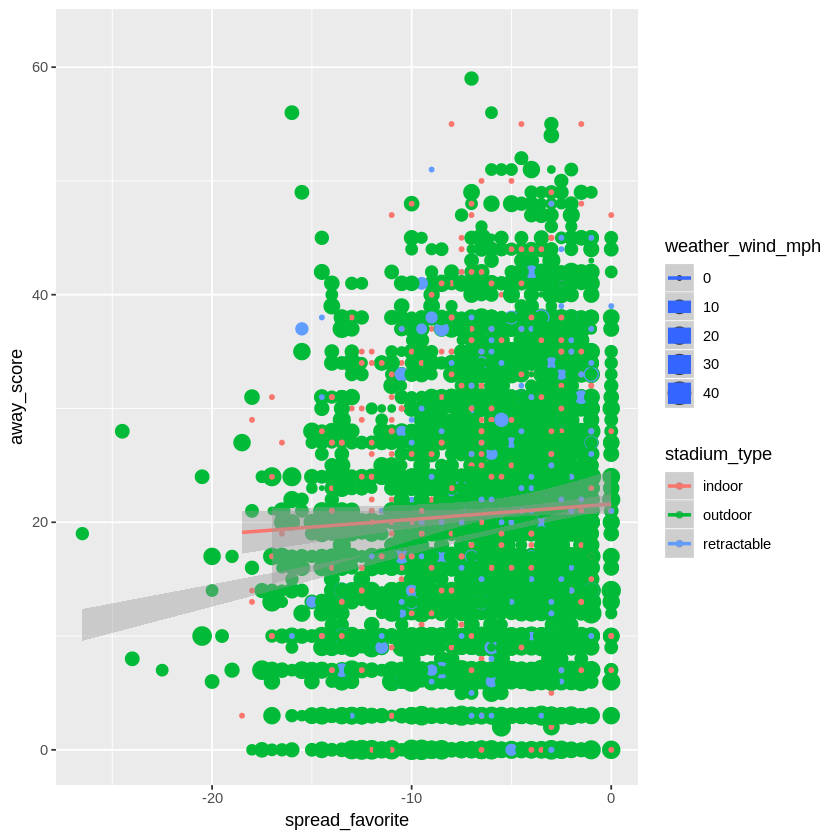

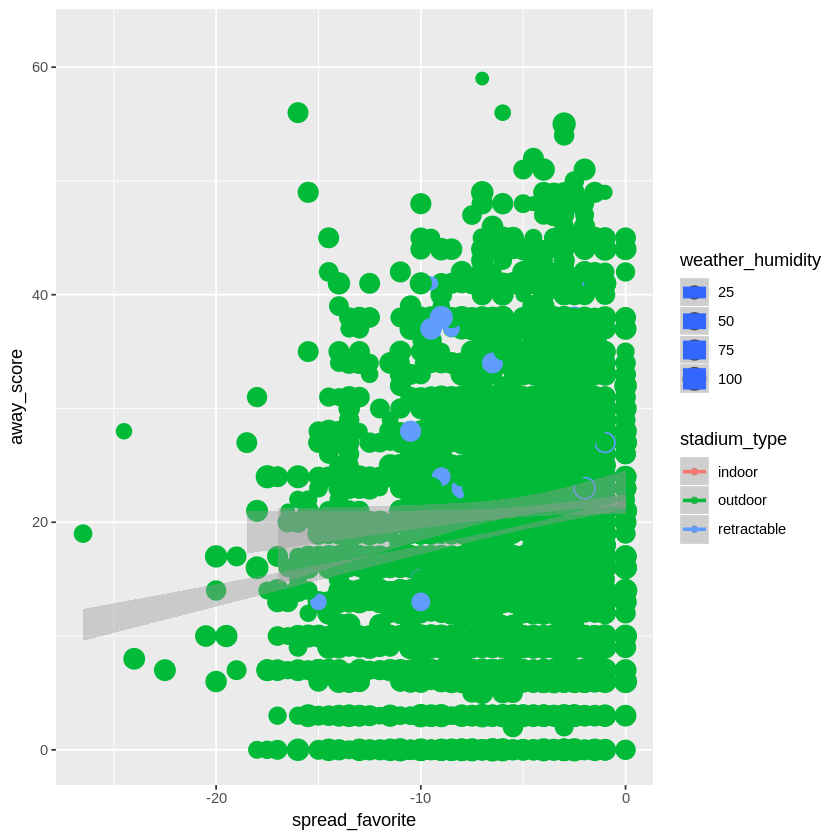

In [44]:
## Scatterplot of spread_favorite, away_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The above is true as well when looking at the weather data across stadium_types.  Wind speeds win out again.

ggplot(stadium_type, aes(x=spread_favorite,y=away_score, color = stadium_type, size = weather_temperature)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=spread_favorite,y=away_score, color = stadium_type, size = weather_wind_mph)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=spread_favorite,y=away_score, color = stadium_type, size = weather_humidity)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2047 rows containing missing values (geom_point).”Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2047 rows containing missing values (geom_point).”

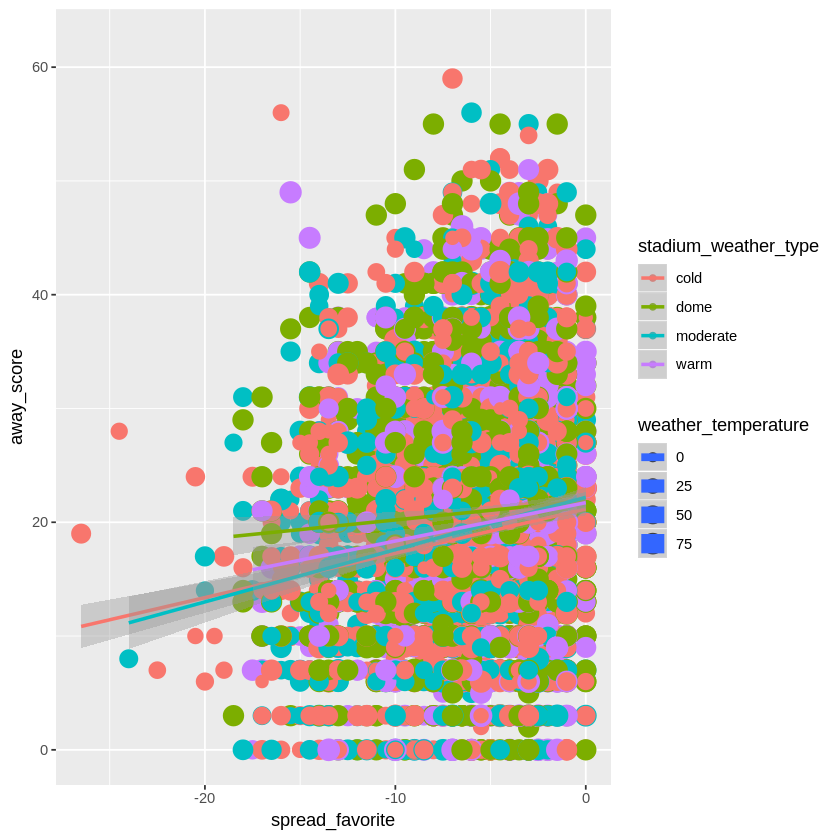

Warning message:
“Removed 1755 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5320 rows containing missing values (geom_point).”

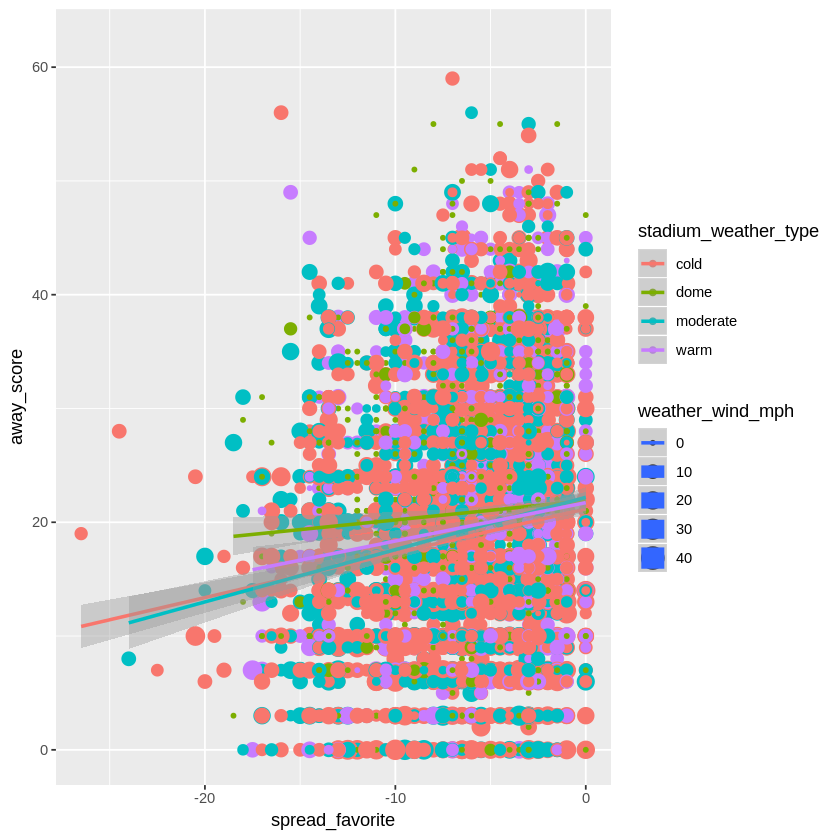

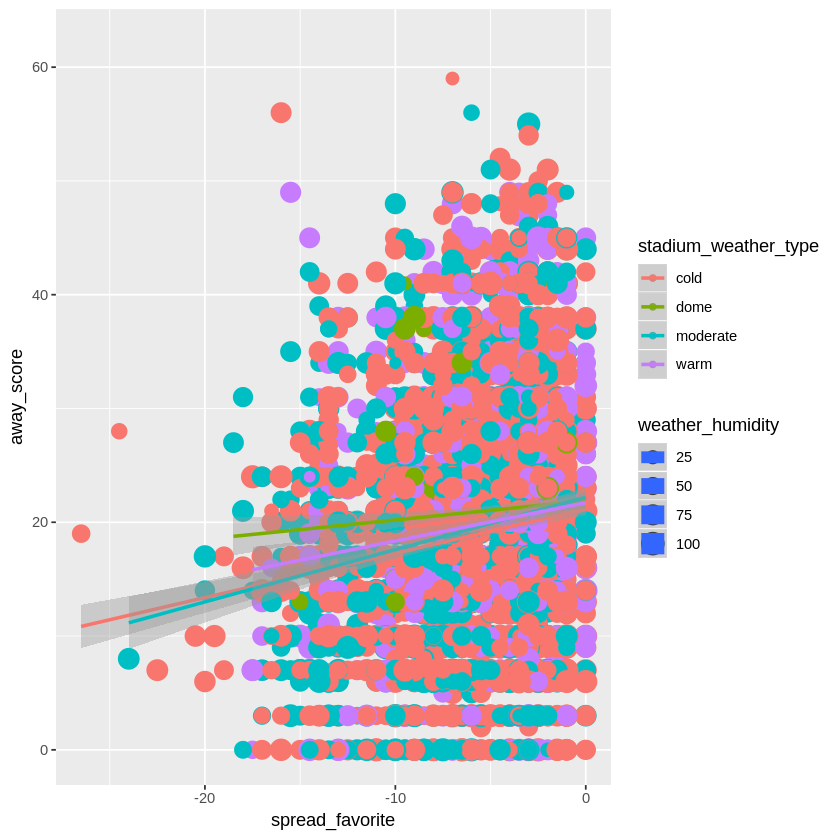

In [45]:
## Scatterplot of spread_favorite, away_score, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, & 
## weather_humidity

## And again.  Lower wind speeds at games with higher away score and lower spreads across stadium_weather_types

ggplot(stadium_weather_type, aes(x=spread_favorite,y=away_score, color = stadium_weather_type, size = weather_temperature)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=spread_favorite,y=away_score, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=spread_favorite,y=away_score, color = stadium_weather_type, size = weather_humidity)) +
    xlab("spread_favorite") + ylab("away_score") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1189 rows containing missing values (geom_point).”Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1189 rows containing missing values (geom_point).”

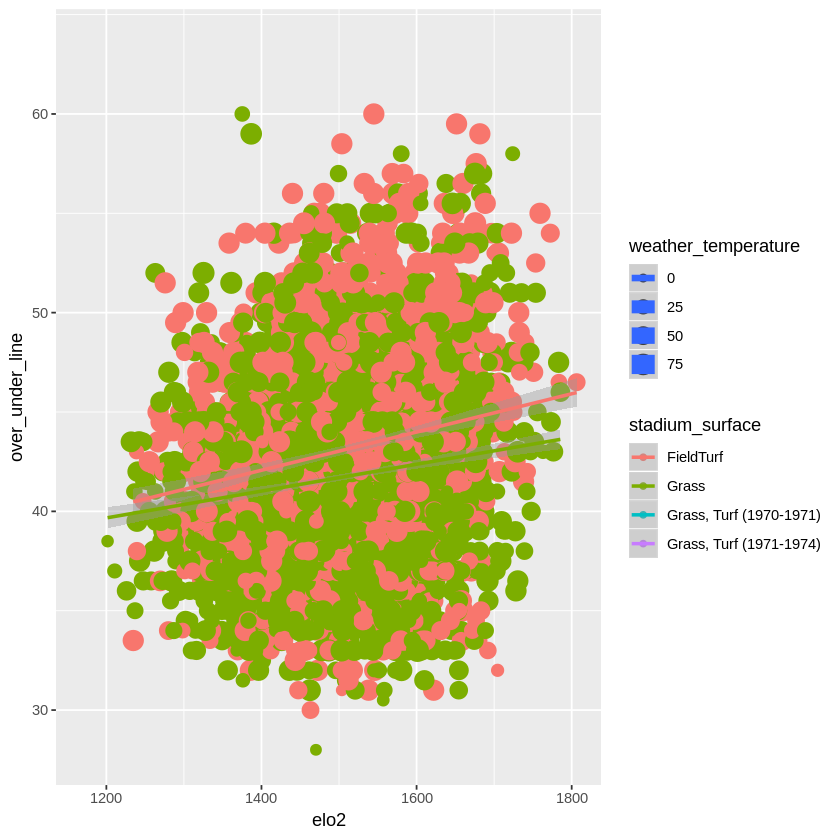

Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2969 rows containing missing values (geom_point).”

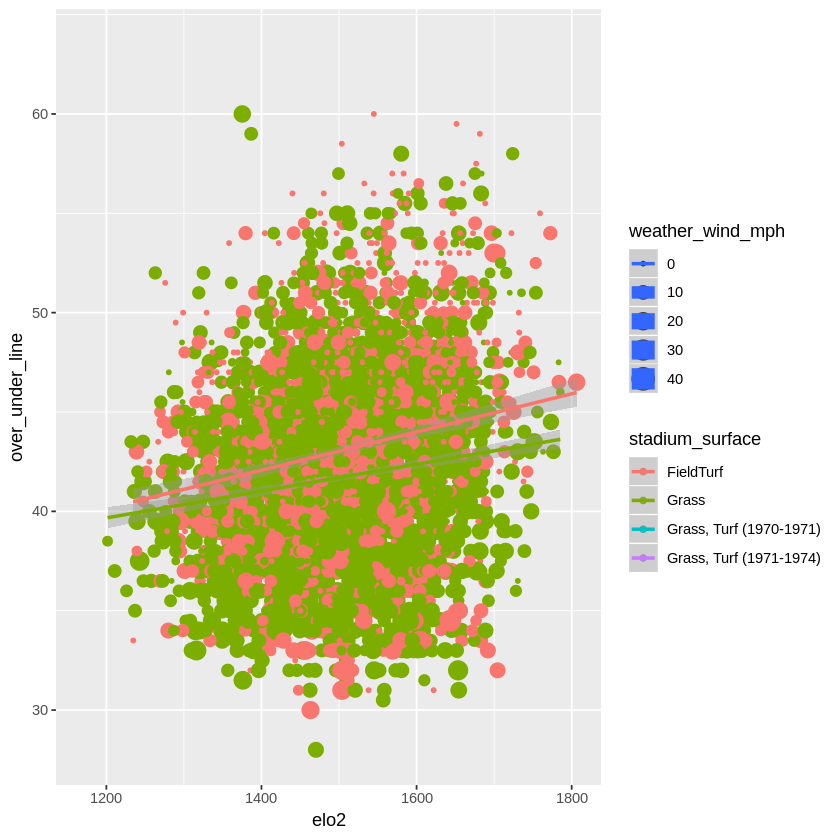

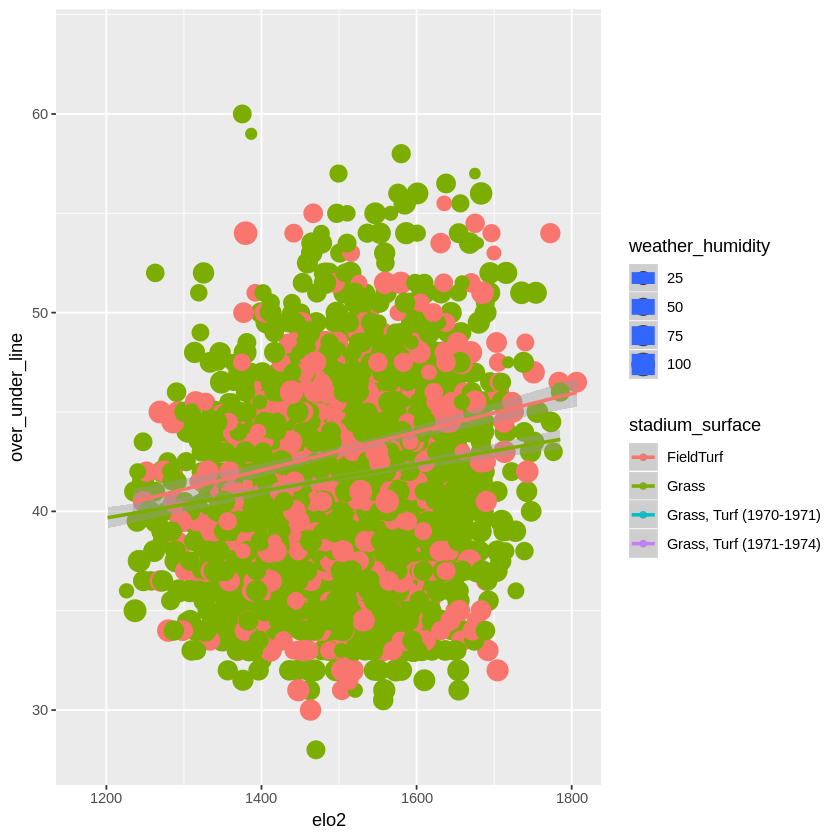

In [49]:
## Scatterplot of elo2, over_under_line, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Yet again we see lower wind speeds present in games with higher elo2 and higher over under lines across stadium_surfaces

ggplot(stadium_surface, aes(x=elo2,y=over_under_line, color = stadium_surface, size = weather_temperature)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=over_under_line, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo2,y=over_under_line, color = stadium_surface, size = weather_humidity)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”

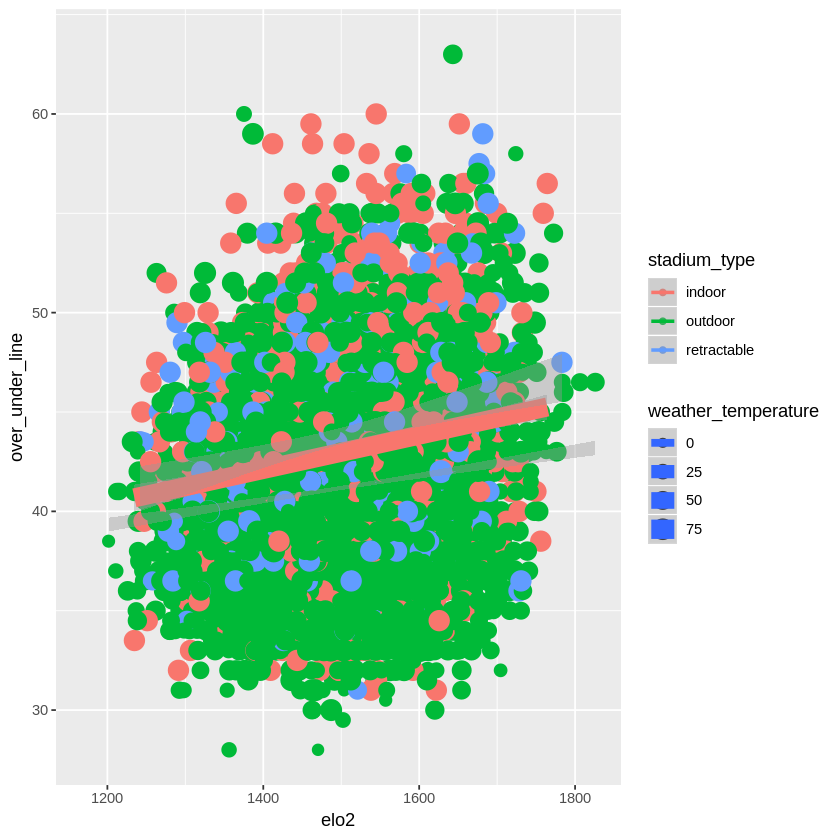

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5706 rows containing missing values (geom_point).”

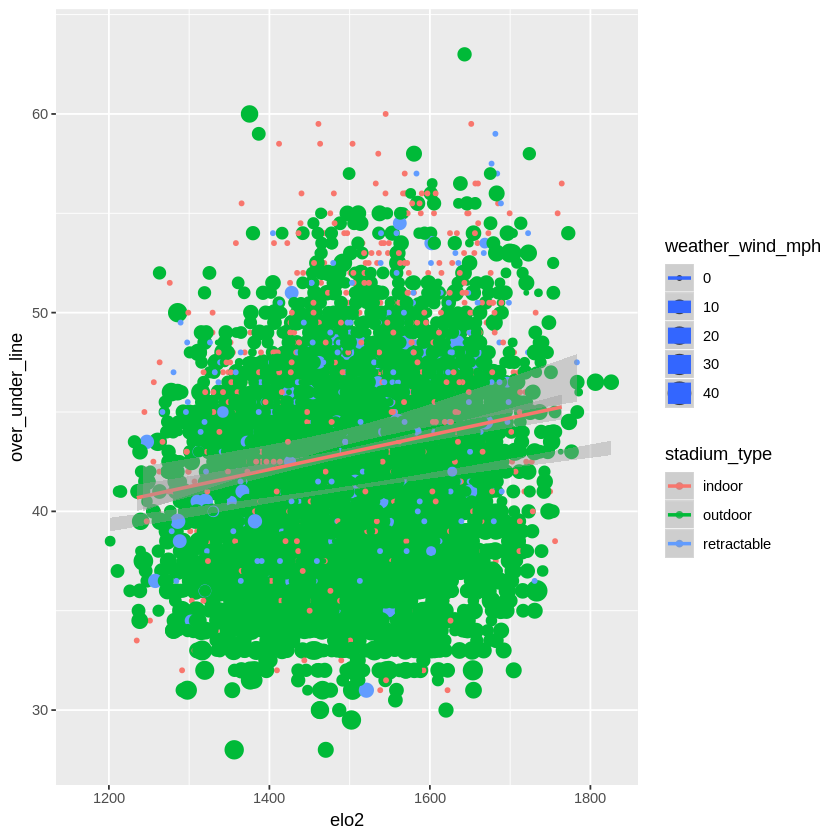

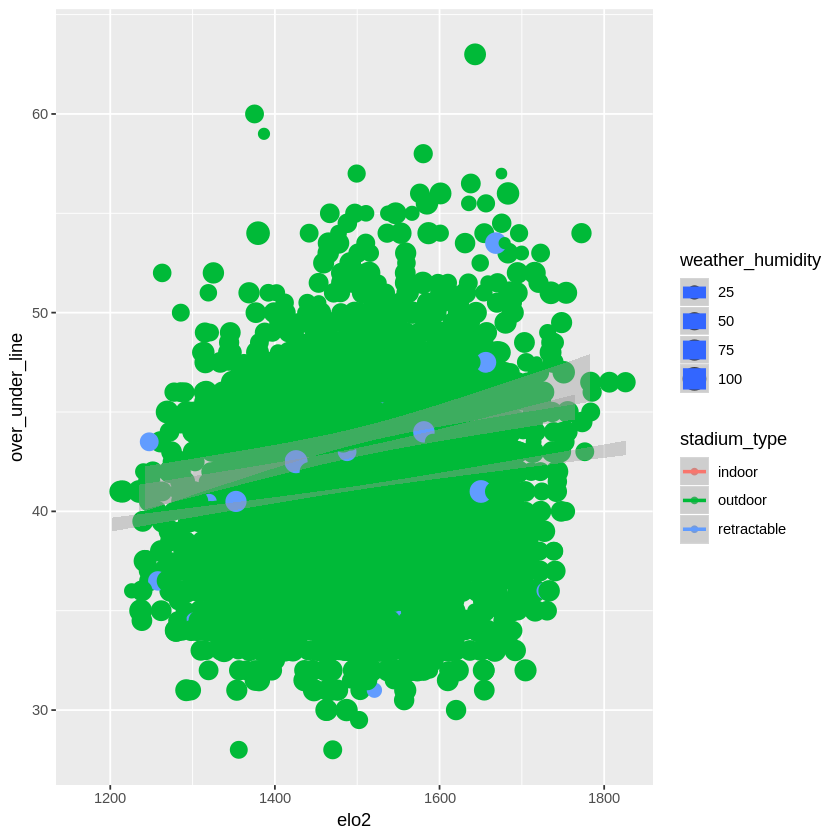

In [50]:
## Scatterplot of elo2, away_score, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## The same is true across stadium_types.  We see lower wind speeds present in games with higher elo2 and 
## higher over under lines

ggplot(stadium_type, aes(x=elo2,y=over_under_line, color = stadium_type, size = weather_temperature)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=over_under_line, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo2,y=over_under_line, color = stadium_type, size = weather_humidity)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”

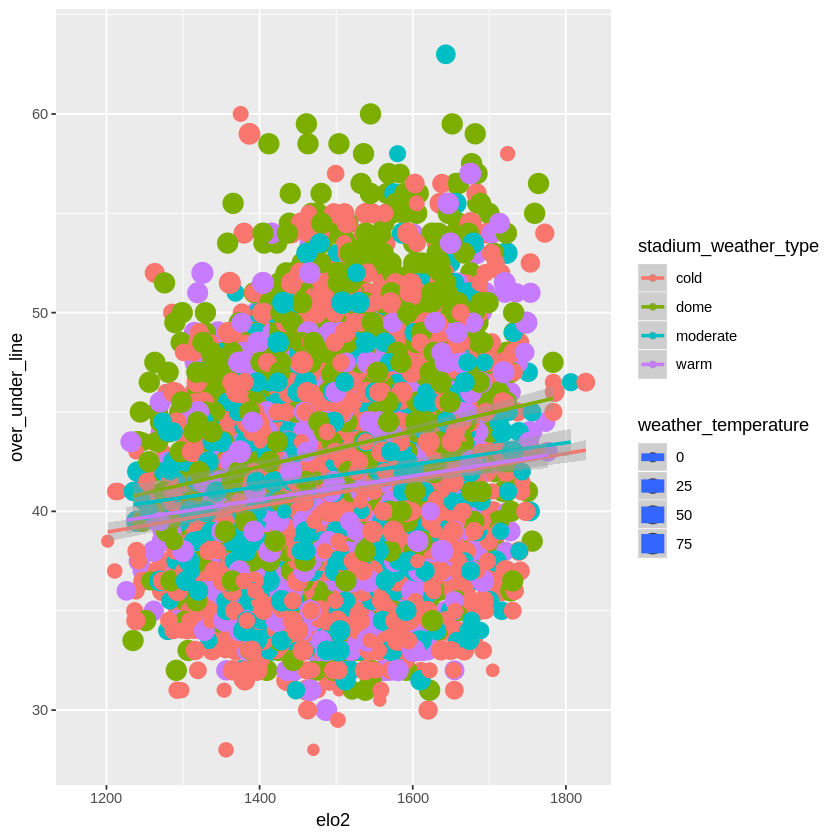

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5706 rows containing missing values (geom_point).”

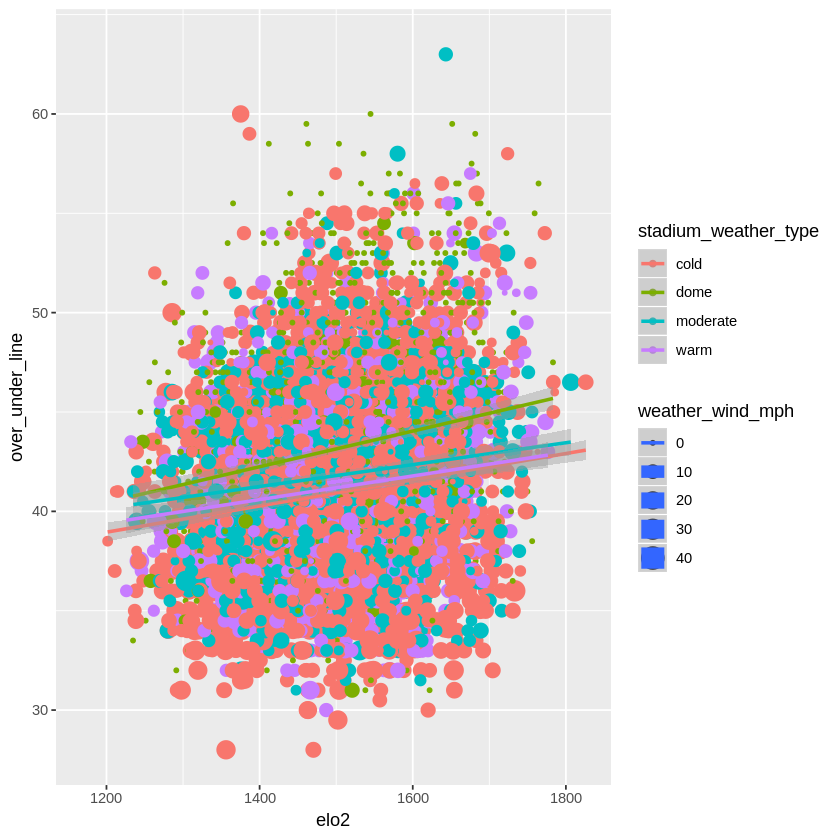

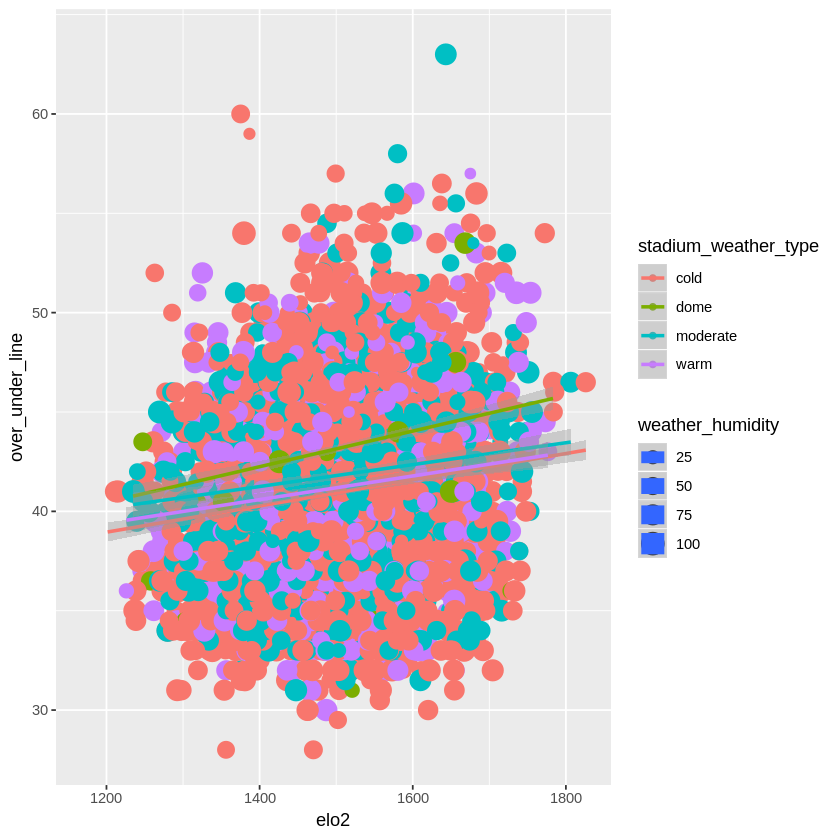

In [51]:
## Scatterplot of elo2, over_under_line, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, & 
## weather_humidity

## It's true across stadium_weather_types as well.  We see lower wind speeds present in games with higher elo2 and 
## higher over under lines

ggplot(stadium_weather_type, aes(x=elo2,y=over_under_line, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=over_under_line, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo2,y=over_under_line, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo2") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1189 rows containing missing values (geom_point).”Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 1189 rows containing missing values (geom_point).”

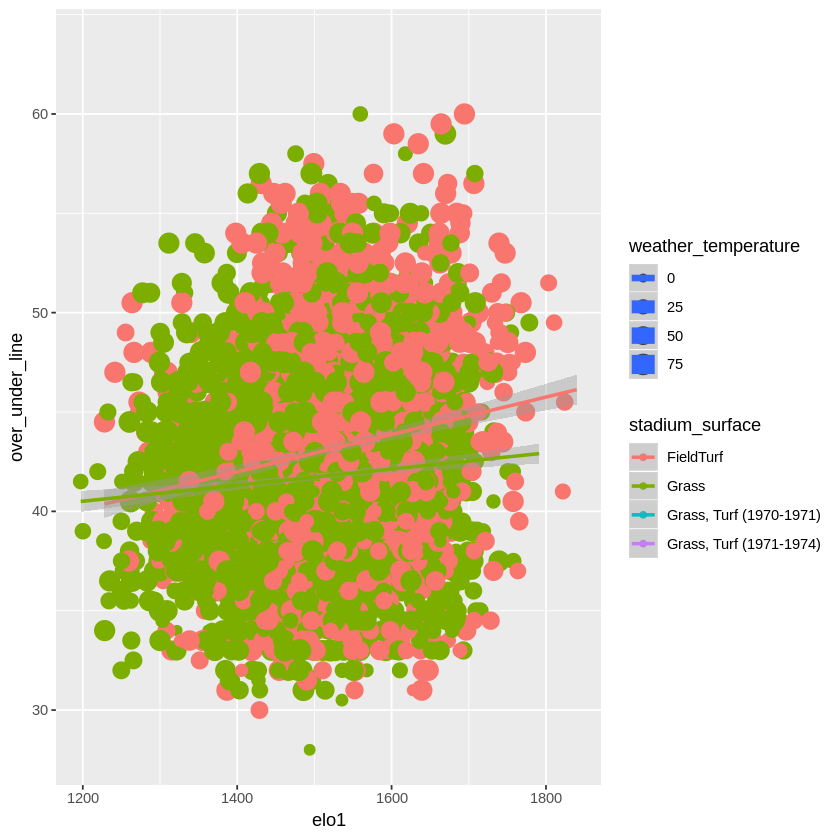

Warning message:
“Removed 1061 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2969 rows containing missing values (geom_point).”

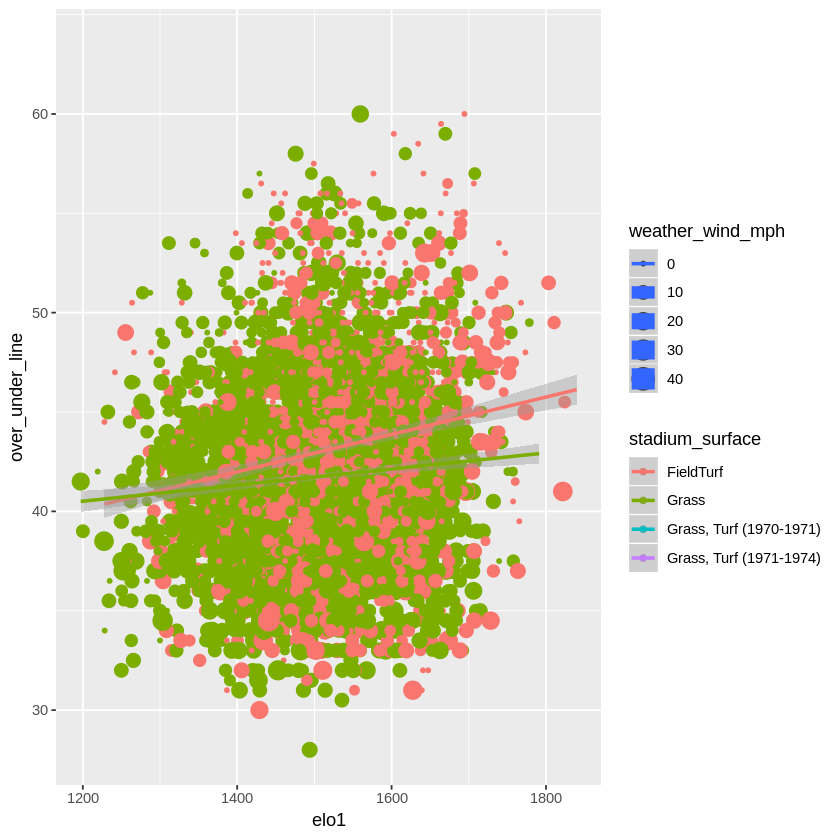

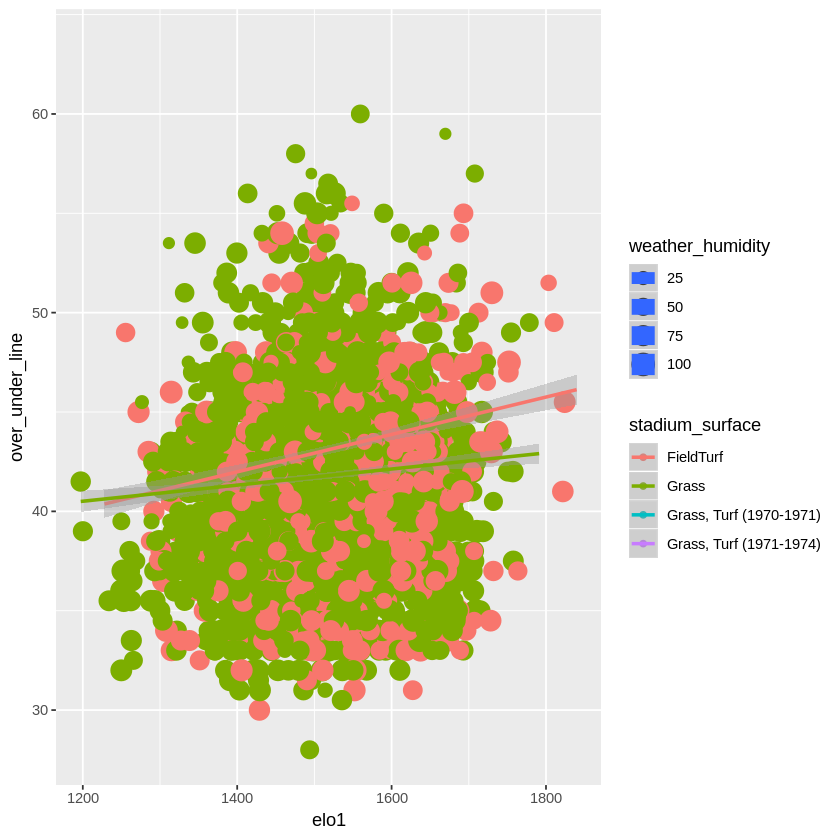

In [55]:
## Scatterplot of elo1, over_under_line, color = stadium_surface and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## Like elo2 in relation to over under lines, we see lower wind speeds present in games with higher elo1 and 
## higher over under lines

ggplot(stadium_surface, aes(x=elo1,y=over_under_line, color = stadium_surface, size = weather_temperature)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=over_under_line, color = stadium_surface, size = weather_wind_mph)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_surface, aes(x=elo1,y=over_under_line, color = stadium_surface, size = weather_humidity)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”

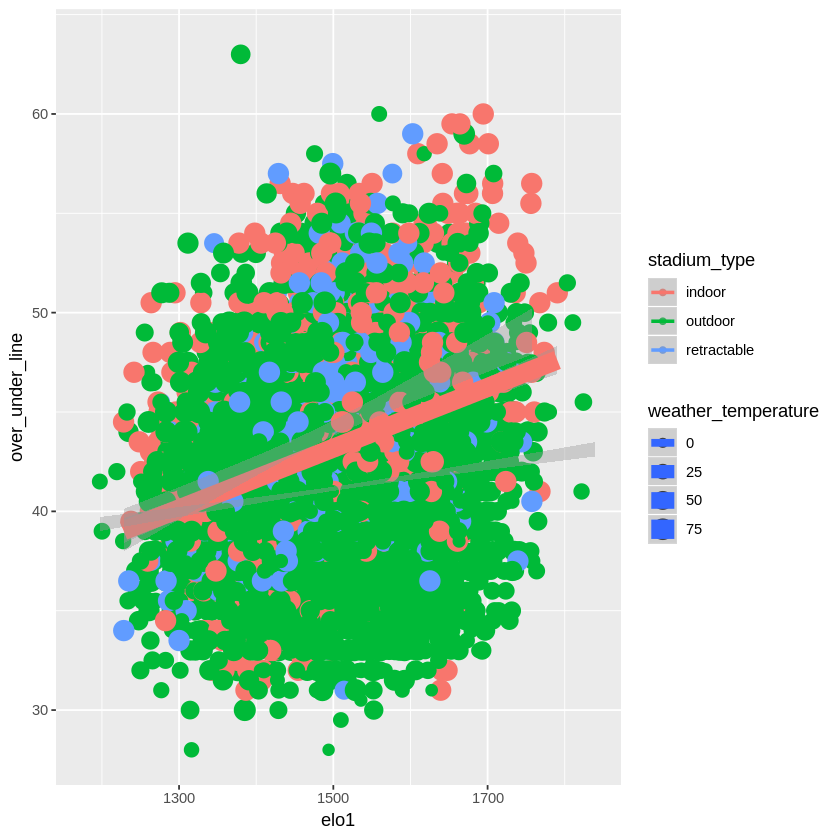

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5706 rows containing missing values (geom_point).”

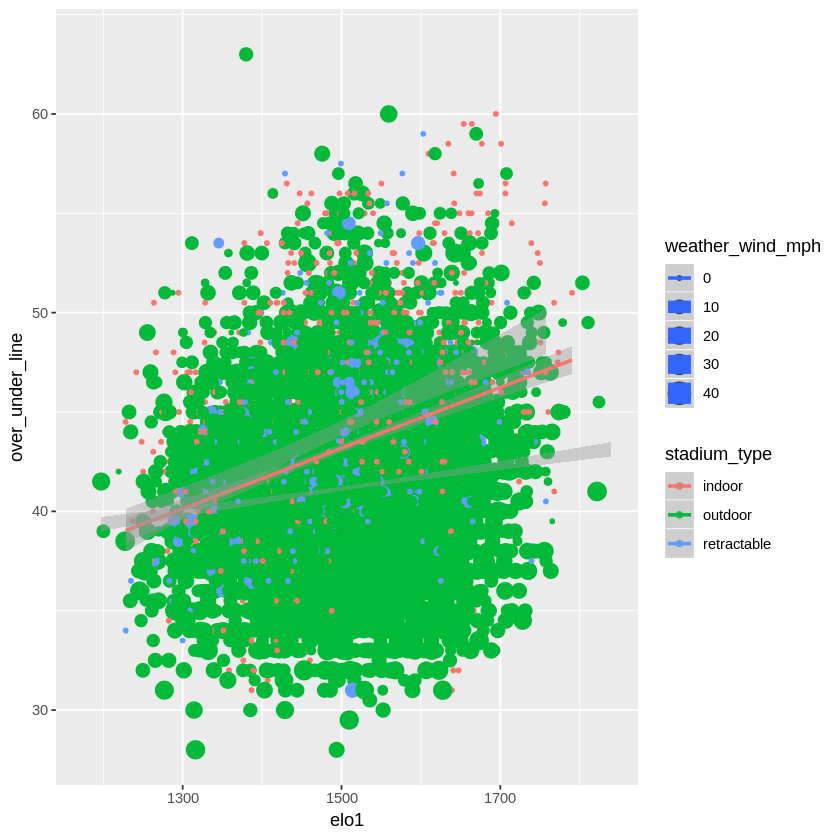

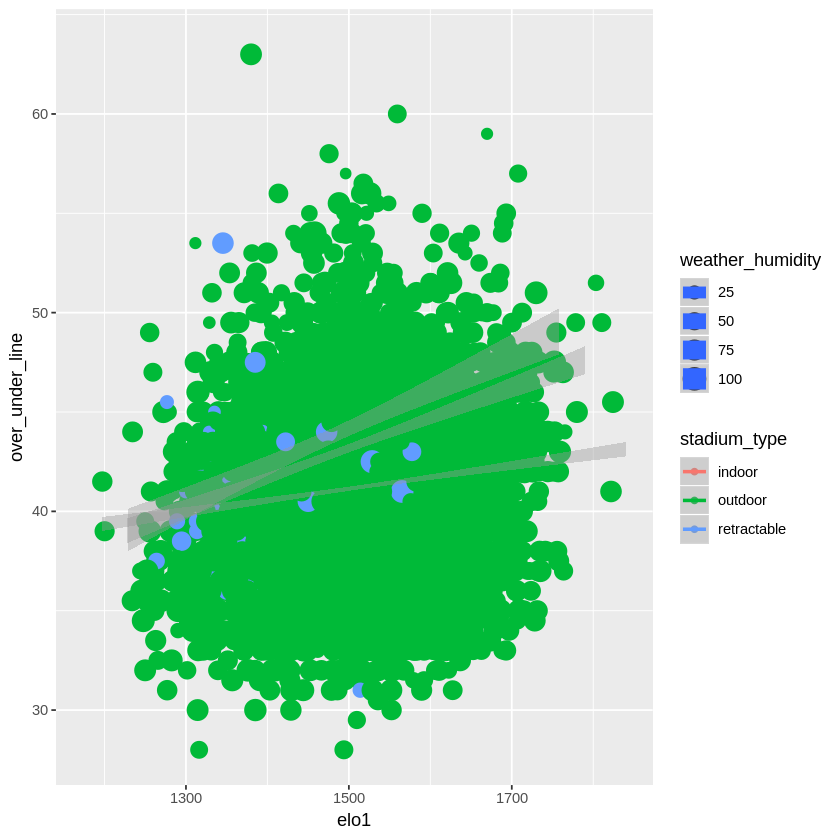

In [56]:
## Scatterplot of elo1, over_under_line, color = stadium_type and size = weather_temperature, weather_wind_mph, and 
## weather_humidity

## This is true across stadium_types as well.  Lower wind speeds are present in games with higher elo1 scores and 
## higher over under lines

ggplot(stadium_type, aes(x=elo1,y=over_under_line, color = stadium_type, size = weather_temperature)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=over_under_line, color = stadium_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_type, aes(x=elo1,y=over_under_line, color = stadium_type, size = weather_humidity)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 2790 rows containing missing values (geom_point).”

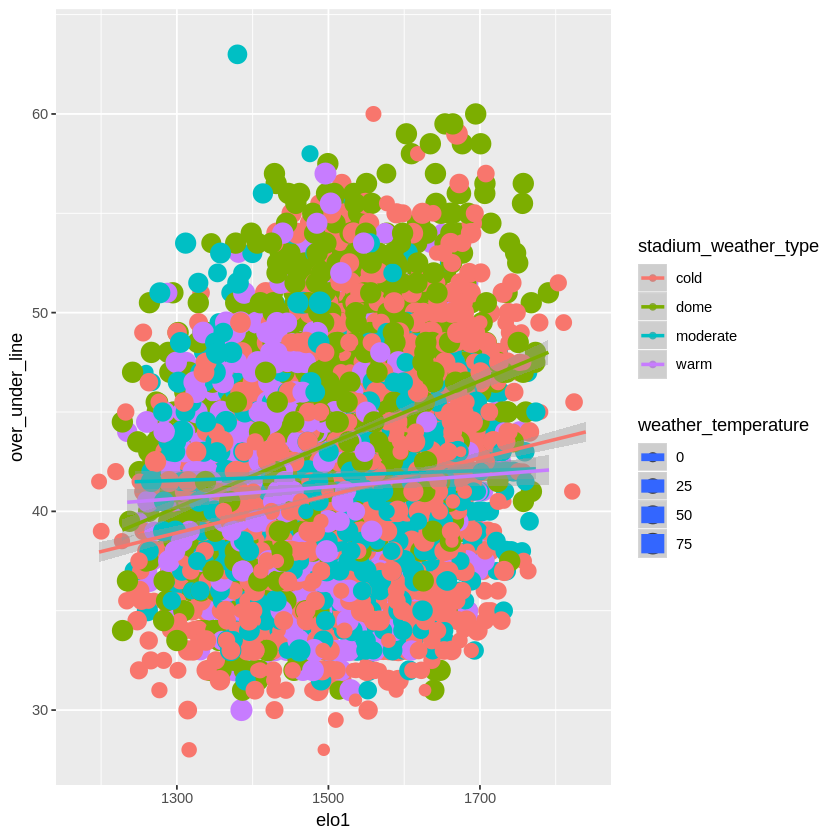

Warning message:
“Removed 2576 rows containing non-finite values (stat_smooth).”Warning message:
“Removed 5706 rows containing missing values (geom_point).”

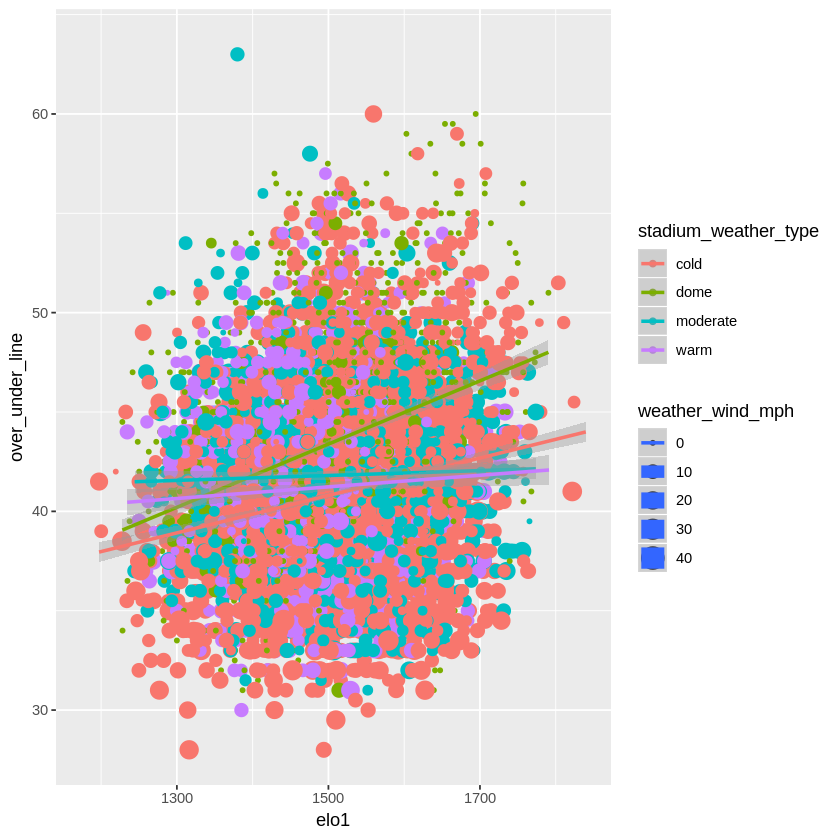

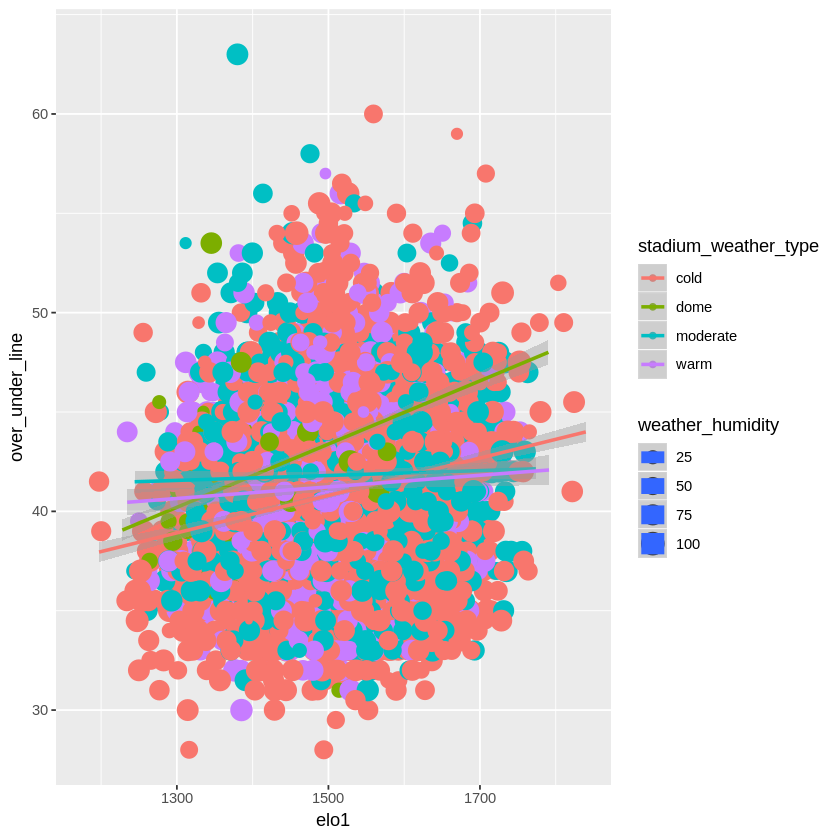

In [57]:
## Scatterplot of elo1, over_under_line, color = stadium_weather_type and size = weather_temperature, weather_wind_mph, & 
## weather_humidity

## And the same is true across stadium_weather_types. Lower wind speeds are present in games with higher elo1 scores and 
## higher over under lines

ggplot(stadium_weather_type, aes(x=elo1,y=over_under_line, color = stadium_weather_type, size = weather_temperature)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=over_under_line, color = stadium_weather_type, size = weather_wind_mph)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

ggplot(stadium_weather_type, aes(x=elo1,y=over_under_line, color = stadium_weather_type, size = weather_humidity)) +
    xlab("elo1") + ylab("over_under_line") + geom_point() + geom_smooth(method=lm)

### Super Bowl Era Visualizations (1970-present) <a name="super"></a>

In [58]:
## Create Super Bowl Era data frame which includes all seasons from 1970 to present day.

sb_era_df <- nfl_df %>%
    filter(as.numeric(schedule_season) > 1969)

colSums(is.na(sb_era_df))
str(sb_era_df)

schedule_date              schedule_season 
                           0                            0 
               schedule_week                      playoff 
                           0                         1089 
                   home_team                 home_team_id 
                           0                            0 
        home_team_conference           home_team_division 
                           0                            0 
                  home_score                   away_score 
                           0                            0 
                   away_team                 away_team_id 
                           0                            0 
        away_team_conference           away_team_division 
                           0                            0 
            team_favorite_id              spread_favorite 
                           0                         1755 
             over_under_line          weather_temperature 
                        1826                          303 
            weather_wind_mph             weather_humidity 
                         303                         3780 
              weather_detail                         elo1 
                           0                         1089 
                        elo2                    elo_prob1 
                        1089                         1089 
                     result1                      stadium 
                        1089                            0 
                     neutral             stadium_location 
                        1089                          195 
                stadium_open                stadium_close 
                         420                         6089 
                stadium_type stadium_weather_station_code 
                         195                          195 
        stadium_weather_type              stadium_surface 
                         195                          195 
                     STATION                         NAME 
                         195                          195 
                    LATITUDE                    LONGITUDE 
                        2763                         2763 
                   ELEVATION                 total_points 
                        2763                            0 
              team_winner_id 
                           0

'data.frame':	11683 obs. of  41 variables:
 $ schedule_date               : Date, format: "1970-09-18" "1970-09-19" ...
 $ schedule_season             : int  1970 1970 1970 1970 1970 1970 1970 1970 1970 1970 ...
 $ schedule_week               : chr  "1" "1" "1" "1" ...
 $ playoff                     : int  0 0 0 0 0 0 0 0 0 0 ...
 $ home_team                   : chr  "Los Angeles Rams" "New York Giants" "Boston Patriots" "Buffalo Bills" ...
 $ home_team_id                : chr  "LAR" "NYG" "NE" "BUF" ...
 $ home_team_conference        : chr  "NFC" "NFC" "AFC" "AFC" ...
 $ home_team_division          : chr  "NFC West" "NFC East" "" "AFC East" ...
 $ home_score                  : int  34 16 27 10 31 0 27 3 7 7 ...
 $ away_score                  : int  13 24 14 25 21 40 10 14 17 19 ...
 $ away_team                   : chr  "St. Louis Cardinals" "Chicago Bears" "Miami Dolphins" "Denver Broncos" ...
 $ away_team_id                : chr  "ARI" "CHI" "MIA" "DEN" ...
 $ away_team_conference   

In [59]:
## Group sb_era_df by stadium_type, stadium_weather_type, and stadium_surface.
## As we can see, most games are played outdoors in cold weather stadiums.
## Unfortunately, we don't know what kind of surface most games were played on.

stadium_types <- sb_era_df %>%
    group_by(stadium_type,stadium_weather_type,stadium_surface) %>%
    drop_na(stadium_type,stadium_weather_type,stadium_surface) %>%
    summarize(n = n())

head(stadium_types)

stadium_type,stadium_weather_type,stadium_surface,n
,,,9
indoor,dome,,1235
indoor,dome,FieldTurf,737
outdoor,cold,,2276
outdoor,cold,FieldTurf,820
outdoor,cold,Grass,1884


### Number of games played by stadium_weather_type and stadium_surface

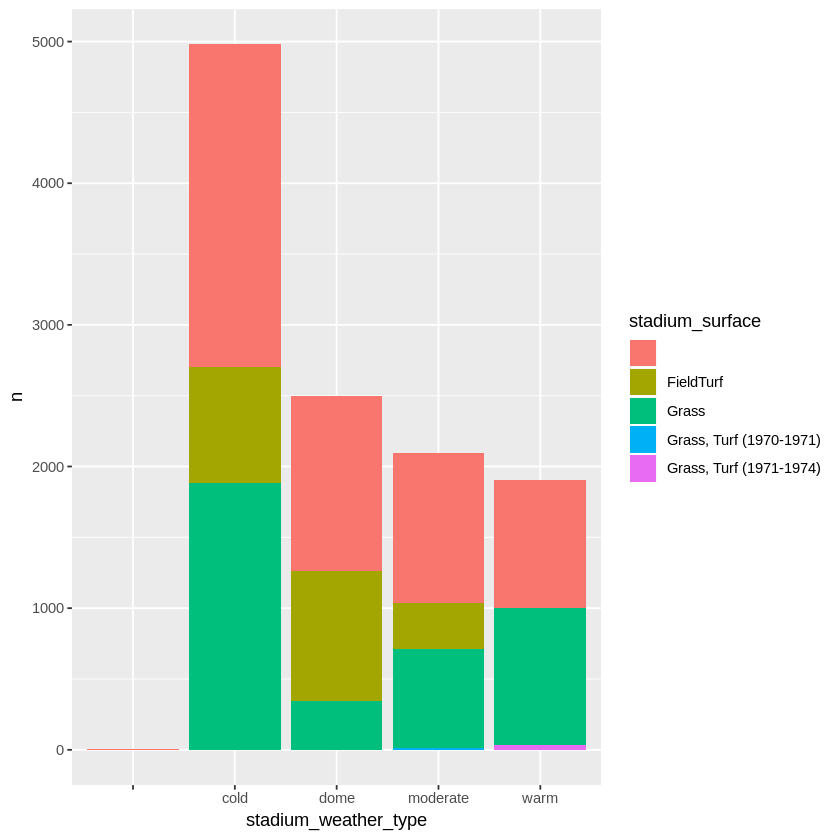

In [60]:
## In this visualization we see most games were played in cold weather stadiums on grass, however, the largest group of games
## were played on an unknown surface in cold weather stadiums.

plot_1 <- ggplot(stadium_types, aes(x=stadium_weather_type,y=n,fill=stadium_surface)) +
    geom_bar(stat="identity")

plot_1

### Number of games played by stadium_weather_type and stadium_type

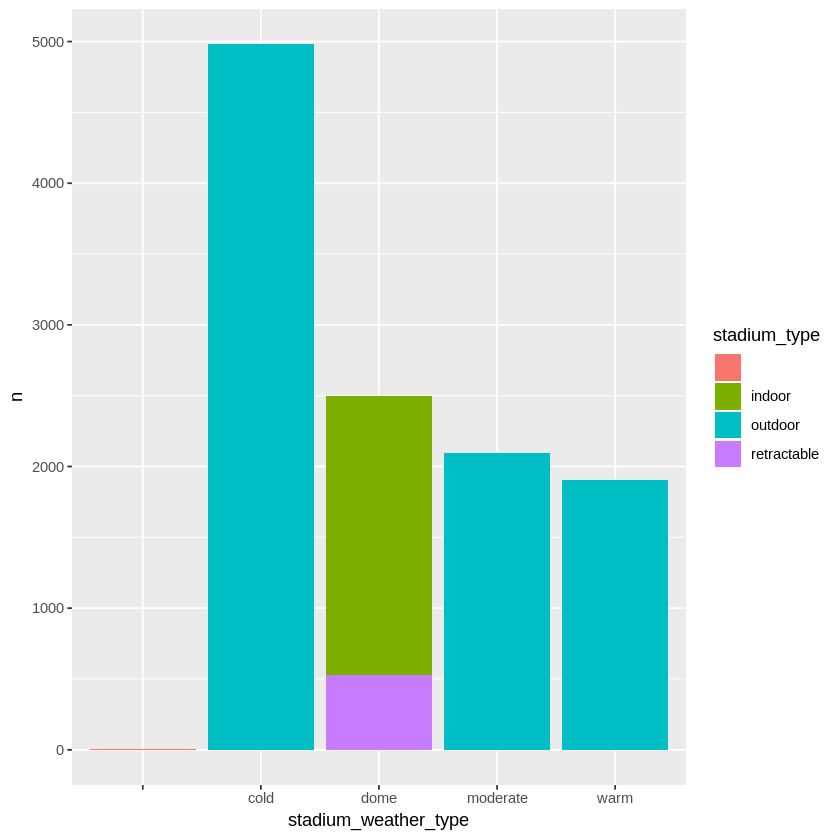

In [61]:
## In this visualization we clearly see the vast majority of games were played outdoors and most outdoor games were played
## in cold weather stadiums

plot_2 <- ggplot(stadium_types, aes(x=stadium_weather_type,y=n,fill=stadium_type)) +
    geom_bar(stat="identity")

plot_2

In [62]:
## Create data frame to group Super Bowl Era data by schedule_season, stadium_type, and stadium_surface

stadiums_over_time <- sb_era_df %>%
    group_by(schedule_season,stadium_type,stadium_surface) %>%
    drop_na(stadium_type) %>%
    summarize(n = n())

head(stadiums_over_time)

schedule_season,stadium_type,stadium_surface,n
1970,indoor,,7
1970,outdoor,,102
1970,outdoor,Grass,65
1970,outdoor,"Grass, Turf (1970-1971)",8
1970,outdoor,"Grass, Turf (1971-1974)",7
1971,indoor,,7


### Number of games played in a certain stadium_type by decade

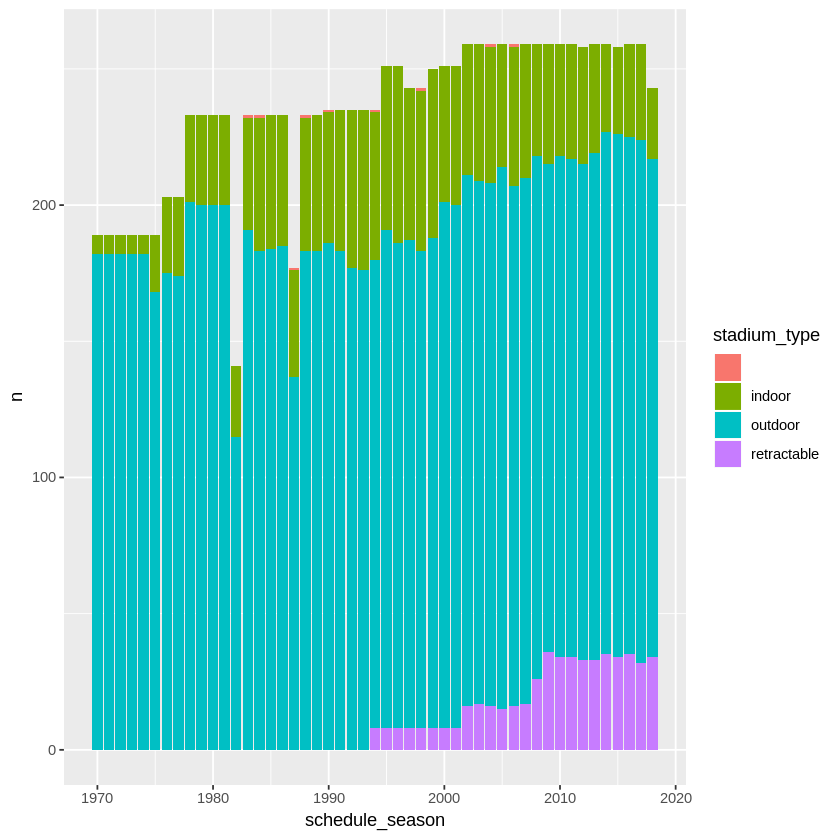

In [63]:
## In this visualization we see our games by decade.  Across all decades most games were played outdoors.  The number of 
## indoors games appear steady throughout the 2000s with most indoors games in the preceeding two decades.
## Retractable roof stadiums were introduced in the mid-90s and the number of games played in those stadiums has held steady
## since the late 2000s.

plot_3 <- ggplot(stadiums_over_time, aes(x=schedule_season,y=n,fill=stadium_type)) +
    geom_bar(stat="identity")

plot_3

### Number of games played in a certain stadium_surface by decade

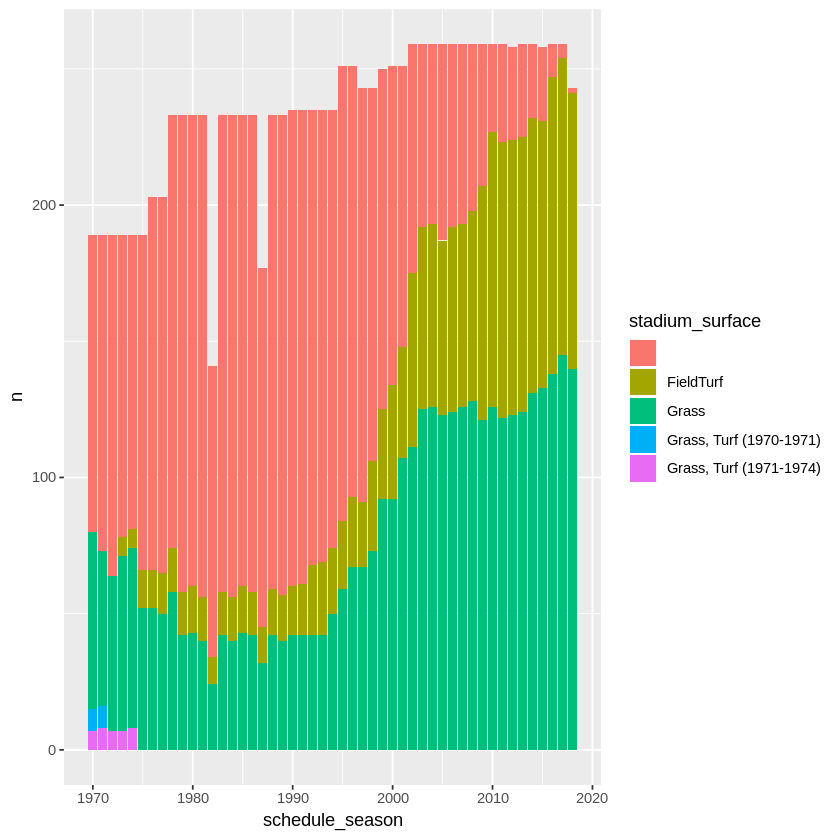

In [64]:
## In this visualization we see most games were played on unknown surfaces until the mid 90s.  From there most games were played
## on grass, although, the number of games played on field turf are steadily risen since the early 2000s.

plot_4 <- ggplot(stadiums_over_time, aes(x=schedule_season,y=n,fill=stadium_surface)) +
    geom_bar(stat="identity")

plot_4

### Modern Era NFL Visualizations (2002-present) <a name="modern"></a>

In [73]:
## Subset nfl_df for all games greater than the 2001 season

modern_era_df <- nfl_df %>%
    filter(as.numeric(schedule_season) > 2001)

colSums(is.na(modern_era_df))
str(modern_era_df)

schedule_date              schedule_season 
                           0                            0 
               schedule_week                      playoff 
                           0                          561 
                   home_team                 home_team_id 
                           0                            0 
        home_team_conference           home_team_division 
                           0                            0 
                  home_score                   away_score 
                           0                            0 
                   away_team                 away_team_id 
                           0                            0 
        away_team_conference           away_team_division 
                           0                            0 
            team_favorite_id              spread_favorite 
                           0                            0 
             over_under_line          weather_temperature 
                           0                          103 
            weather_wind_mph             weather_humidity 
                         103                         2308 
              weather_detail                         elo1 
                           0                          561 
                        elo2                    elo_prob1 
                         561                          561 
                     result1                      stadium 
                         561                            0 
                     neutral             stadium_location 
                         561                          154 
                stadium_open                stadium_close 
                         165                         3602 
                stadium_type stadium_weather_station_code 
                         154                          154 
        stadium_weather_type              stadium_surface 
                         154                          154 
                     STATION                         NAME 
                         154                          154 
                    LATITUDE                    LONGITUDE 
                         897                          897 
                   ELEVATION                 total_points 
                         897                            0 
              team_winner_id 
                           0

'data.frame':	4539 obs. of  41 variables:
 $ schedule_date               : Date, format: "2002-09-05" "2002-09-08" ...
 $ schedule_season             : int  2002 2002 2002 2002 2002 2002 2002 2002 2002 2002 ...
 $ schedule_week               : chr  "1" "1" "1" "1" ...
 $ playoff                     : int  0 0 0 0 0 0 0 0 0 0 ...
 $ home_team                   : chr  "New York Giants" "Buffalo Bills" "Carolina Panthers" "Chicago Bears" ...
 $ home_team_id                : chr  "NYG" "BUF" "CAR" "CHI" ...
 $ home_team_conference        : chr  "NFC" "AFC" "NFC" "NFC" ...
 $ home_team_division          : chr  "NFC East" "AFC East" "NFC South" "NFC North" ...
 $ home_score                  : int  13 31 10 27 6 39 23 37 19 25 ...
 $ away_score                  : int  16 37 7 23 34 40 16 34 10 28 ...
 $ away_team                   : chr  "San Francisco 49ers" "New York Jets" "Baltimore Ravens" "Minnesota Vikings" ...
 $ away_team_id                : chr  "SF" "NYJ" "BAL" "MIN" ...
 $ away_tea

In [74]:
## Remove null values from the spread_favorite, over_under_line, elo1, and elo2 columns.

modern_era_df <- modern_era_df %>% drop_na(spread_favorite, over_under_line, elo1, elo2)

colSums(is.na(modern_era_df))
str(modern_era_df)

schedule_date              schedule_season 
                           0                            0 
               schedule_week                      playoff 
                           0                            0 
                   home_team                 home_team_id 
                           0                            0 
        home_team_conference           home_team_division 
                           0                            0 
                  home_score                   away_score 
                           0                            0 
                   away_team                 away_team_id 
                           0                            0 
        away_team_conference           away_team_division 
                           0                            0 
            team_favorite_id              spread_favorite 
                           0                            0 
             over_under_line          weather_temperature 
                           0                           95 
            weather_wind_mph             weather_humidity 
                          95                         1921 
              weather_detail                         elo1 
                           0                            0 
                        elo2                    elo_prob1 
                           0                            0 
                     result1                      stadium 
                           0                            0 
                     neutral             stadium_location 
                           0                            0 
                stadium_open                stadium_close 
                           7                         3113 
                stadium_type stadium_weather_station_code 
                           0                            0 
        stadium_weather_type              stadium_surface 
                           0                            0 
                     STATION                         NAME 
                           0                            0 
                    LATITUDE                    LONGITUDE 
                         675                          675 
                   ELEVATION                 total_points 
                         675                            0 
              team_winner_id 
                           0

'data.frame':	3978 obs. of  41 variables:
 $ schedule_date               : Date, format: "2002-09-05" "2002-09-08" ...
 $ schedule_season             : int  2002 2002 2002 2002 2002 2002 2002 2002 2002 2002 ...
 $ schedule_week               : chr  "1" "1" "1" "1" ...
 $ playoff                     : int  0 0 0 0 0 0 0 0 0 0 ...
 $ home_team                   : chr  "New York Giants" "Buffalo Bills" "Carolina Panthers" "Chicago Bears" ...
 $ home_team_id                : chr  "NYG" "BUF" "CAR" "CHI" ...
 $ home_team_conference        : chr  "NFC" "AFC" "NFC" "NFC" ...
 $ home_team_division          : chr  "NFC East" "AFC East" "NFC South" "NFC North" ...
 $ home_score                  : int  13 31 10 27 6 39 23 37 19 25 ...
 $ away_score                  : int  16 37 7 23 34 40 16 34 10 28 ...
 $ away_team                   : chr  "San Francisco 49ers" "New York Jets" "Baltimore Ravens" "Minnesota Vikings" ...
 $ away_team_id                : chr  "SF" "NYJ" "BAL" "MIN" ...
 $ away_tea

In [75]:
## Group modern_era_df by stadium_type, stadium_weather_type, and stadium_surface

stadium_types <- modern_era_df %>%
    group_by(stadium_type,stadium_weather_type,stadium_surface) %>%
    drop_na(stadium_type,stadium_weather_type,stadium_surface) %>%
    summarize(n = n())

head(stadium_types)

stadium_type,stadium_weather_type,stadium_surface,n
,,,2
indoor,dome,,258
indoor,dome,FieldTurf,392
outdoor,cold,,156
outdoor,cold,FieldTurf,516
outdoor,cold,Grass,894


### Number of games played by stadium_weather_type and stadium_surface

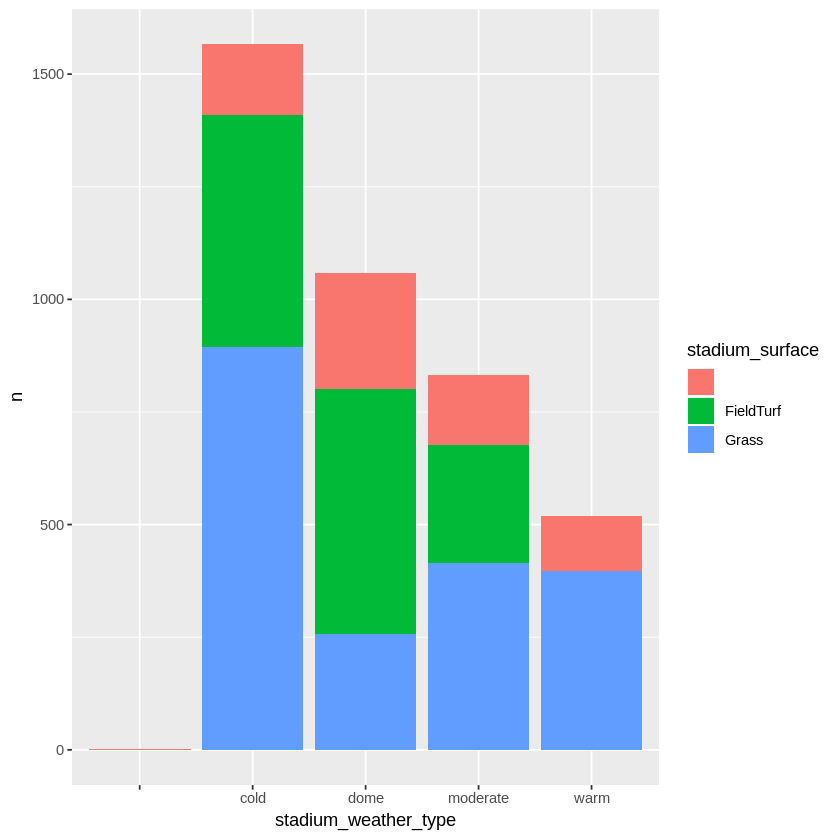

In [76]:
## As we can see most games were played on grass in a cold weather stadium

plot_1a <- ggplot(stadium_types, aes(x=stadium_weather_type,y=n,fill=stadium_surface)) +
    geom_bar(stat="identity")

plot_1a

### Number of games played by stadium_weather_type and stadium_type

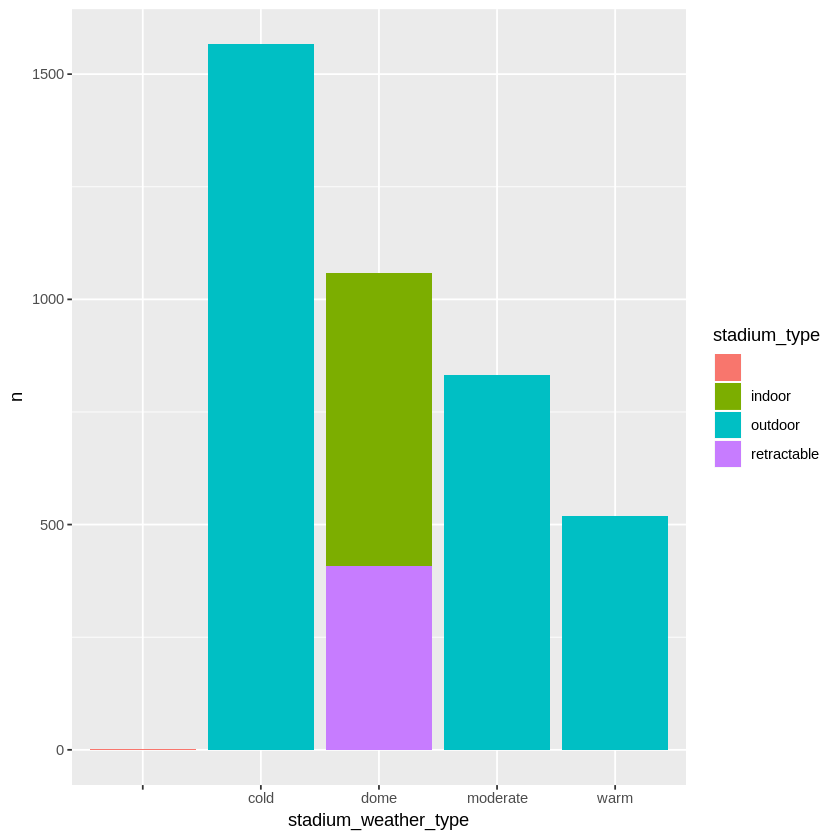

In [77]:
## As we can see most games were clearly played outdoors in cold weather stadiums

plot_2a <- ggplot(stadium_types, aes(x=stadium_weather_type,y=n,fill=stadium_type)) +
    geom_bar(stat="identity")

plot_2a

In [78]:
## Group modern_era_df by schedule_season, stadium_type, and stadium_surface

stadiums_over_time <- modern_era_df %>%
    group_by(schedule_season,stadium_type,stadium_surface) %>%
    drop_na(stadium_type) %>%
    summarize(n = n())

head(stadiums_over_time)

schedule_season,stadium_type,stadium_surface,n
2002,indoor,,24
2002,indoor,FieldTurf,24
2002,outdoor,,56
2002,outdoor,FieldTurf,39
2002,outdoor,Grass,91
2002,retractable,Grass,16


### Number of games played in a certain stadium_type by decade

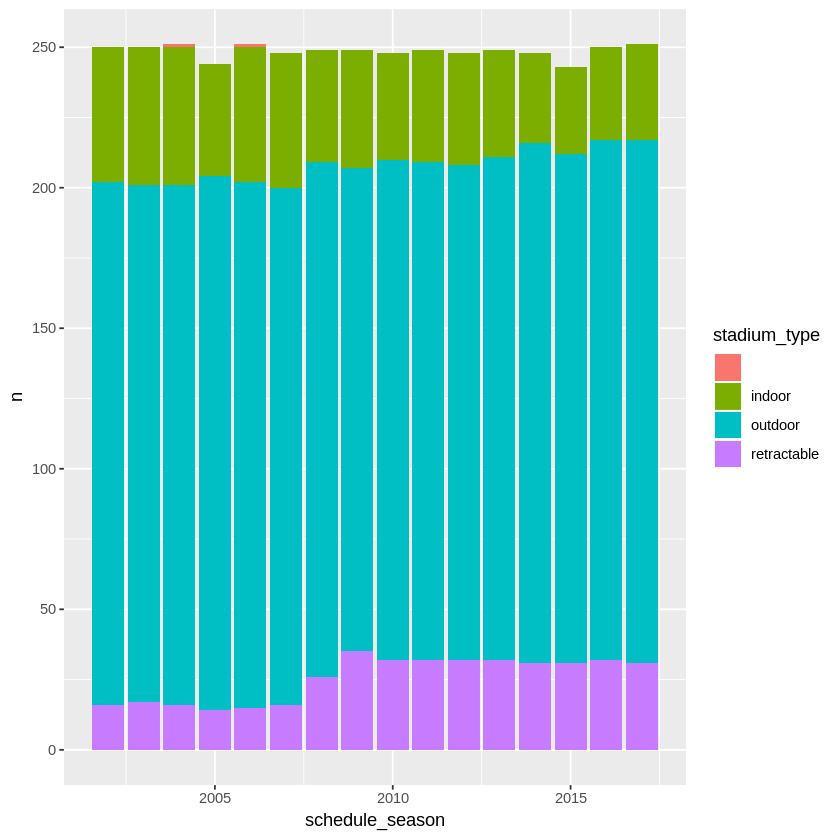

In [79]:
## As we can see most games were played in an outdoor stadium with games playd in indoor and retractable stadiums holding
## relatively steady across the modern era.

plot_3a <- ggplot(stadiums_over_time, aes(x=schedule_season,y=n,fill=stadium_type)) +
    geom_bar(stat="identity")

plot_3a

### Number of games played by stadium_surface by decade

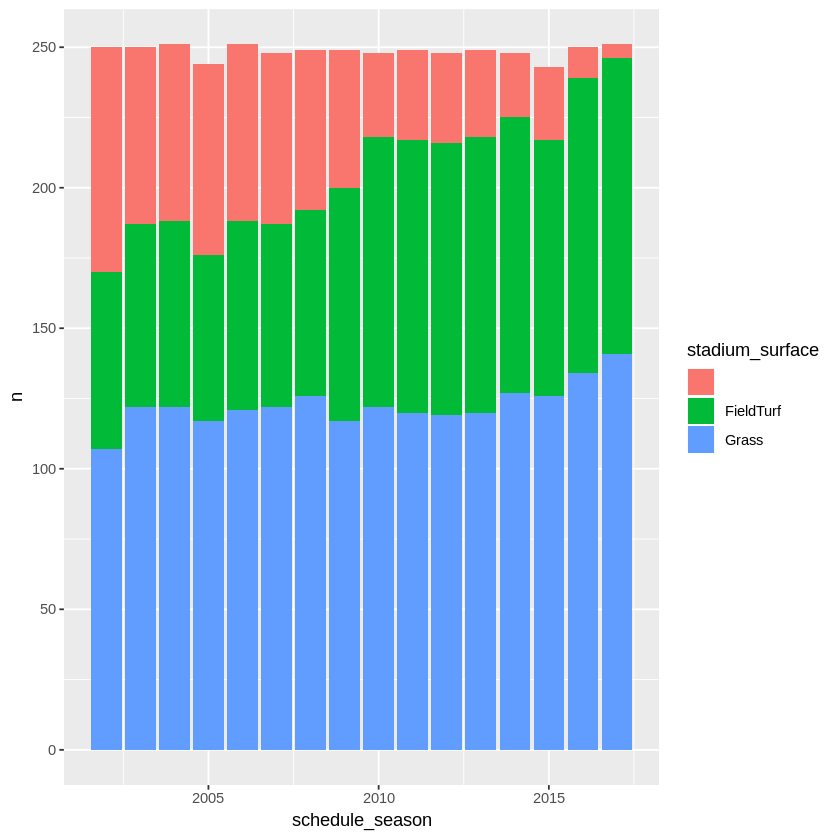

In [80]:
## As we can see most games were played on grass, however, the number of games played on field turf has increased in 
## recent years.

plot_4a <- ggplot(stadiums_over_time, aes(x=schedule_season,y=n,fill=stadium_surface)) +
    geom_bar(stat="identity")

plot_4a

## Initial Conclusions after Multivariate Analysis <a name="conclusions"></a>

1. After the first three milestones, we're solidifying on our question of predicting the outcome of an NFL game.  Possibly, we'd like to take our predictions and see if we can't beat the over/under line or the spead.  Another possibility would be to use our data to enhance FiveThrityEight's ELO model or create one of our own to beat FiveThrityEight's NFL predictions.
2. Now that we've incorporated the FiveThrityEight ELO data and the stadiums data into our betting and weather data we see some higher correlations among our variables like home score/total points, elo1/elo_prob1, and total points/away score.  This makes sense.  The more points scored the higher the home, away, or both scores.  Additionally, if the probability the home team will win (elo_prob1) is high then it's likely they also have a high elo1 score which is the home team's ELO score.
3. Key Takeaway 1: Should we covert our categorical data to dummy variables when modeling?
4. Key Takeaway 2: We've dropped the null values in this notebook as well so we still need to decide what we'd like to do with them.